# Intro

### Imports

In [6]:
import helper_classes.data_retriever as dr
import geopandas as gpd
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import helper_classes.geoprocessor as geo

### Configurations

In [7]:
FT_TO_METER = 3.28084

# ESPG to import
EPSG_FROM = "epsg:4326"
# ESPG to convert to
EPSG_TO = 'epsg:32618'

In [8]:
# Reset the maximum number of rows and columns to their default values
pd.reset_option('display.max_rows')
pd.reset_option('display.max_columns')

# NOTE: Retrieved data are all in the context of 2019 for pre-COVID19 Pandemic Purposes
# EPSG:4269

# set up dictionary csv file for internal data validation purposes
dr.generate_column_names()

# Data Retrieval
nyc_gdf = dr.retrieve_census_tiger_shapefile_dataframe()
sebg_df = dr.retrieve_socialexplorer_blockgroup_data()
networkx_df = dr.retrieve_networkx_result("networkx_analysis_weighed.csv")

# Shapefile and Social Explorer Census Data Join into a Geodataframe
nyc_df = pd.merge(sebg_df, nyc_gdf, left_on='Geo_FIPS', right_on='GEOID')
## NOTE: to_crs() needs to be explicitly called to convert
## Even though I explicitly set the CRS to epsg:32618 (which uses meters as units)
## when creating the GeoDataFrame, this only sets the metadata of the GeoDataFrame
## and does not actually transform the coordinates. To transform the coordinates to
## the new CRS, I need to call the .to_crs() method on the GeoDataFrame after creating
## it with gpd.points_from_xy() (in reset_networkx_gdf())
nyc_gdf = gpd.GeoDataFrame(nyc_df, geometry='geometry', crs=EPSG_FROM).to_crs(EPSG_TO)
nyc_gdf = nyc_gdf

## Data Cleanup
# Remove parks and/or water via a filter
nyc_gdf = nyc_gdf[(nyc_gdf['ALAND'] > 0) & (nyc_gdf['ACS19_5yr_B01001001'] / nyc_gdf['ALAND'].apply(lambda x: np.sqrt(x)) > 0.023)]


c:\Users\cjong\Projects\python\analysis_of_nyc_subway_commute_patterns\geopanda_analysis\helper_classes\data_retriever.py:73: DtypeWarning: Columns (0,4,5,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,

In [9]:
nyc_gdf.crs


<Derived Projected CRS: EPSG:32618>
Name: WGS 84 / UTM zone 18N
Axis Info [cartesian]:
- E[east]: Easting (metre)
- N[north]: Northing (metre)
Area of Use:
- name: Between 78°W and 72°W, northern hemisphere between equator and 84°N, onshore and offshore. Bahamas. Canada - Nunavut; Ontario; Quebec. Colombia. Cuba. Ecuador. Greenland. Haiti. Jamaica. Panama. Turks and Caicos Islands. United States (USA). Venezuela.
- bounds: (-78.0, 0.0, -72.0, 84.0)
Coordinate Operation:
- name: UTM zone 18N
- method: Transverse Mercator
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [10]:
## All of the columns in nyc_gdf
# for col in nyc_gdf.columns:
#     print(col)

# Draw circles

In [11]:
networkx_gdf = geo.reset_networkx_gdf(networkx_df, EPSG_FROM, EPSG_TO)

In [12]:
networkx_gdf.crs

<Derived Projected CRS: EPSG:32618>
Name: WGS 84 / UTM zone 18N
Axis Info [cartesian]:
- E[east]: Easting (metre)
- N[north]: Northing (metre)
Area of Use:
- name: Between 78°W and 72°W, northern hemisphere between equator and 84°N, onshore and offshore. Bahamas. Canada - Nunavut; Ontario; Quebec. Colombia. Cuba. Ecuador. Greenland. Haiti. Jamaica. Panama. Turks and Caicos Islands. United States (USA). Venezuela.
- bounds: (-78.0, 0.0, -72.0, 84.0)
Coordinate Operation:
- name: UTM zone 18N
- method: Transverse Mercator
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

### Test run to verify 1000 meter radius

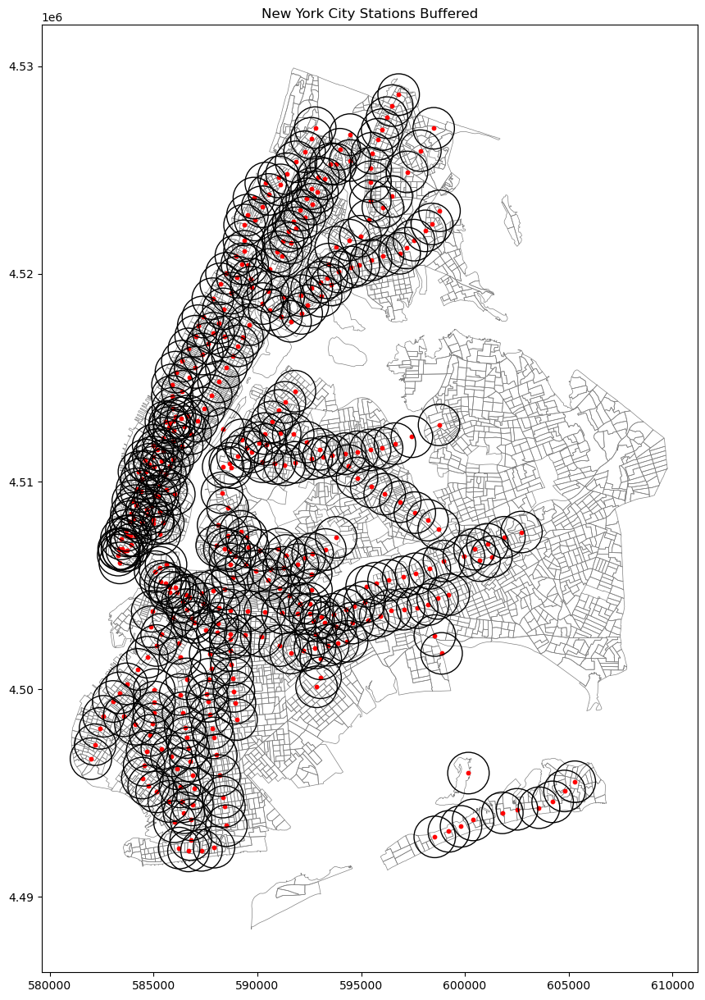

In [16]:
from matplotlib.patches import Circle

# Create a choropleth map of New York City counties based on the degree centrality
fig, ax = plt.subplots(figsize=(15, 15))

# Add block group boundaries
nyc_gdf.plot(linewidth=0.5, edgecolor='grey', facecolor='none', ax=ax)
networkx_gdf_buffered = geo.reset_networkx_gdf(networkx_df, EPSG_FROM, EPSG_TO)

# Plot the buffered points as circles on the map
networkx_gdf_buffered.plot(ax=ax, color='red', edgecolor='red', markersize=10)

for point in networkx_gdf_buffered.itertuples():
    # Radius only displays in meters due to EPSG from init is converted to
    # EPSG_TO explicilty for nyc_dfg and networkx_gdf
    ax.add_patch(Circle(xy=point.geometry.centroid.coords[0], radius=1000, edgecolor='black', facecolor='none'))

ax.set_title('New York City Stations Buffered')
plt.show()

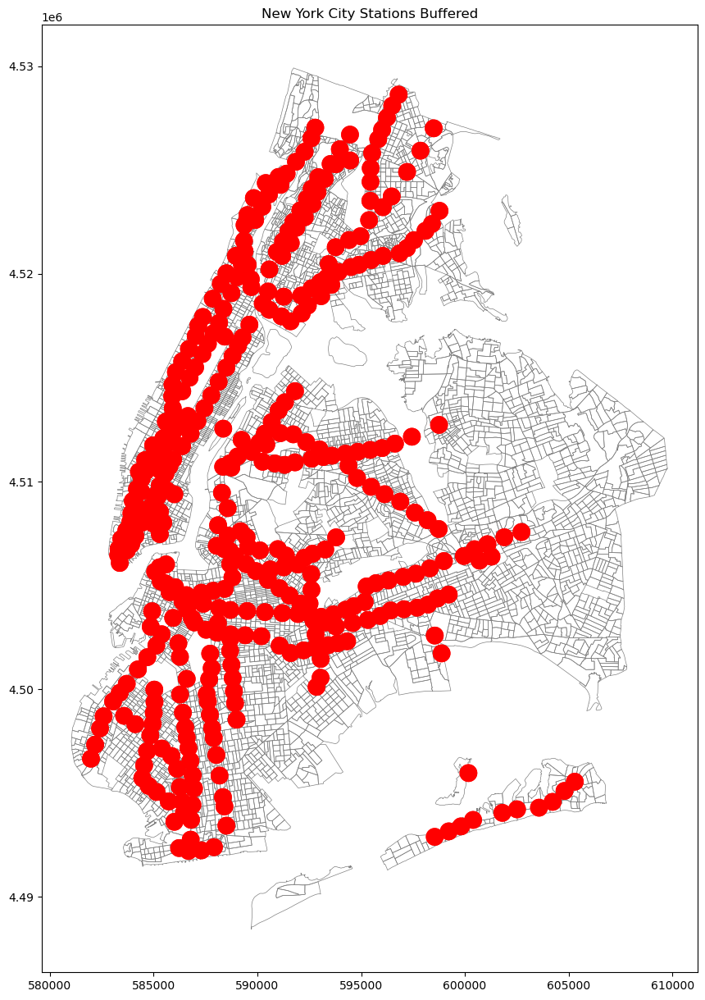

In [18]:
from matplotlib.patches import Circle

# Create a choropleth map of New York City counties based on the degree centrality
fig, ax = plt.subplots(figsize=(15, 15))

# Add block group boundaries
nyc_gdf.plot(linewidth=0.5, edgecolor='grey', facecolor='none', ax=ax)


# Plot the buffered points as circles on the map
networkx_gdf_buffered.plot(ax=ax, color='red', edgecolor='red', markersize=10)

networkx_gdf_buffered = geo.reset_networkx_gdf(networkx_df, EPSG_FROM, EPSG_TO).buffer(400) # buffer in meters

# Plot the buffered points as circles on the map
networkx_gdf_buffered.plot(ax=ax, color='none', edgecolor='red', markersize=10)

ax.set_title('New York City Stations Buffered')
plt.show()

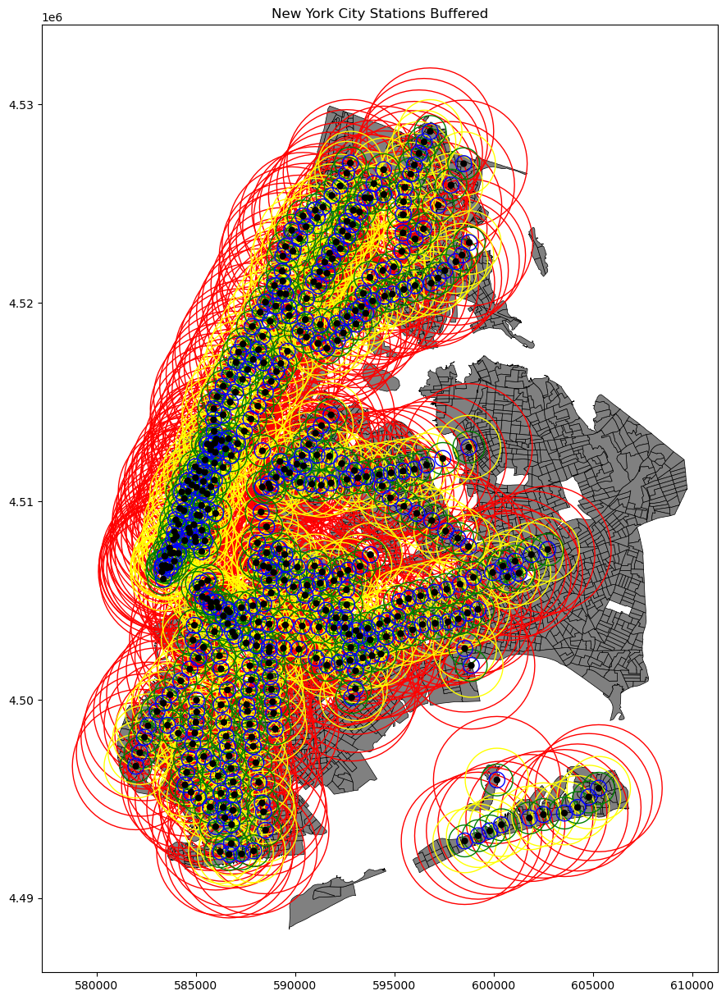

In [26]:
from matplotlib.patches import Circle

# Create a choropleth map of New York City counties based on the degree centrality
fig, ax = plt.subplots(figsize=(15, 15))

# Add block group boundaries
nyc_gdf.plot(linewidth=0.5, edgecolor='black', facecolor='grey', ax=ax)

geo.reset_networkx_gdf(networkx_df, EPSG_FROM, EPSG_TO).buffer(3200) \
    .plot(ax=ax, color='none', edgecolor='red')
geo.reset_networkx_gdf(networkx_df, EPSG_FROM, EPSG_TO).buffer(1600) \
    .plot(ax=ax, color='none', edgecolor='yellow')
geo.reset_networkx_gdf(networkx_df, EPSG_FROM, EPSG_TO).buffer(800) \
    .plot(ax=ax, color='none', edgecolor='green')
geo.reset_networkx_gdf(networkx_df, EPSG_FROM, EPSG_TO).buffer(400) \
    .plot(ax=ax, color='none', edgecolor='blue')
geo.reset_networkx_gdf(networkx_df, EPSG_FROM, EPSG_TO) \
    .plot(ax=ax, color='black', edgecolor='none')

ax.set_title('New York City Stations Buffered')
plt.show()

# Conduct Weighted Population NetworkX


In [ ]:
# networkx_df = geo.aggregate_nyc_census_variable_to_networkx_weight('ACS19_5yr_B01001001', 'Geo_AREALAND',
#                                                                    networkx_df=networkx_df,
#                                                                    nyc_gdf=nyc_gdf,
#                                                                    meters=1000)

# networkx_df.to_csv('station_populations.csv', index=False)

c:\Users\cjong\anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3457: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  exec(code_obj, self.user_global_ns, self.user_ns)
c:\Users\cjong\Projects\python\analysis_of_nyc_subway_commute_patterns\geopanda_analysis\helper_classes\geoprocessor.py:51: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:4269

  joined_df = gpd.sjoin(networkx_gdf, nyc_gdf, how='left', op='intersects')\


## Radius calculations and pickling

In [2]:
geoid_df = nyc_gdf[['GEOID','geometry']].copy()
geoid_df

,GEOID,geometry
1,360050001001,"POLYGON ((-73.89266 40.79382, -73.89194 40.796..."
3,360050002001,"POLYGON ((-73.86333 40.81478, -73.86240 40.814..."
4,360050002002,"POLYGON ((-73.86522 40.81453, -73.86425 40.814..."
5,360050002003,"POLYGON ((-73.85867 40.80683, -73.85832 40.806..."
7,360050004001,"POLYGON ((-73.85960 40.81528, -73.85870 40.815..."
...,...,...
6149,360811621001,"POLYGON ((-73.73632 40.73104, -73.73619 40.731..."
6150,360811621002,"POLYGON ((-73.73714 40.72897, -73.73659 40.730..."
6151,360811621003,"POLYGON ((-73.73161 40.72789, -73.73160 40.727..."
6152,360811621004,"POLYGON ((-73.72760 40.72814, -73.72689 40.729..."


In [3]:

# Create 500, 1000, 2000, and 5000 km radiuses

# nyc_gdf = geo.aggregate_join_nyc_to_buffered_networkx_stations('_radius_100', nyc_gdf, networkx_df, 100)
# nyc_gdf = geo.aggregate_join_nyc_to_buffered_networkx_stations('_radius_250', nyc_gdf, networkx_df, 250)
geoid_df = geo.aggregate_join_nyc_to_buffered_networkx_stations('_radius_400', geoid_df, networkx_df, 500)
# nyc_gdf = geo.aggregate_join_nyc_to_buffered_networkx_stations('_radius_500', nyc_gdf, networkx_df, 500)
geoid_df = geo.aggregate_join_nyc_to_buffered_networkx_stations('_radius_800', geoid_df, networkx_df, 500)
geoid_df = geo.aggregate_join_nyc_to_buffered_networkx_stations('_radius_1000', geoid_df, networkx_df, 1000)
geoid_df = geo.aggregate_join_nyc_to_buffered_networkx_stations('_radius_2000', geoid_df, networkx_df, 2000)
geoid_df = geo.aggregate_join_nyc_to_buffered_networkx_stations('_radius_5000', geoid_df, networkx_df, 5000)
geoid_df = geo.aggregate_join_nyc_to_buffered_networkx_stations('_radius_7000', geoid_df, networkx_df, 7000)
geoid_df = geo.aggregate_join_nyc_to_buffered_networkx_stations('_radius_10000', geoid_df, networkx_df, 10000)

c:\Users\cjong\anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3457: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  exec(code_obj, self.user_global_ns, self.user_ns)
c:\Users\cjong\Projects\python\analysis_of_nyc_subway_commute_patterns\geopanda_analysis\helper_classes\geoprocessor.py:15: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:4269
Right CRS: None

  joined_mean_df = gpd.sjoin(nyc_gdf, networkx_gdf, how='left', op='intersects')\
c:\Users\cjong\anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3457: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  exec(code_obj, self.user_global_ns, self.user_ns)
c:\Users\cjong\Projects\python\analys

In [5]:
radius_results_df = geoid_df.loc[:, 'btwn_mean_radius_400':]
# radius_results_df = nyc_gdf.loc[:, 'btwn_mean_radius_500':]
radius_results_df['GEOID'] = geoid_df['GEOID']
radius_results_df.to_pickle('./radius_results_df.pkl', compression='gzip')

# Load Radius Data Pickle

In [6]:
# Loading saved pickle
radius_results_df = pd.read_pickle('./radius_results_df.pkl', compression='gzip')
nyc_gdf = pd.merge(nyc_gdf, radius_results_df, on='GEOID')

# Data Pickling

In [7]:
nyc_gdf.to_pickle('./nyc_gdf.pkl', compression='gzip')
nyc_gdf_cached = nyc_gdf.copy()

# Load All Data Pickle

In [2]:
nyc_gdf = pd.read_pickle('./nyc_gdf.pkl', compression='gzip')


# Choropleth Map Functions

In [10]:

def plot_choropleth_maps(nyc_gdf, mean, radius):
    
    # Create a figure with 4 subplots in a 2x2 grid
    fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(30, 10))
    
    # Plot each choropleth map on its corresponding subplot
    axes[0].set_title('Betweenness', fontsize=14)
    nyc_gdf.plot(column=f'btwn_{mean}_radius_{radius}', cmap='YlOrRd', legend=True, ax=axes[0])
    
    axes[1].set_title('Closeness', fontsize=14)
    nyc_gdf.plot(column=f'clse_{mean}_radius_{radius}', cmap='YlOrRd', legend=True, ax=axes[1])
    
    axes[2].set_title('PageRank', fontsize=14)
    nyc_gdf.plot(column=f'pgrk_{mean}_radius_{radius}', cmap='YlOrRd', legend=True, ax=axes[2])
    
    # Add block group boundaries to all subplots
    for ax in axes.flat:
        nyc_gdf.plot(linewidth=0.5, edgecolor='black', facecolor='none', ax=ax)

    # Add a title to the figure
    fig.suptitle(f'New York City Block Groups - {mean} centrality measures for {radius} meters', fontsize=16)
    
    # Display the figure
    plt.show()


# def plot_choropleth_maps(nyc_gdf, mean, radius):
    
#     # Create a figure with 4 subplots in a 2x2 grid
#     fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(20, 20))
    
#     # Plot each choropleth map on its corresponding subplot
#     axes[0, 0].set_title('Betweenness', fontsize=14)
#     nyc_gdf.plot(column=f'btwn_{mean}_radius_{radius}', cmap='YlOrRd', legend=True, ax=axes[0, 0])
    
#     axes[0, 1].set_title('Closeness', fontsize=14)
#     nyc_gdf.plot(column=f'clse_{mean}_radius_{radius}', cmap='YlOrRd', legend=True, ax=axes[0, 1])
    
#     axes[1, 0].set_title('PageRank', fontsize=14)
#     nyc_gdf.plot(column=f'pgrk_{mean}_radius_{radius}', cmap='YlOrRd', legend=True, ax=axes[1, 0])
    
#     axes[1, 1].set_title('Eigenvector', fontsize=14)
#     nyc_gdf.plot(column=f'egvt_{mean}_radius_{radius}', cmap='YlOrRd', legend=True, ax=axes[1, 1])
    
#     # Add block group boundaries to all subplots
#     for ax in axes.flat:
#         nyc_gdf.plot(linewidth=0.5, edgecolor='black', facecolor='none', ax=ax)

#     # Add a title to the figure
#     fig.suptitle('New York City Counties - Centrality Measures', fontsize=16)
    
#     # Display the figure
#     plt.show()

In [4]:
def plot_single_choropleth(nyc_gdf, variable):
    
    # Create a figure with a single subplot
    fig, ax = plt.subplots(figsize=(20, 20))
    
    # Plot the choropleth map on the subplot
    nyc_gdf.plot(column=variable, legend=True, ax=ax)
    
    # Add block group boundaries to the subplot
    nyc_gdf.plot(linewidth=0.5, edgecolor='black', facecolor='none', ax=ax)

    # Add a title to the figure
    fig.suptitle(variable, fontsize=16)
    
    # Display the figure
    plt.show()


In [12]:
def append_log_columns(nyc_gdf, variable):
    min_val = nyc_gdf[nyc_gdf[variable] > 0][variable].min()
    nyc_gdf['log_'+variable] = np.log(nyc_gdf[variable].clip(lower=min_val))
    return nyc_gdf

# Radius Results

## 400 meters

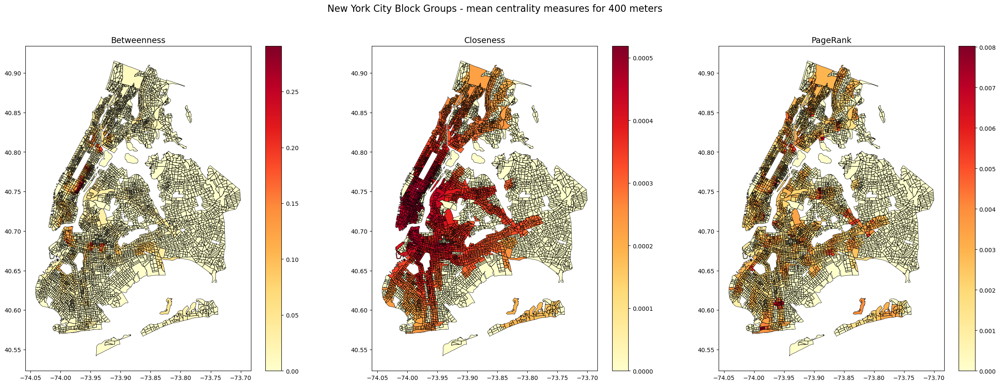

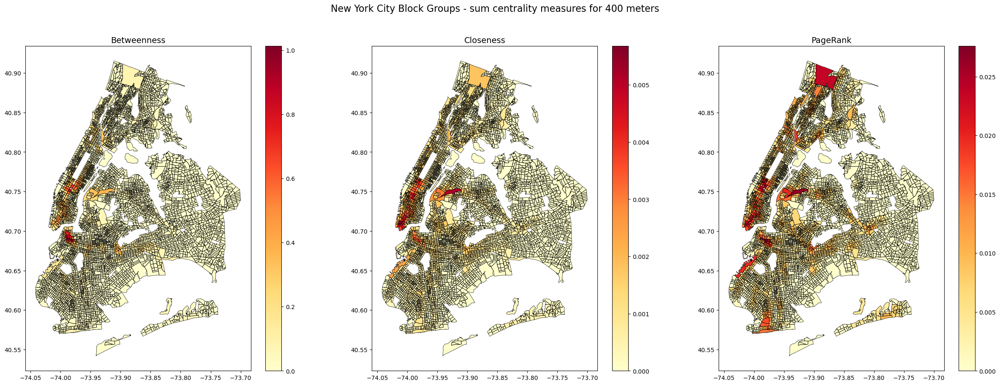

In [12]:
plot_choropleth_maps(nyc_gdf, 'mean', '400')
plot_choropleth_maps(nyc_gdf, 'sum', '400')


## 800 Meters

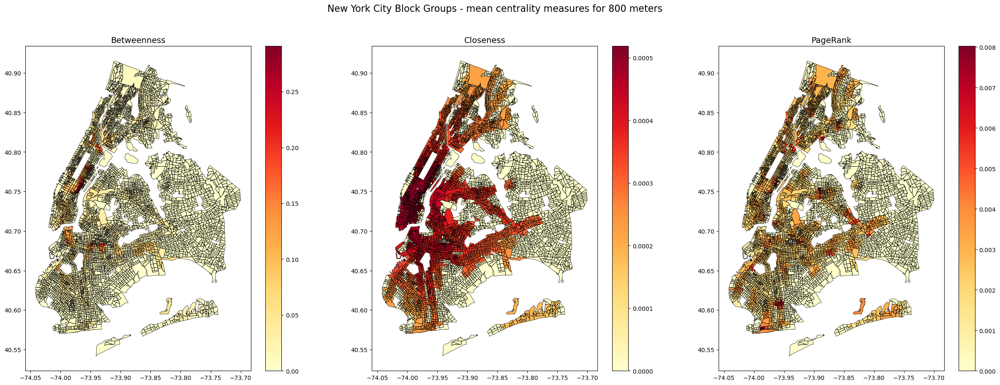

KeyboardInterrupt: 

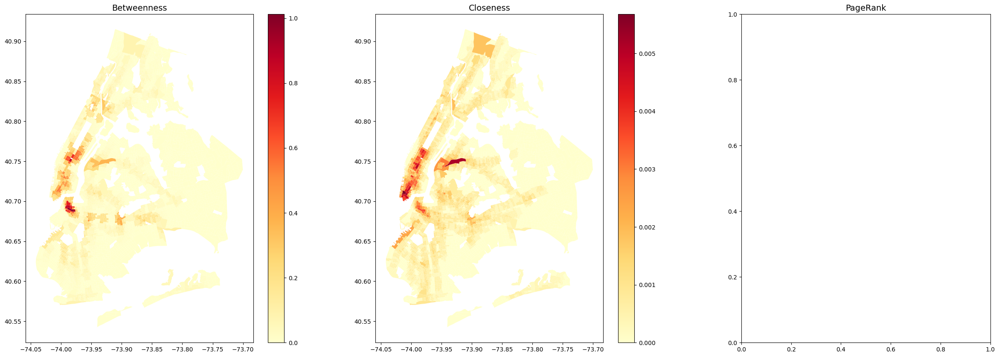

In [13]:
plot_choropleth_maps(nyc_gdf, 'mean', '800')
plot_choropleth_maps(nyc_gdf, 'sum', '800')


## 1000 meters Means

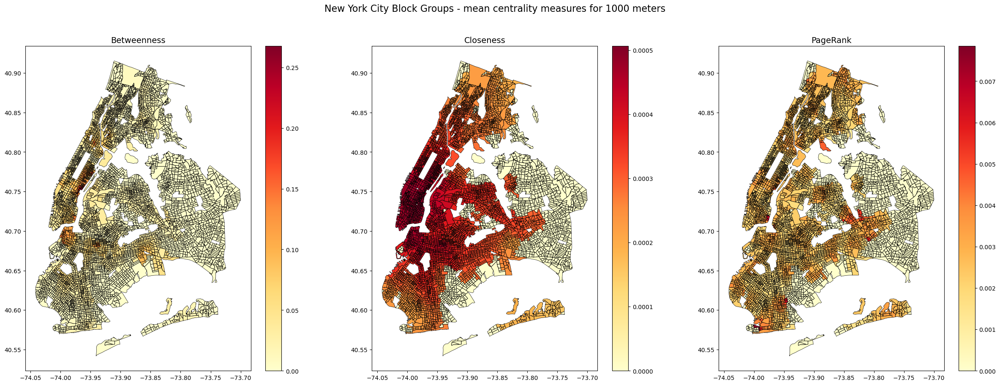

In [ ]:
plot_choropleth_maps(nyc_gdf, 'mean', '1000')


## 1000 meters Sum

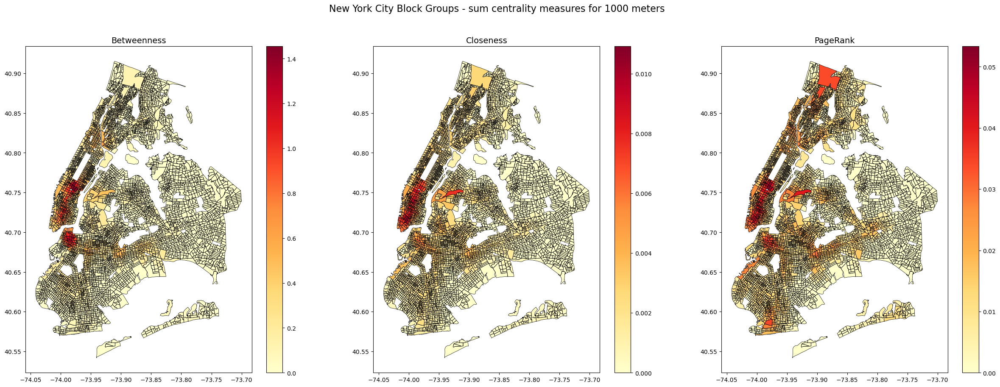

In [ ]:
plot_choropleth_maps(nyc_gdf, 'sum', '1000')


## 2000 meters Means

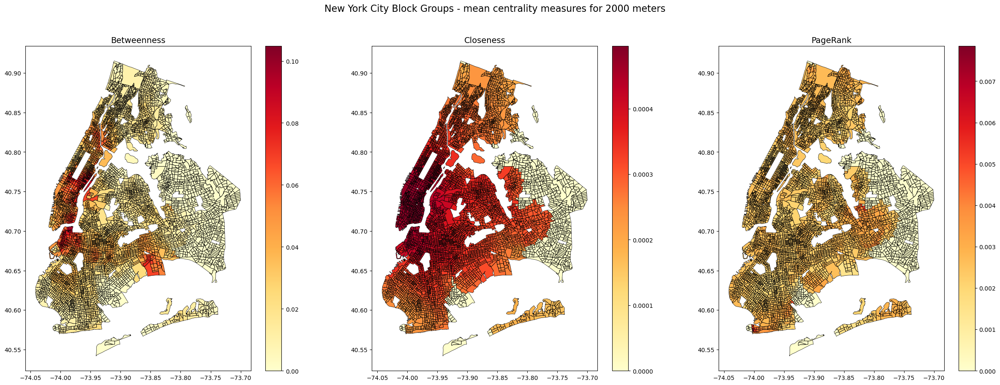

In [ ]:
plot_choropleth_maps(nyc_gdf, 'mean', '2000')


## 2000 meters Sum

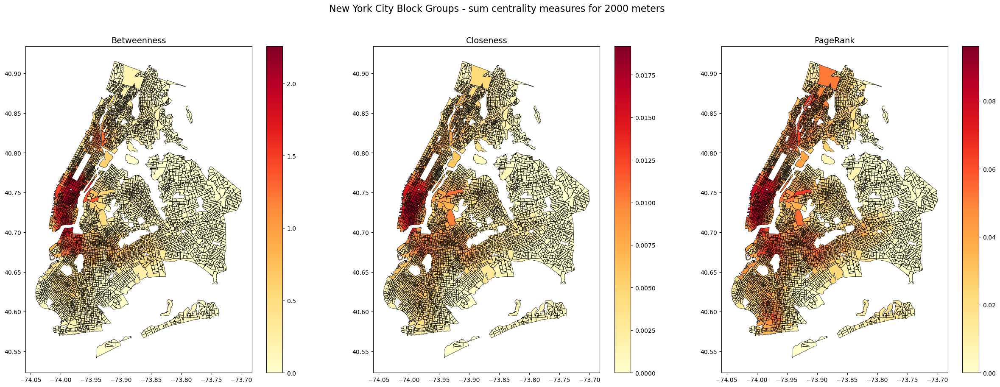

In [ ]:
plot_choropleth_maps(nyc_gdf, 'sum', '2000')


## 5000 meters Means

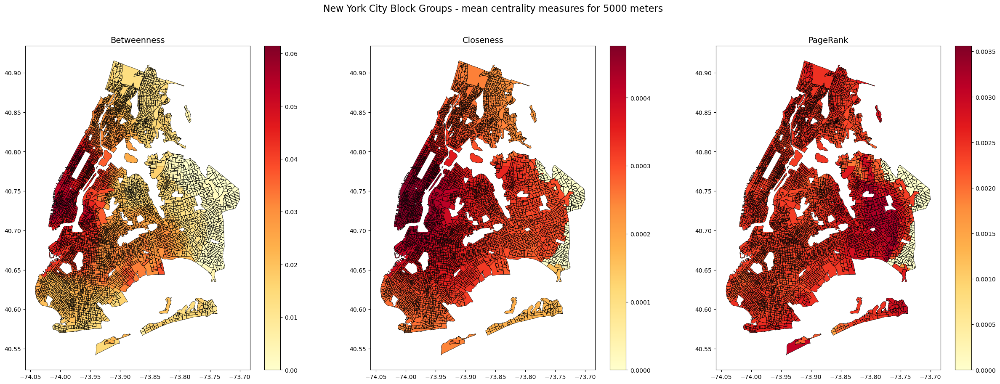

In [ ]:
plot_choropleth_maps(nyc_gdf, 'mean', '5000')


## 5000 meters Sum

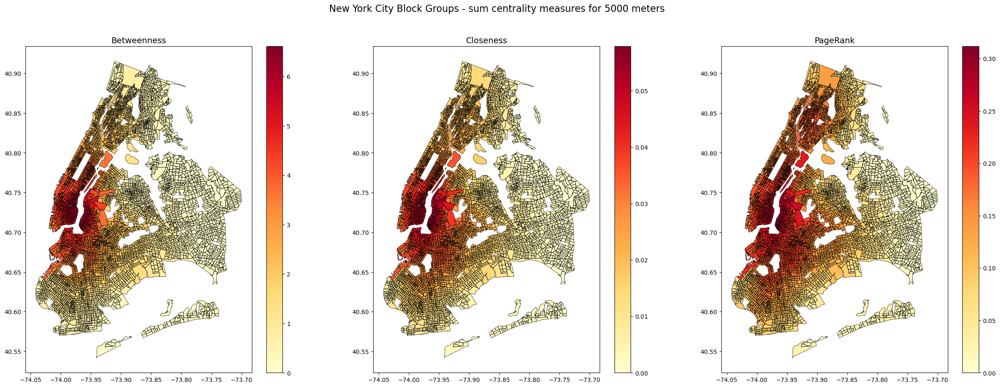

In [ ]:
plot_choropleth_maps(nyc_gdf, 'sum', '5000')


## 7000 meters mean

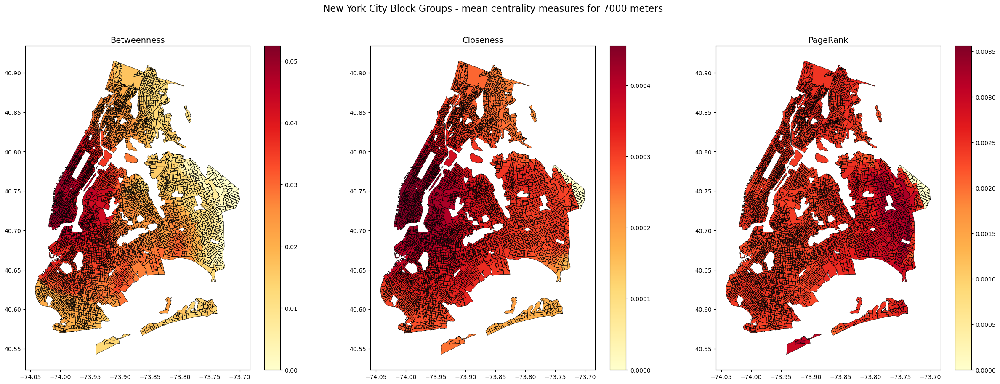

In [ ]:
plot_choropleth_maps(nyc_gdf, 'mean', '7000')


## 7000 meters Sum

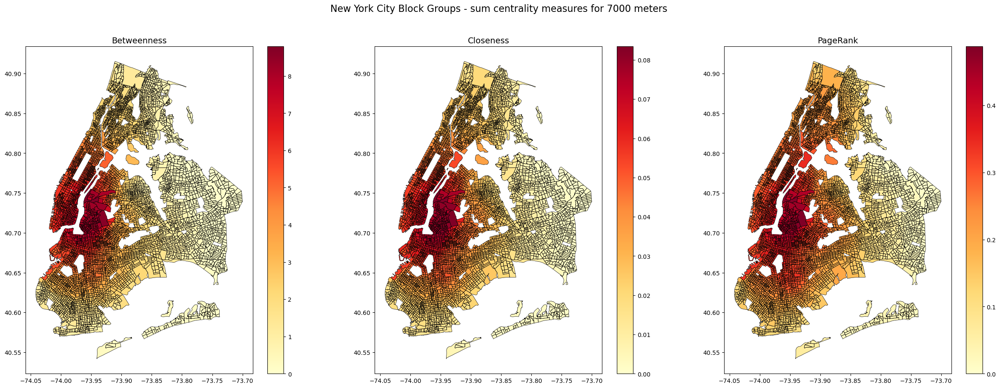

In [15]:
plot_choropleth_maps(nyc_gdf, 'sum', '7000')


## 10000 meters Mean

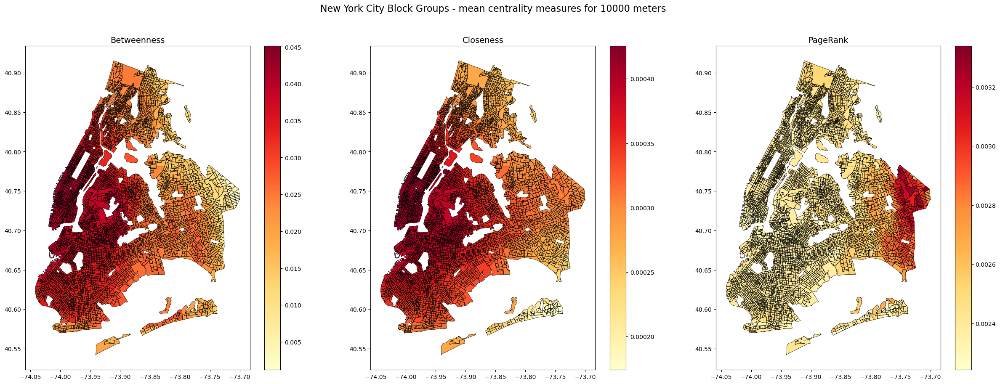

In [ ]:
plot_choropleth_maps(nyc_gdf, 'mean', '10000')


## 10000 meters Sum

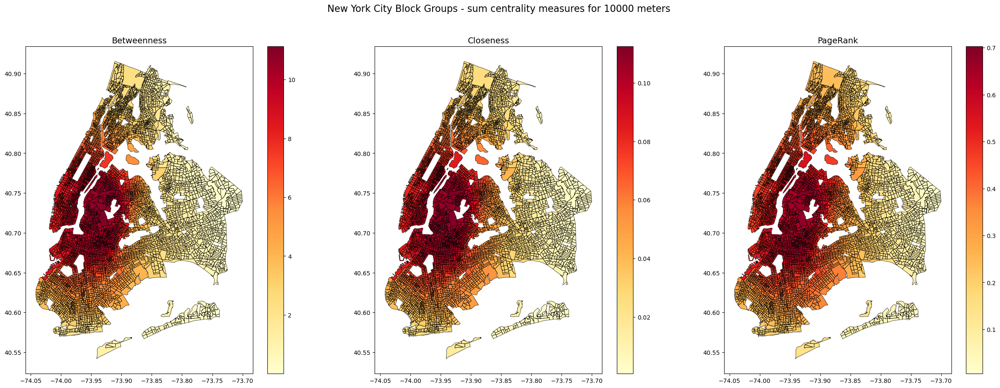

In [16]:
plot_choropleth_maps(nyc_gdf, 'sum', '10000')


# Exporting GeoJson

In [6]:
nyc_gdf = pd.read_pickle('./nyc_gdf.pkl', compression='gzip')

na_threshold = 100
na_counts = nyc_gdf.isna().sum()
# for col in nyc_gdf.columns:
#     na_count = nyc_gdf[col].isna().sum()
#     print(f"{na_count} missing \t - {col}")

cols_to_remove = na_counts[na_counts > na_threshold].index.tolist()
for col in cols_to_remove:
    na_count = na_counts[col]
    print(f"{na_count} missing \t - {col}")

# Find columns with more than 20 missing values
na_counts = nyc_gdf.isna().sum(axis=0)

cols_to_remove = na_counts[na_counts > na_threshold].index

# Remove columns with more than 20 missing values
nyc_gdf = nyc_gdf.loc[:, ~nyc_gdf.columns.isin(cols_to_remove)]

# Drop NaN values to remove the parks and the like
nyc_gdf = nyc_gdf.dropna()

# # Find all columns ending in an 's' in nyc_gdf and print in a for loop
# for col in nyc_gdf.columns:
#     if col.endswith('s'):
#         print(col)
        
# Filter nyc_gdf for all columns not ending in an 's'
nyc_gdf = nyc_gdf[[col for col in nyc_gdf.columns if not col.endswith('s')]]



5908 missing 	 - Geo_US
5908 missing 	 - Geo_REGION
5908 missing 	 - Geo_DIVISION
5908 missing 	 - Geo_STATECE
5908 missing 	 - Geo_COUSUB
5908 missing 	 - Geo_PLACE
5908 missing 	 - Geo_PLACESE
5908 missing 	 - Geo_CONCIT
5908 missing 	 - Geo_AIANHH
5908 missing 	 - Geo_AIANHHFP
5908 missing 	 - Geo_AIHHTLI
5908 missing 	 - Geo_AITSCE
5908 missing 	 - Geo_AITS
5908 missing 	 - Geo_ANRC
5908 missing 	 - Geo_CBSA
5908 missing 	 - Geo_CSA
5908 missing 	 - Geo_METDIV
5908 missing 	 - Geo_MACC
5908 missing 	 - Geo_MEMI
5908 missing 	 - Geo_NECTA
5908 missing 	 - Geo_CNECTA
5908 missing 	 - Geo_NECTADIV
5908 missing 	 - Geo_UA
5908 missing 	 - Geo_UACP
5908 missing 	 - Geo_CDCURR
5908 missing 	 - Geo_SLDU
5908 missing 	 - Geo_SLDL
5908 missing 	 - Geo_VTD
5908 missing 	 - Geo_ZCTA3
5908 missing 	 - Geo_ZCTA5
5908 missing 	 - Geo_SUBMCD
5908 missing 	 - Geo_SDELM
5908 missing 	 - Geo_SDSEC
5908 missing 	 - Geo_SDUNI
5908 missing 	 - Geo_UR
5908 missing 	 - Geo_PCI
5908 missing 	 - Geo_TAZ
59

### network centrality result geojson

In [14]:
# New COlumns
nyc_gdf['inverse_vehicle_use'] = 100 - nyc_gdf['PCT_ACS19_5yr_B08301002']
# # nyc_gdf['log_inverse_vehicle_use'] = np.log(nyc_gdf['inverse_vehicle_use'])

nyc_gdf['pop_density'] = nyc_gdf['ACS19_5yr_B01001001'] / nyc_gdf['Geo_AREALAND']
nyc_gdf['household_density'] = nyc_gdf['ACS19_5yr_B11001001'] / nyc_gdf['Geo_AREALAND']


In [15]:

df = nyc_gdf[['GEOID', 'geometry', 'inverse_vehicle_use','pop_density','household_density',
              'PCT_SE_A09001_002', #: % Workers 16 Years and Over: Did Not Work At Home
              'PCT_SE_A10060_002', #: % Occupied Housing Units: Owner Occupied
              'PCT_SE_A10060_003', #: % Occupied Housing Units: Renter Occupied
              'PCT_SE_A10038_002', #: % Renter-Occupied Housing Units: Less than $300
              'PCT_SE_A10038_003', #: % Renter-Occupied Housing Units: $300 to $499
              'PCT_SE_A10038_004', #: % Renter-Occupied Housing Units: $500 to $799
              'PCT_SE_A10038_005', #: % Renter-Occupied Housing Units: $800 to $999
              'PCT_SE_A10038_006', #: % Renter-Occupied Housing Units: $1,000 to $1,499
              'PCT_SE_A10038_007', #: % Renter-Occupied Housing Units: $1,500 to $1,999
              'PCT_SE_A10038_008', #: % Renter-Occupied Housing Units: $2,000 to $2,499
              'PCT_SE_A10038_009', #: % Renter-Occupied Housing Units: $2,500 to $2,999
              'PCT_SE_A10038_010', #: % Renter-Occupied Housing Units: $3,000 or More
              'PCT_SE_A10038_011', #: % Renter-Occupied Housing Units: No Cash Rent
              # 'PCT_SE_A10054B_002', #: % Renter-Occupied Housing Units: No Vehicle Available
              # 'PCT_SE_A10054B_003', #: % Renter-Occupied Housing Units: 1 Vehicle Available
              # 'PCT_SE_A10054B_004', #: % Renter-Occupied Housing Units: 2 Vehicles Available
              # 'PCT_SE_A10054B_005', #: % Renter-Occupied Housing Units: 3 Vehicles Available
              # 'PCT_SE_A10054B_006', #: % Renter-Occupied Housing Units: 4 Vehicles Available
              # 'PCT_SE_A10054B_007', #: % Renter-Occupied Housing Units: 5 or More Vehicles Available
            #   'PCT_SE_A10030_002', #: % Occupied Housing Units: No Vehicle Available
            #   'PCT_SE_A10030_003', #: % Occupied Housing Units: 1 Vehicle Available
            #   'PCT_SE_A10030_004', #: % Occupied Housing Units: 2 Vehicles Available
            #   'PCT_SE_A10030_005', #: % Occupied Housing Units: 3 Vehicles Available
            #   'PCT_SE_A10030_006', #: % Occupied Housing Units: 4 Vehicles Available
            #   'PCT_SE_A10030_007', #: % Occupied Housing Units: 5 or More Vehicles Available
              'PCT_SE_A14001_002', #: % Households: Less than $10,000
              'PCT_SE_A14001_003', #: % Households: $10,000 to $14,999
              'PCT_SE_A14001_004', #: % Households: $15,000 to $19,999
              'PCT_SE_A14001_005', #: % Households: $20,000 to $24,999
              'PCT_SE_A14001_006', #: % Households: $25,000 to $29,999
              'PCT_SE_A14001_007', #: % Households: $30,000 to $34,999
              'PCT_SE_A14001_008', #: % Households: $35,000 to $39,999
              'PCT_SE_A14001_009', #: % Households: $40,000 to $44,999
              'PCT_SE_A14001_010', #: % Households: $45,000 to $49,999
              'PCT_SE_A14001_011', #: % Households: $50,000 to $59,999
              'PCT_SE_A14001_012', #: % Households: $60,000 to $74,999
              'PCT_SE_A14001_013', #: % Households: $75,000 to $99,999
              'PCT_SE_A14001_014', #: % Households: $100,000 to $124,999
              'PCT_SE_A14001_015', #: % Households: $125,000 to $149,999
              'PCT_SE_A14001_016', #: % Households: $150,000 to $199,999
              'PCT_SE_A14001_017', #: % Households: $200,000 or More
              'SE_A14008_001', #: Average Household Income (In 2019 Inflation Adjusted Dollars)
              'SE_A14024_001', #: Per Capita Income (In 2019 Inflation Adjusted Dollars)
              'PCT_SE_A13002_002', #: % Families: Income Below Poverty Level
            'clse_mean_radius_400',
            'clse_mean_radius_800',
            'clse_mean_radius_1000',
            'clse_mean_radius_2000',
            'clse_mean_radius_5000',
            'clse_mean_radius_7000',
            'clse_mean_radius_10000',
            'btwn_mean_radius_400',
            'btwn_mean_radius_800',
            'btwn_mean_radius_1000',
            'btwn_mean_radius_2000',
            'btwn_mean_radius_5000',
            'btwn_mean_radius_7000',
            'btwn_mean_radius_10000',
            'pgrk_mean_radius_400',
            'pgrk_mean_radius_800',
            'pgrk_mean_radius_1000',
            'pgrk_mean_radius_2000',
            'pgrk_mean_radius_5000',
            'pgrk_mean_radius_7000',
            'pgrk_mean_radius_10000',
            'clse_sum_radius_400',
            'clse_sum_radius_800',
            'clse_sum_radius_1000',
            'clse_sum_radius_2000',
            'clse_sum_radius_5000',
            'clse_sum_radius_7000',
            'clse_sum_radius_10000',
            'btwn_sum_radius_400',
            'btwn_sum_radius_800',
            'btwn_sum_radius_1000',
            'btwn_sum_radius_2000',
            'btwn_sum_radius_5000',
            'btwn_sum_radius_7000',
            'btwn_sum_radius_10000',
            'pgrk_sum_radius_400',
            'pgrk_sum_radius_800',
            'pgrk_sum_radius_1000',
            'pgrk_sum_radius_2000',
            'pgrk_sum_radius_5000',
            'pgrk_sum_radius_7000',
            'pgrk_sum_radius_10000',
            ]]

In [3]:
# # unnecessary because rather than direct export it is wiser to melt for filtering purposes
# # Export the GeoDataFrame to a GeoJSON file
# df.to_file("df_data.geojson", driver='GeoJSON')

KeyboardInterrupt: 

In [27]:
# id_vars = ['GEOID', 'geometry', 'inverse_vehicle_use', 'pop_density',
#        'household_density', 'PCT_SE_A09001_002', 'PCT_SE_A10060_002',
#        'PCT_SE_A10060_003', 'PCT_SE_A10038_002', 'PCT_SE_A10038_003',
#        'PCT_SE_A10038_004', 'PCT_SE_A10038_005', 'PCT_SE_A10038_006',
#        'PCT_SE_A10038_007', 'PCT_SE_A10038_008', 'PCT_SE_A10038_009',
#        'PCT_SE_A10038_010', 'PCT_SE_A10038_011', 'PCT_SE_A14001_002',
#        'PCT_SE_A14001_003', 'PCT_SE_A14001_004', 'PCT_SE_A14001_005',
#        'PCT_SE_A14001_006', 'PCT_SE_A14001_007', 'PCT_SE_A14001_008',
#        'PCT_SE_A14001_009', 'PCT_SE_A14001_010', 'PCT_SE_A14001_011',
#        'PCT_SE_A14001_012', 'PCT_SE_A14001_013', 'PCT_SE_A14001_014',
#        'PCT_SE_A14001_015', 'PCT_SE_A14001_016', 'PCT_SE_A14001_017',
#        'SE_A14008_001', 'SE_A14024_001', 'PCT_SE_A13002_002',
#        'clse_mean_radius_400', 'clse_mean_radius_800', 'clse_mean_radius_1000',
#        'clse_mean_radius_2000', 'clse_mean_radius_5000',
#        'clse_mean_radius_7000', 'clse_mean_radius_10000',
#        'btwn_mean_radius_400', 'btwn_mean_radius_800', 'btwn_mean_radius_1000',
#        'btwn_mean_radius_2000', 'btwn_mean_radius_5000',
#        'btwn_mean_radius_7000', 'btwn_mean_radius_10000',
#        'pgrk_mean_radius_400', 'pgrk_mean_radius_800', 'pgrk_mean_radius_1000',
#        'pgrk_mean_radius_2000', 'pgrk_mean_radius_5000',
#        'pgrk_mean_radius_7000', 'pgrk_mean_radius_10000',
#        'clse_sum_radius_400', 'clse_sum_radius_800', 'clse_sum_radius_1000',
#        'clse_sum_radius_2000', 'clse_sum_radius_5000', 'clse_sum_radius_7000',
#        'clse_sum_radius_10000', 'btwn_sum_radius_400', 'btwn_sum_radius_800',
#        'btwn_sum_radius_1000', 'btwn_sum_radius_2000', 'btwn_sum_radius_5000',
#        'btwn_sum_radius_7000', 'btwn_sum_radius_10000', 'pgrk_sum_radius_400',
#        'pgrk_sum_radius_800', 'pgrk_sum_radius_1000', 'pgrk_sum_radius_2000',
#        'pgrk_sum_radius_5000', 'pgrk_sum_radius_7000',
#        'pgrk_sum_radius_10000']
# id_vars

['GEOID',
 'geometry',
 'inverse_vehicle_use',
 'pop_density',
 'household_density',
 'PCT_SE_A09001_002',
 'PCT_SE_A10060_002',
 'PCT_SE_A10060_003',
 'PCT_SE_A10038_002',
 'PCT_SE_A10038_003',
 'PCT_SE_A10038_004',
 'PCT_SE_A10038_005',
 'PCT_SE_A10038_006',
 'PCT_SE_A10038_007',
 'PCT_SE_A10038_008',
 'PCT_SE_A10038_009',
 'PCT_SE_A10038_010',
 'PCT_SE_A10038_011',
 'PCT_SE_A14001_002',
 'PCT_SE_A14001_003',
 'PCT_SE_A14001_004',
 'PCT_SE_A14001_005',
 'PCT_SE_A14001_006',
 'PCT_SE_A14001_007',
 'PCT_SE_A14001_008',
 'PCT_SE_A14001_009',
 'PCT_SE_A14001_010',
 'PCT_SE_A14001_011',
 'PCT_SE_A14001_012',
 'PCT_SE_A14001_013',
 'PCT_SE_A14001_014',
 'PCT_SE_A14001_015',
 'PCT_SE_A14001_016',
 'PCT_SE_A14001_017',
 'SE_A14008_001',
 'SE_A14024_001',
 'PCT_SE_A13002_002',
 'clse_mean_radius_400',
 'clse_mean_radius_800',
 'clse_mean_radius_1000',
 'clse_mean_radius_2000',
 'clse_mean_radius_5000',
 'clse_mean_radius_7000',
 'clse_mean_radius_10000',
 'btwn_mean_radius_400',
 'btwn_mean_r

In [34]:
import pandas as pd

# List of column names to keep as ID variables
id_vars = ['GEOID', 'geometry']

# Melt the DataFrame
melted_df = pd.melt(df, id_vars=id_vars, var_name='column_key', value_name='column_value')

# Export the GeoDataFrame to a GeoJSON file
melted_df.to_file("melted_df.geojson", driver='GeoJSON')

### us census data to melt


In [4]:

for col in nyc_gdf.columns:
    na_count = nyc_gdf[col].isna().sum()
    print(f"{na_count} missing \t - {col}")

0 missing 	 - Geo_FIPS
0 missing 	 - Geo_NAME
0 missing 	 - Geo_QName
0 missing 	 - Geo_STUSAB
0 missing 	 - Geo_SUMLEV
0 missing 	 - Geo_GEOCOMP
0 missing 	 - Geo_FILEID
0 missing 	 - Geo_LOGRECNO
0 missing 	 - Geo_STATE
0 missing 	 - Geo_COUNTY
0 missing 	 - Geo_TRACT
0 missing 	 - Geo_BLKGRP
0 missing 	 - Geo_GEOID
0 missing 	 - Geo_AREALAND
0 missing 	 - Geo_AREAWATR
0 missing 	 - SE_A00001_001
0 missing 	 - SE_A00002_001
0 missing 	 - SE_A00002_002
0 missing 	 - SE_A00002_003
0 missing 	 - SE_A09005_001
0 missing 	 - SE_A09005_002
0 missing 	 - SE_A09005_009
0 missing 	 - SE_A09005_010
0 missing 	 - SE_A09005_003
0 missing 	 - SE_A09005_004
0 missing 	 - SE_A09005_005
0 missing 	 - SE_A09005_006
0 missing 	 - SE_A09005_007
0 missing 	 - SE_A09005_008
0 missing 	 - PCT_SE_A09005_002
0 missing 	 - PCT_SE_A09005_009
0 missing 	 - PCT_SE_A09005_010
0 missing 	 - PCT_SE_A09005_003
0 missing 	 - PCT_SE_A09005_004
0 missing 	 - PCT_SE_A09005_005
0 missing 	 - PCT_SE_A09005_006
0 missing 

In [7]:
df = nyc_gdf[['GEOID', 'geometry','SE_A10001_001',
                   'SE_B13004_001',
                   'SE_B13004_002',
                   'SE_B13004_003',
                   'SE_B13004_004',
                   'SE_B13004_005',
                   'PCT_SE_B13004_002',
                   'PCT_SE_B13004_003',
                   'PCT_SE_B13004_004',
                   'PCT_SE_B13004_005',
                   'SE_A13002_001',
                   'SE_A13002_002',
                   'SE_A13002_003',
                   'SE_A13002_004',
                   'SE_A13002_005',
                   'SE_A13002_006',
                   'SE_A13002_007',
                   'SE_A13002_008',
                   'SE_A13002_009',
                   'SE_A13002_010',
                   'SE_A13002_011',
                   'PCT_SE_A13002_002',
                   'PCT_SE_A13002_003',
                   'PCT_SE_A13002_004',
                   'PCT_SE_A13002_005',
                   'PCT_SE_A13002_006',
                   'PCT_SE_A13002_007',
                   'PCT_SE_A13002_008',
                   'PCT_SE_A13002_009',
                   'PCT_SE_A13002_010',
                   'PCT_SE_A13002_011',
                   'SE_A13004_001',
                   'SE_A13004_002',
                   'SE_A13004_005',
                   'SE_A13004_006',
                   'SE_A13004_007',
                   'PCT_SE_A13004_002',
                   'PCT_SE_A13004_005',
                   'PCT_SE_A13004_006',
                   'PCT_SE_A13004_007',
                   ]]

In [ ]:

# # Export the GeoDataFrame to a GeoJSON file
# nyc_gdf.to_file("nyc_gdf_data.geojson", driver='GeoJSON')


In [8]:
import pandas as pd

# List of column names to keep as ID variables
id_vars = ['GEOID', 'geometry']

# Melt the DataFrame
melted_df = pd.melt(df, id_vars=id_vars, var_name='column_key', value_name='column_value')

# Export the GeoDataFrame to a GeoJSON file
melted_df.to_file("us_census_data_melted_df.geojson", driver='GeoJSON')

# Regressions

In [2]:
nyc_gdf = pd.read_pickle('./nyc_gdf.pkl', compression='gzip')


### Data Cleanup

In [5]:
na_threshold = 100
na_counts = nyc_gdf.isna().sum()
# for col in nyc_gdf.columns:
#     na_count = nyc_gdf[col].isna().sum()
#     print(f"{na_count} missing \t - {col}")

cols_to_remove = na_counts[na_counts > na_threshold].index.tolist()
for col in cols_to_remove:
    na_count = na_counts[col]
    print(f"{na_count} missing \t - {col}")

# Find columns with more than 20 missing values
na_counts = nyc_gdf.isna().sum(axis=0)

cols_to_remove = na_counts[na_counts > na_threshold].index

# Remove columns with more than 20 missing values
nyc_gdf = nyc_gdf.loc[:, ~nyc_gdf.columns.isin(cols_to_remove)]

# Drop NaN values to remove the parks and the like
nyc_gdf = nyc_gdf.dropna()

# # Find all columns ending in an 's' in nyc_gdf and print in a for loop
# for col in nyc_gdf.columns:
#     if col.endswith('s'):
#         print(col)
        
# Filter nyc_gdf for all columns not ending in an 's'
nyc_gdf = nyc_gdf[[col for col in nyc_gdf.columns if not col.endswith('s')]]

# Filter nyc_gdf columns for numeric values
nyc_gdf = nyc_gdf.loc[:,'Geo_AREALAND':]
nyc_gdf = nyc_gdf.loc[:, ~nyc_gdf.columns.isin(nyc_gdf.loc[:, 'STATEFP':'geometry'].columns)]

In [ ]:
# Load the column names file
column_decode = pd.read_csv('./data/socialexplorer_nyc_blockgroup_data/column_names.csv', header=None, index_col=1)

# Loop through each column in nyc_gdf and print the corresponding code and definition
for column in nyc_gdf.columns:
    if column in column_decode.index:
        code = column
        definition = column_decode.loc[column, 0]
    else:
        code = " --- "
        definition = " --- "
        
    print(f"{column}: {definition}")


Geo_AREALAND: Area (Land)
Geo_AREAWATR: Area (Water)
SE_A00001_001: Total Population
SE_A00002_001: Total Population
SE_A00002_002: Population Density (Per Sq. Mile)
SE_A00002_003: Area (Land)
SE_A09005_001: Workers 16 Years and Over:
SE_A09005_002: Workers 16 Years and Over: Car, Truck, or Van
SE_A09005_009: Workers 16 Years and Over: Drove Alone
SE_A09005_010: Workers 16 Years and Over: Carpooled
SE_A09005_003: Workers 16 Years and Over: Public Transportation (Includes Taxicab)
SE_A09005_004: Workers 16 Years and Over: Motorcycle
SE_A09005_005: Workers 16 Years and Over: Bicycle
SE_A09005_006: Workers 16 Years and Over: Walked
SE_A09005_007: Workers 16 Years and Over: Other Means
SE_A09005_008: Workers 16 Years and Over: Worked At Home
PCT_SE_A09005_002: % Workers 16 Years and Over: Car, Truck, or Van
PCT_SE_A09005_009: % Workers 16 Years and Over: Drove Alone
PCT_SE_A09005_010: % Workers 16 Years and Over: Carpooled
PCT_SE_A09005_003: % Workers 16 Years and Over: Public Transportati

### filtered dataset random forest regression

In [6]:
import numpy as np
# Clean Data
# zip is not included beacuse that's an index, not a calculated value

# Plot the second choropleth map on the second subplot
nyc_gdf['inverse_vehicle_use'] = 100 - nyc_gdf['PCT_ACS19_5yr_B08301002']
# # nyc_gdf['log_inverse_vehicle_use'] = np.log(nyc_gdf['inverse_vehicle_use'])

nyc_gdf['pop_density'] = nyc_gdf['ACS19_5yr_B01001001'] / nyc_gdf['Geo_AREALAND']
nyc_gdf['household_density'] = nyc_gdf['ACS19_5yr_B11001001'] / nyc_gdf['Geo_AREALAND']

# 'inverse_vehicle_use','log_inverse_vehicle_use',
            
df = nyc_gdf[['inverse_vehicle_use','pop_density','household_density',
            'PCT_ACS19_5yr_B08134011',
            'PCT_ACS19_5yr_B08134061',
            'PCT_ACS19_5yr_B08134082',
            'PCT_ACS19_5yr_B08134083',
            'PCT_ACS19_5yr_B08134084',
            'PCT_ACS19_5yr_B08134085',
            'PCT_ACS19_5yr_B08134086',
            'PCT_ACS19_5yr_B08134087',
            'PCT_ACS19_5yr_B08134088',
            'PCT_ACS19_5yr_B08134089',
            'PCT_ACS19_5yr_B08134090',
            'PCT_ACS19_5yr_B08134091',
            'ACS19_5yr_B08301021',
            'PCT_ACS19_5yr_B08301012',
            'PCT_ACS19_5yr_B08301014',
            'PCT_ACS19_5yr_B08301021',
            'PCT_ACS19_5yr_B08134081',
            'clse_mean_radius_500',
            'clse_mean_radius_800',
            'clse_mean_radius_1000',
            'clse_mean_radius_2000',
            'clse_mean_radius_5000',
            'clse_mean_radius_7000',
            'clse_mean_radius_10000',
            'btwn_mean_radius_500',
            'btwn_mean_radius_800',
            'btwn_mean_radius_1000',
            'btwn_mean_radius_2000',
            'btwn_mean_radius_5000',
            'btwn_mean_radius_7000',
            'btwn_mean_radius_10000',
            'pgrk_mean_radius_500',
            'pgrk_mean_radius_800',
            'pgrk_mean_radius_1000',
            'pgrk_mean_radius_2000',
            'pgrk_mean_radius_5000',
            'pgrk_mean_radius_7000',
            'pgrk_mean_radius_10000',
            'clse_sum_radius_500',
            'clse_sum_radius_800',
            'clse_sum_radius_1000',
            'clse_sum_radius_2000',
            'clse_sum_radius_5000',
            'clse_sum_radius_7000',
            'clse_sum_radius_10000',
            'btwn_sum_radius_500',
            'btwn_sum_radius_800',
            'btwn_sum_radius_1000',
            'btwn_sum_radius_2000',
            'btwn_sum_radius_5000',
            'btwn_sum_radius_7000',
            'btwn_sum_radius_10000',
            'pgrk_sum_radius_500',
            'pgrk_sum_radius_800',
            'pgrk_sum_radius_1000',
            'pgrk_sum_radius_2000',
            'pgrk_sum_radius_5000',
            'pgrk_sum_radius_7000',
            'pgrk_sum_radius_10000',
            ]]

np.any(np.isnan(df))
np.all(np.isfinite(df))

df=df.dropna()
# df = df.fillna(0)


# from sklearn.cluster import KMeans
# import seaborn as sns; sns.set()  # for plot styling

# number_of_cluters = 100
# kmeans = KMeans(n_clusters=number_of_cluters, n_init=100) # default is 10

# y_kmeans = kmeans.fit_predict(df)
# df['cluster'] = kmeans.labels_

# df = df.groupby('cluster').mean() #cluster means

# df = df.sort_values(by=['inverse_vehicle_use'], ascending=False)
# df

# plt.figure(figsize=(15, 8))

# df_norm = (df - df.mean()) / (df.max() - df.min())
# sns.heatmap(df_norm)

from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(df.drop('inverse_vehicle_use', axis=1), df['inverse_vehicle_use'], test_size=0.3, random_state=42)

# Create an instance of the RandomForestRegressor class
rf = RandomForestRegressor(n_estimators=100, random_state=42)

# Fit the model to the training data
rf.fit(X_train, y_train)

# Make predictions on the testing data
y_pred = rf.predict(X_test)

# Evaluate the performance of the model using mean absolute error and mean squared error
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)

print('Mean absolute error:', mae)
print('Mean squared error:', mse)

# Extract the feature importances
importances = rf.feature_importances_

# Create a list of tuples (feature name, importance score)
feature_importances = [(feature, importance) for feature, importance in zip(df.drop('inverse_vehicle_use', axis=1).columns, importances)]

# Sort the list by importance score in descending order
feature_importances = sorted(feature_importances, key=lambda x: x[1], reverse=True)

# Load the column names file
column_decode = pd.read_csv('./data/socialexplorer_nyc_blockgroup_data/column_names.csv', header=None)

# # Print the list of significant variables and their importance scores
# for feature, importance in feature_importances:
#     print(feature, column_decode.loc[feature], importance)

# If column_decode contains codes:
# Print the list of significant variables and their importance scores along with their definitions
for feature, importance in feature_importances:
    try:
        code = column_decode.loc[column_decode[1] == feature][1].values[0]
        definition = column_decode.loc[column_decode[1] == feature][0].values[0]
    except IndexError:
        code = feature
        definition = " --- "

    print(f"({importance}) {code}: {definition}")

KeyError: "['clse_mean_radius_500', 'btwn_mean_radius_500', 'pgrk_mean_radius_500', 'clse_sum_radius_500', 'btwn_sum_radius_500', 'pgrk_sum_radius_500'] not in index"

### Filtered Dataset simplified, random forest regression

Mean absolute error: 9.340634634051641
Mean squared error: 153.97856282646734
R-squared: 0.5927891039848798
(0.3831373326394343) household_density:  --- 
(0.09553727523173643) PCT_SE_A10060_002: % Occupied Housing Units: Owner Occupied
(0.06805451695182657) PCT_SE_A10060_003: % Occupied Housing Units: Renter Occupied
(0.05309443657153116) PCT_SE_A10038_010: % Renter-Occupied Housing Units: $3,000 or More
(0.030707453438473736) SE_A14024_001: Per Capita Income (In 2019 Inflation Adjusted Dollars)
(0.024725786007265774) pop_density:  --- 
(0.023325630645785442) PCT_SE_A10038_006: % Renter-Occupied Housing Units: $1,000 to $1,499
(0.02198520154060791) SE_A14008_001: Average Household Income (In 2019 Inflation Adjusted Dollars)
(0.01879482796832352) PCT_SE_A14001_017: % Households: $200,000 or More
(0.016863964085406385) PCT_SE_A14001_013: % Households: $75,000 to $99,999
(0.0166700746192853) PCT_SE_A09001_002: % Workers 16 Years and Over: Did Not Work At Home
(0.016040817855664056) PCT_SE

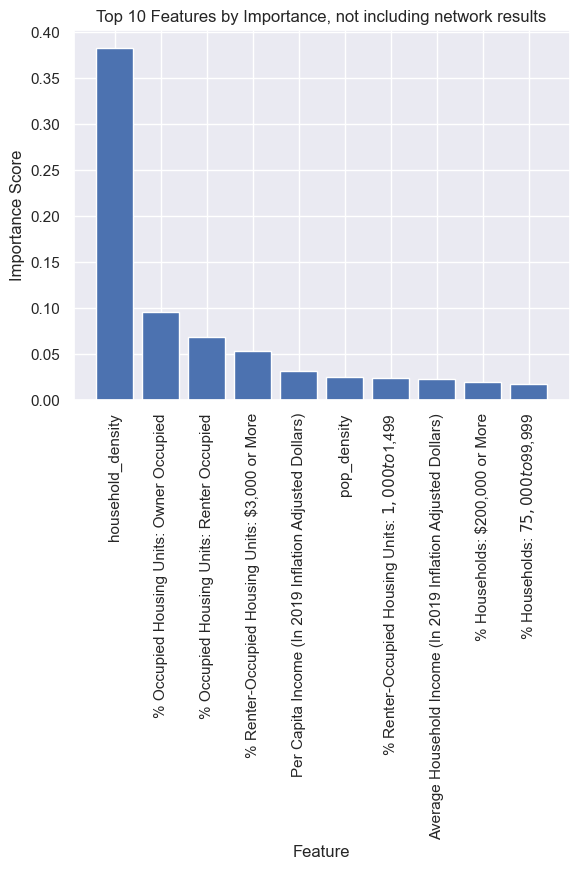

In [ ]:
import numpy as np
# Clean Data
# zip is not included beacuse that's an index, not a calculated value

# Plot the second choropleth map on the second subplot
nyc_gdf['inverse_vehicle_use'] = 100 - nyc_gdf['PCT_ACS19_5yr_B08301002']
# # nyc_gdf['log_inverse_vehicle_use'] = np.log(nyc_gdf['inverse_vehicle_use'])

nyc_gdf['pop_density'] = nyc_gdf['ACS19_5yr_B01001001'] / nyc_gdf['Geo_AREALAND']
nyc_gdf['household_density'] = nyc_gdf['ACS19_5yr_B11001001'] / nyc_gdf['Geo_AREALAND']

# 'inverse_vehicle_use','log_inverse_vehicle_use',
            
df = nyc_gdf[['inverse_vehicle_use','pop_density','household_density',
              'PCT_SE_A09001_002', #: % Workers 16 Years and Over: Did Not Work At Home
              'PCT_SE_A10060_002', #: % Occupied Housing Units: Owner Occupied
              'PCT_SE_A10060_003', #: % Occupied Housing Units: Renter Occupied
              'PCT_SE_A10038_002', #: % Renter-Occupied Housing Units: Less than $300
              'PCT_SE_A10038_003', #: % Renter-Occupied Housing Units: $300 to $499
              'PCT_SE_A10038_004', #: % Renter-Occupied Housing Units: $500 to $799
              'PCT_SE_A10038_005', #: % Renter-Occupied Housing Units: $800 to $999
              'PCT_SE_A10038_006', #: % Renter-Occupied Housing Units: $1,000 to $1,499
              'PCT_SE_A10038_007', #: % Renter-Occupied Housing Units: $1,500 to $1,999
              'PCT_SE_A10038_008', #: % Renter-Occupied Housing Units: $2,000 to $2,499
              'PCT_SE_A10038_009', #: % Renter-Occupied Housing Units: $2,500 to $2,999
              'PCT_SE_A10038_010', #: % Renter-Occupied Housing Units: $3,000 or More
              'PCT_SE_A10038_011', #: % Renter-Occupied Housing Units: No Cash Rent
              # 'PCT_SE_A10054B_002', #: % Renter-Occupied Housing Units: No Vehicle Available
              # 'PCT_SE_A10054B_003', #: % Renter-Occupied Housing Units: 1 Vehicle Available
              # 'PCT_SE_A10054B_004', #: % Renter-Occupied Housing Units: 2 Vehicles Available
              # 'PCT_SE_A10054B_005', #: % Renter-Occupied Housing Units: 3 Vehicles Available
              # 'PCT_SE_A10054B_006', #: % Renter-Occupied Housing Units: 4 Vehicles Available
              # 'PCT_SE_A10054B_007', #: % Renter-Occupied Housing Units: 5 or More Vehicles Available
            #   'PCT_SE_A10030_002', #: % Occupied Housing Units: No Vehicle Available
            #   'PCT_SE_A10030_003', #: % Occupied Housing Units: 1 Vehicle Available
            #   'PCT_SE_A10030_004', #: % Occupied Housing Units: 2 Vehicles Available
            #   'PCT_SE_A10030_005', #: % Occupied Housing Units: 3 Vehicles Available
            #   'PCT_SE_A10030_006', #: % Occupied Housing Units: 4 Vehicles Available
            #   'PCT_SE_A10030_007', #: % Occupied Housing Units: 5 or More Vehicles Available
              'PCT_SE_A14001_002', #: % Households: Less than $10,000
              'PCT_SE_A14001_003', #: % Households: $10,000 to $14,999
              'PCT_SE_A14001_004', #: % Households: $15,000 to $19,999
              'PCT_SE_A14001_005', #: % Households: $20,000 to $24,999
              'PCT_SE_A14001_006', #: % Households: $25,000 to $29,999
              'PCT_SE_A14001_007', #: % Households: $30,000 to $34,999
              'PCT_SE_A14001_008', #: % Households: $35,000 to $39,999
              'PCT_SE_A14001_009', #: % Households: $40,000 to $44,999
              'PCT_SE_A14001_010', #: % Households: $45,000 to $49,999
              'PCT_SE_A14001_011', #: % Households: $50,000 to $59,999
              'PCT_SE_A14001_012', #: % Households: $60,000 to $74,999
              'PCT_SE_A14001_013', #: % Households: $75,000 to $99,999
              'PCT_SE_A14001_014', #: % Households: $100,000 to $124,999
              'PCT_SE_A14001_015', #: % Households: $125,000 to $149,999
              'PCT_SE_A14001_016', #: % Households: $150,000 to $199,999
              'PCT_SE_A14001_017', #: % Households: $200,000 or More
              'SE_A14008_001', #: Average Household Income (In 2019 Inflation Adjusted Dollars)
              'SE_A14024_001', #: Per Capita Income (In 2019 Inflation Adjusted Dollars)
              'PCT_SE_A13002_002', #: % Families: Income Below Poverty Level
            # 'clse_mean_radius_500',
            # 'clse_mean_radius_800',
            # 'clse_mean_radius_1000',
            # 'clse_mean_radius_2000',
            # 'clse_mean_radius_5000',
            # 'clse_mean_radius_7000',
            # 'clse_mean_radius_10000',
            # 'btwn_mean_radius_500',
            # 'btwn_mean_radius_800',
            # 'btwn_mean_radius_1000',
            # 'btwn_mean_radius_2000',
            # 'btwn_mean_radius_5000',
            # 'btwn_mean_radius_7000',
            # 'btwn_mean_radius_10000',
            # 'pgrk_mean_radius_500',
            # 'pgrk_mean_radius_800',
            # 'pgrk_mean_radius_1000',
            # 'pgrk_mean_radius_2000',
            # 'pgrk_mean_radius_5000',
            # 'pgrk_mean_radius_7000',
            # 'pgrk_mean_radius_10000',
            # 'clse_sum_radius_500',
            # 'clse_sum_radius_800',
            # 'clse_sum_radius_1000',
            # 'clse_sum_radius_2000',
            # 'clse_sum_radius_5000',
            # 'clse_sum_radius_7000',
            # 'clse_sum_radius_10000',
            # 'btwn_sum_radius_500',
            # 'btwn_sum_radius_800',
            # 'btwn_sum_radius_1000',
            # 'btwn_sum_radius_2000',
            # 'btwn_sum_radius_5000',
            # 'btwn_sum_radius_7000',
            # 'btwn_sum_radius_10000',
            # 'pgrk_sum_radius_500',
            # 'pgrk_sum_radius_800',
            # 'pgrk_sum_radius_1000',
            # 'pgrk_sum_radius_2000',
            # 'pgrk_sum_radius_5000',
            # 'pgrk_sum_radius_7000',
            # 'pgrk_sum_radius_10000',
            ]]

np.any(np.isnan(df))
np.all(np.isfinite(df))

df=df.dropna()

from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(df.drop('inverse_vehicle_use', axis=1), df['inverse_vehicle_use'], test_size=0.3, random_state=42)

# Create an instance of the RandomForestRegressor class
rf = RandomForestRegressor(n_estimators=150, random_state=42)

# Fit the model to the training data
rf.fit(X_train, y_train)

# Make predictions on the testing data
y_pred = rf.predict(X_test)

# Evaluate the performance of the model using mean absolute error and mean squared error
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)

print('Mean absolute error:', mae)
print('Mean squared error:', mse)

from sklearn.metrics import r2_score

# Calculate the R-squared value of the model on the testing data
r2 = r2_score(y_test, y_pred)

print('R-squared:', r2)

# Extract the feature importances
importances = rf.feature_importances_

# Create a list of tuples (feature name, importance score)
feature_importances = [(feature, importance) for feature, importance in zip(df.drop('inverse_vehicle_use', axis=1).columns, importances)]

# Sort the list by importance score in descending order
feature_importances = sorted(feature_importances, key=lambda x: x[1], reverse=True)

# Load the column names file
column_decode = pd.read_csv('./data/socialexplorer_nyc_blockgroup_data/column_names.csv', header=None)

# # Print the list of significant variables and their importance scores
# for feature, importance in feature_importances:
#     print(feature, column_decode.loc[feature], importance)

# If column_decode contains codes:
# Print the list of significant variables and their importance scores along with their definitions
for feature, importance in feature_importances:
    try:
        code = column_decode.loc[column_decode[1] == feature][1].values[0]
        definition = column_decode.loc[column_decode[1] == feature][0].values[0]
    except IndexError:
        code = feature
        definition = " --- "

    print(f"({importance}) {code}: {definition}")


### histogram

# Extract the feature names and importance scores, sort them in descending order, and select the top 10 results
top_features = sorted([(feature, importance) for feature, importance in feature_importances], key=lambda x: x[1], reverse=True)[:10]

# Extract the feature names and importance scores into separate lists, using human-readable labels if available
feature_names = []
for feature, _ in top_features:
  ## commented section would work if 'key' is set as the index
    # if feature in column_decode.index:
    #     feature_name = f"{column_decode.loc[feature, 0]} ({feature})"
    # else:
    #     feature_name = feature
    try:
        feature_name = column_decode.loc[column_decode[1] == feature][0].values[0]
    except IndexError:
        feature_name = feature
    feature_names.append(feature_name)

importance_scores = [importance for _, importance in top_features]

# Create a vertical bar chart of the top 10 features and their importance scores
plt.bar(feature_names, importance_scores)
plt.xlabel('Feature')
plt.ylabel('Importance Score')
plt.title('Top 10 Features by Importance, not including network results')
plt.xticks(rotation=90)
plt.show()

### Filtered Dataset simplified including network results, random forest regression

Mean absolute error: 7.996170907016542
Mean squared error: 113.28312500674144
R-squared: 0.7053668392693132
(0.40581514732450114) clse_sum_radius_2000:  --- 
(0.06663826316864785) btwn_mean_radius_5000:  --- 
(0.06603514165659863) household_density:  --- 
(0.04835907831469092) clse_sum_radius_1000:  --- 
(0.033829721537039274) PCT_SE_A10060_002: % Occupied Housing Units: Owner Occupied
(0.026916600188608926) PCT_SE_A10060_003: % Occupied Housing Units: Renter Occupied
(0.02478757243546478) btwn_sum_radius_5000:  --- 
(0.018375022611711162) clse_mean_radius_2000:  --- 
(0.011409240670991977) SE_A14008_001: Average Household Income (In 2019 Inflation Adjusted Dollars)
(0.010937310556704898) clse_mean_radius_1000:  --- 
(0.010935382446865231) pop_density:  --- 
(0.01022137610741615) SE_A14024_001: Per Capita Income (In 2019 Inflation Adjusted Dollars)
(0.008471184856489938) pgrk_mean_radius_2000:  --- 
(0.008103043800623107) PCT_SE_A14001_014: % Households: $100,000 to $124,999
(0.0078502

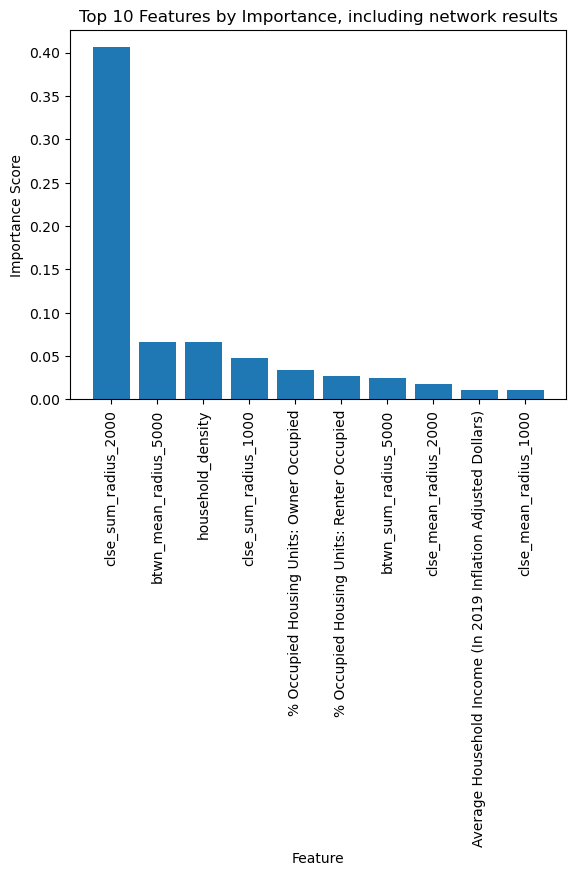

In [4]:
import numpy as np
# Clean Data
# zip is not included beacuse that's an index, not a calculated value

# Plot the second choropleth map on the second subplot
nyc_gdf['inverse_vehicle_use'] = 100 - nyc_gdf['PCT_ACS19_5yr_B08301002']
# # nyc_gdf['log_inverse_vehicle_use'] = np.log(nyc_gdf['inverse_vehicle_use'])

nyc_gdf['pop_density'] = nyc_gdf['ACS19_5yr_B01001001'] / nyc_gdf['Geo_AREALAND']
nyc_gdf['household_density'] = nyc_gdf['ACS19_5yr_B11001001'] / nyc_gdf['Geo_AREALAND']

# 'inverse_vehicle_use','log_inverse_vehicle_use',

df = nyc_gdf[['inverse_vehicle_use','pop_density','household_density',
              'PCT_SE_A09001_002', #: % Workers 16 Years and Over: Did Not Work At Home
              'PCT_SE_A10060_002', #: % Occupied Housing Units: Owner Occupied
              'PCT_SE_A10060_003', #: % Occupied Housing Units: Renter Occupied
              'PCT_SE_A10038_002', #: % Renter-Occupied Housing Units: Less than $300
              'PCT_SE_A10038_003', #: % Renter-Occupied Housing Units: $300 to $499
              'PCT_SE_A10038_004', #: % Renter-Occupied Housing Units: $500 to $799
              'PCT_SE_A10038_005', #: % Renter-Occupied Housing Units: $800 to $999
              'PCT_SE_A10038_006', #: % Renter-Occupied Housing Units: $1,000 to $1,499
              'PCT_SE_A10038_007', #: % Renter-Occupied Housing Units: $1,500 to $1,999
              'PCT_SE_A10038_008', #: % Renter-Occupied Housing Units: $2,000 to $2,499
              'PCT_SE_A10038_009', #: % Renter-Occupied Housing Units: $2,500 to $2,999
              'PCT_SE_A10038_010', #: % Renter-Occupied Housing Units: $3,000 or More
              'PCT_SE_A10038_011', #: % Renter-Occupied Housing Units: No Cash Rent
              # 'PCT_SE_A10054B_002', #: % Renter-Occupied Housing Units: No Vehicle Available
              # 'PCT_SE_A10054B_003', #: % Renter-Occupied Housing Units: 1 Vehicle Available
              # 'PCT_SE_A10054B_004', #: % Renter-Occupied Housing Units: 2 Vehicles Available
              # 'PCT_SE_A10054B_005', #: % Renter-Occupied Housing Units: 3 Vehicles Available
              # 'PCT_SE_A10054B_006', #: % Renter-Occupied Housing Units: 4 Vehicles Available
              # 'PCT_SE_A10054B_007', #: % Renter-Occupied Housing Units: 5 or More Vehicles Available
            #   'PCT_SE_A10030_002', #: % Occupied Housing Units: No Vehicle Available
            #   'PCT_SE_A10030_003', #: % Occupied Housing Units: 1 Vehicle Available
            #   'PCT_SE_A10030_004', #: % Occupied Housing Units: 2 Vehicles Available
            #   'PCT_SE_A10030_005', #: % Occupied Housing Units: 3 Vehicles Available
            #   'PCT_SE_A10030_006', #: % Occupied Housing Units: 4 Vehicles Available
            #   'PCT_SE_A10030_007', #: % Occupied Housing Units: 5 or More Vehicles Available
              'PCT_SE_A14001_002', #: % Households: Less than $10,000
              'PCT_SE_A14001_003', #: % Households: $10,000 to $14,999
              'PCT_SE_A14001_004', #: % Households: $15,000 to $19,999
              'PCT_SE_A14001_005', #: % Households: $20,000 to $24,999
              'PCT_SE_A14001_006', #: % Households: $25,000 to $29,999
              'PCT_SE_A14001_007', #: % Households: $30,000 to $34,999
              'PCT_SE_A14001_008', #: % Households: $35,000 to $39,999
              'PCT_SE_A14001_009', #: % Households: $40,000 to $44,999
              'PCT_SE_A14001_010', #: % Households: $45,000 to $49,999
              'PCT_SE_A14001_011', #: % Households: $50,000 to $59,999
              'PCT_SE_A14001_012', #: % Households: $60,000 to $74,999
              'PCT_SE_A14001_013', #: % Households: $75,000 to $99,999
              'PCT_SE_A14001_014', #: % Households: $100,000 to $124,999
              'PCT_SE_A14001_015', #: % Households: $125,000 to $149,999
              'PCT_SE_A14001_016', #: % Households: $150,000 to $199,999
              'PCT_SE_A14001_017', #: % Households: $200,000 or More
              'SE_A14008_001', #: Average Household Income (In 2019 Inflation Adjusted Dollars)
              'SE_A14024_001', #: Per Capita Income (In 2019 Inflation Adjusted Dollars)
              'PCT_SE_A13002_002', #: % Families: Income Below Poverty Level
            'clse_mean_radius_400',
            'clse_mean_radius_800',
            'clse_mean_radius_1000',
            'clse_mean_radius_2000',
            'clse_mean_radius_5000',
            'clse_mean_radius_7000',
            'clse_mean_radius_10000',
            'btwn_mean_radius_400',
            'btwn_mean_radius_800',
            'btwn_mean_radius_1000',
            'btwn_mean_radius_2000',
            'btwn_mean_radius_5000',
            'btwn_mean_radius_7000',
            'btwn_mean_radius_10000',
            'pgrk_mean_radius_400',
            'pgrk_mean_radius_800',
            'pgrk_mean_radius_1000',
            'pgrk_mean_radius_2000',
            'pgrk_mean_radius_5000',
            'pgrk_mean_radius_7000',
            'pgrk_mean_radius_10000',
            'clse_sum_radius_400',
            'clse_sum_radius_800',
            'clse_sum_radius_1000',
            'clse_sum_radius_2000',
            'clse_sum_radius_5000',
            'clse_sum_radius_7000',
            'clse_sum_radius_10000',
            'btwn_sum_radius_400',
            'btwn_sum_radius_800',
            'btwn_sum_radius_1000',
            'btwn_sum_radius_2000',
            'btwn_sum_radius_5000',
            'btwn_sum_radius_7000',
            'btwn_sum_radius_10000',
            'pgrk_sum_radius_400',
            'pgrk_sum_radius_800',
            'pgrk_sum_radius_1000',
            'pgrk_sum_radius_2000',
            'pgrk_sum_radius_5000',
            'pgrk_sum_radius_7000',
            'pgrk_sum_radius_10000',
            ]]


np.any(np.isnan(df))
np.all(np.isfinite(df))

df=df.dropna()

from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(df.drop('inverse_vehicle_use', axis=1), df['inverse_vehicle_use'], test_size=0.3, random_state=42)

# Create an instance of the RandomForestRegressor class
rf = RandomForestRegressor(n_estimators=150, random_state=42)

# Fit the model to the training data
rf.fit(X_train, y_train)

# Make predictions on the testing data
y_pred = rf.predict(X_test)

# Evaluate the performance of the model using mean absolute error and mean squared error
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)

print('Mean absolute error:', mae)
print('Mean squared error:', mse)

from sklearn.metrics import r2_score

# Calculate the R-squared value of the model on the testing data
r2 = r2_score(y_test, y_pred)

print('R-squared:', r2)

# Extract the feature importances
importances = rf.feature_importances_

# Create a list of tuples (feature name, importance score)
feature_importances = [(feature, importance) for feature, importance in zip(df.drop('inverse_vehicle_use', axis=1).columns, importances)]

# Sort the list by importance score in descending order
feature_importances = sorted(feature_importances, key=lambda x: x[1], reverse=True)

# Load the column names file
column_decode = pd.read_csv('./data/socialexplorer_nyc_blockgroup_data/column_names.csv', header=None)

# # Print the list of significant variables and their importance scores
# for feature, importance in feature_importances:
#     print(feature, column_decode.loc[feature], importance)

# If column_decode contains codes:
# Print the list of significant variables and their importance scores along with their definitions
for feature, importance in feature_importances:
    try:
        code = column_decode.loc[column_decode[1] == feature][1].values[0]
        definition = column_decode.loc[column_decode[1] == feature][0].values[0]
    except IndexError:
        code = feature
        definition = " --- "

    print(f"({importance}) {code}: {definition}")

### histogram

# Extract the feature names and importance scores, sort them in descending order, and select the top 10 results
top_features = sorted([(feature, importance) for feature, importance in feature_importances], key=lambda x: x[1], reverse=True)[:10]

# Extract the feature names and importance scores into separate lists, using human-readable labels if available
feature_names = []
for feature, _ in top_features:
  ## commented section would work if 'key' is set as the index
    # if feature in column_decode.index:
    #     feature_name = f"{column_decode.loc[feature, 0]} ({feature})"
    # else:
    #     feature_name = feature
    try:
        feature_name = column_decode.loc[column_decode[1] == feature][0].values[0]
    except IndexError:
        feature_name = feature
    feature_names.append(feature_name)

importance_scores = [importance for _, importance in top_features]

# Create a vertical bar chart of the top 10 features and their importance scores
plt.bar(feature_names, importance_scores)
plt.xlabel('Feature')
plt.ylabel('Importance Score')
plt.title('Top 10 Features by Importance, including network results')
plt.xticks(rotation=90)
plt.show()

Mean absolute error: 7.996170907016542
Mean squared error: 113.28312500674144
R-squared: 0.7053668392693132
(0.40581514732450114) clse_sum_radius_2000:  --- 
(0.06663826316864785) btwn_mean_radius_5000:  --- 
(0.06603514165659863) household_density:  --- 
(0.04835907831469092) clse_sum_radius_1000:  --- 
(0.033829721537039274) PCT_SE_A10060_002: % Occupied Housing Units: Owner Occupied
(0.026916600188608926) PCT_SE_A10060_003: % Occupied Housing Units: Renter Occupied
(0.02478757243546478) btwn_sum_radius_5000:  --- 
(0.018375022611711162) clse_mean_radius_2000:  --- 
(0.011409240670991977) SE_A14008_001: Average Household Income (In 2019 Inflation Adjusted Dollars)
(0.010937310556704898) clse_mean_radius_1000:  --- 
(0.010935382446865231) pop_density:  --- 
(0.01022137610741615) SE_A14024_001: Per Capita Income (In 2019 Inflation Adjusted Dollars)
(0.008471184856489938) pgrk_mean_radius_2000:  --- 
(0.008103043800623107) PCT_SE_A14001_014: % Households: $100,000 to $124,999
(0.0078502

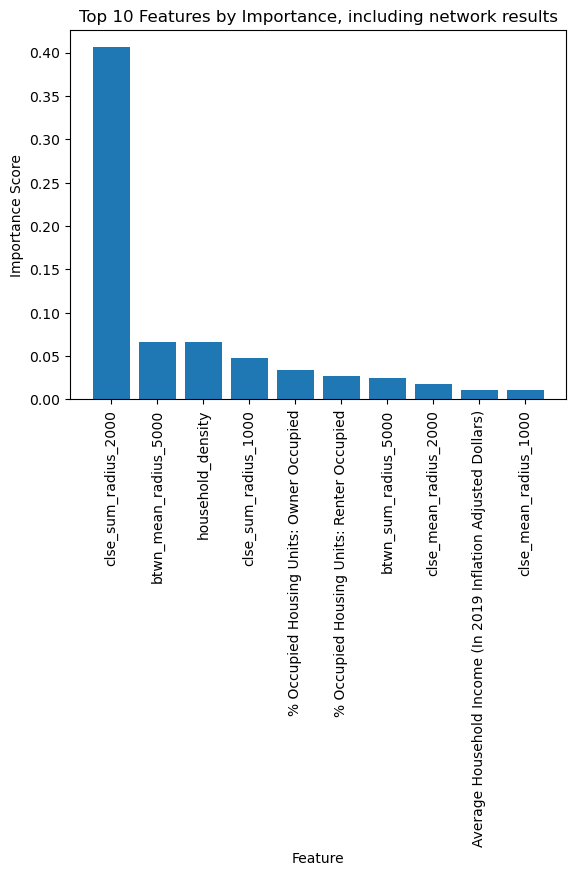

In [15]:
import numpy as np
# Clean Data
# zip is not included beacuse that's an index, not a calculated value

# Plot the second choropleth map on the second subplot
nyc_gdf['inverse_vehicle_use'] = 100 - nyc_gdf['PCT_ACS19_5yr_B08301002']
# # nyc_gdf['log_inverse_vehicle_use'] = np.log(nyc_gdf['inverse_vehicle_use'])

nyc_gdf['pop_density'] = nyc_gdf['ACS19_5yr_B01001001'] / nyc_gdf['Geo_AREALAND']
nyc_gdf['household_density'] = nyc_gdf['ACS19_5yr_B11001001'] / nyc_gdf['Geo_AREALAND']

# 'inverse_vehicle_use','log_inverse_vehicle_use',

df = nyc_gdf[['inverse_vehicle_use','pop_density','household_density',
              'PCT_SE_A09001_002', #: % Workers 16 Years and Over: Did Not Work At Home
              'PCT_SE_A10060_002', #: % Occupied Housing Units: Owner Occupied
              'PCT_SE_A10060_003', #: % Occupied Housing Units: Renter Occupied
              'PCT_SE_A10038_002', #: % Renter-Occupied Housing Units: Less than $300
              'PCT_SE_A10038_003', #: % Renter-Occupied Housing Units: $300 to $499
              'PCT_SE_A10038_004', #: % Renter-Occupied Housing Units: $500 to $799
              'PCT_SE_A10038_005', #: % Renter-Occupied Housing Units: $800 to $999
              'PCT_SE_A10038_006', #: % Renter-Occupied Housing Units: $1,000 to $1,499
              'PCT_SE_A10038_007', #: % Renter-Occupied Housing Units: $1,500 to $1,999
              'PCT_SE_A10038_008', #: % Renter-Occupied Housing Units: $2,000 to $2,499
              'PCT_SE_A10038_009', #: % Renter-Occupied Housing Units: $2,500 to $2,999
              'PCT_SE_A10038_010', #: % Renter-Occupied Housing Units: $3,000 or More
              'PCT_SE_A10038_011', #: % Renter-Occupied Housing Units: No Cash Rent
              # 'PCT_SE_A10054B_002', #: % Renter-Occupied Housing Units: No Vehicle Available
              # 'PCT_SE_A10054B_003', #: % Renter-Occupied Housing Units: 1 Vehicle Available
              # 'PCT_SE_A10054B_004', #: % Renter-Occupied Housing Units: 2 Vehicles Available
              # 'PCT_SE_A10054B_005', #: % Renter-Occupied Housing Units: 3 Vehicles Available
              # 'PCT_SE_A10054B_006', #: % Renter-Occupied Housing Units: 4 Vehicles Available
              # 'PCT_SE_A10054B_007', #: % Renter-Occupied Housing Units: 5 or More Vehicles Available
            #   'PCT_SE_A10030_002', #: % Occupied Housing Units: No Vehicle Available
            #   'PCT_SE_A10030_003', #: % Occupied Housing Units: 1 Vehicle Available
            #   'PCT_SE_A10030_004', #: % Occupied Housing Units: 2 Vehicles Available
            #   'PCT_SE_A10030_005', #: % Occupied Housing Units: 3 Vehicles Available
            #   'PCT_SE_A10030_006', #: % Occupied Housing Units: 4 Vehicles Available
            #   'PCT_SE_A10030_007', #: % Occupied Housing Units: 5 or More Vehicles Available
              'PCT_SE_A14001_002', #: % Households: Less than $10,000
              'PCT_SE_A14001_003', #: % Households: $10,000 to $14,999
              'PCT_SE_A14001_004', #: % Households: $15,000 to $19,999
              'PCT_SE_A14001_005', #: % Households: $20,000 to $24,999
              'PCT_SE_A14001_006', #: % Households: $25,000 to $29,999
              'PCT_SE_A14001_007', #: % Households: $30,000 to $34,999
              'PCT_SE_A14001_008', #: % Households: $35,000 to $39,999
              'PCT_SE_A14001_009', #: % Households: $40,000 to $44,999
              'PCT_SE_A14001_010', #: % Households: $45,000 to $49,999
              'PCT_SE_A14001_011', #: % Households: $50,000 to $59,999
              'PCT_SE_A14001_012', #: % Households: $60,000 to $74,999
              'PCT_SE_A14001_013', #: % Households: $75,000 to $99,999
              'PCT_SE_A14001_014', #: % Households: $100,000 to $124,999
              'PCT_SE_A14001_015', #: % Households: $125,000 to $149,999
              'PCT_SE_A14001_016', #: % Households: $150,000 to $199,999
              'PCT_SE_A14001_017', #: % Households: $200,000 or More
              'SE_A14008_001', #: Average Household Income (In 2019 Inflation Adjusted Dollars)
              'SE_A14024_001', #: Per Capita Income (In 2019 Inflation Adjusted Dollars)
              'PCT_SE_A13002_002', #: % Families: Income Below Poverty Level
            'clse_mean_radius_400',
            'clse_mean_radius_800',
            'clse_mean_radius_1000',
            'clse_mean_radius_2000',
            'clse_mean_radius_5000',
            'clse_mean_radius_7000',
            'clse_mean_radius_10000',
            'btwn_mean_radius_400',
            'btwn_mean_radius_800',
            'btwn_mean_radius_1000',
            'btwn_mean_radius_2000',
            'btwn_mean_radius_5000',
            'btwn_mean_radius_7000',
            'btwn_mean_radius_10000',
            'pgrk_mean_radius_400',
            'pgrk_mean_radius_800',
            'pgrk_mean_radius_1000',
            'pgrk_mean_radius_2000',
            'pgrk_mean_radius_5000',
            'pgrk_mean_radius_7000',
            'pgrk_mean_radius_10000',
            'clse_sum_radius_400',
            'clse_sum_radius_800',
            'clse_sum_radius_1000',
            'clse_sum_radius_2000',
            'clse_sum_radius_5000',
            'clse_sum_radius_7000',
            'clse_sum_radius_10000',
            'btwn_sum_radius_400',
            'btwn_sum_radius_800',
            'btwn_sum_radius_1000',
            'btwn_sum_radius_2000',
            'btwn_sum_radius_5000',
            'btwn_sum_radius_7000',
            'btwn_sum_radius_10000',
            'pgrk_sum_radius_400',
            'pgrk_sum_radius_800',
            'pgrk_sum_radius_1000',
            'pgrk_sum_radius_2000',
            'pgrk_sum_radius_5000',
            'pgrk_sum_radius_7000',
            'pgrk_sum_radius_10000',
            ]]


np.any(np.isnan(df))
np.all(np.isfinite(df))

df=df.dropna()

from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(df.drop('inverse_vehicle_use', axis=1), df['inverse_vehicle_use'], test_size=0.3, random_state=42)

# Create an instance of the RandomForestRegressor class
rf = RandomForestRegressor(n_estimators=150, random_state=42)

# Fit the model to the training data
rf.fit(X_train, y_train)

# Make predictions on the testing data
y_pred = rf.predict(X_test)

# Evaluate the performance of the model using mean absolute error and mean squared error
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)

print('Mean absolute error:', mae)
print('Mean squared error:', mse)

from sklearn.metrics import r2_score

# Calculate the R-squared value of the model on the testing data
r2 = r2_score(y_test, y_pred)

print('R-squared:', r2)

# Extract the feature importances
importances = rf.feature_importances_

# Create a list of tuples (feature name, importance score)
feature_importances = [(feature, importance) for feature, importance in zip(df.drop('inverse_vehicle_use', axis=1).columns, importances)]

# Sort the list by importance score in descending order
feature_importances = sorted(feature_importances, key=lambda x: x[1], reverse=True)

# Load the column names file
column_decode = pd.read_csv('./data/socialexplorer_nyc_blockgroup_data/column_names.csv', header=None)

# # Print the list of significant variables and their importance scores
# for feature, importance in feature_importances:
#     print(feature, column_decode.loc[feature], importance)

# If column_decode contains codes:
# Print the list of significant variables and their importance scores along with their definitions
for feature, importance in feature_importances:
    try:
        code = column_decode.loc[column_decode[1] == feature][1].values[0]
        definition = column_decode.loc[column_decode[1] == feature][0].values[0]
    except IndexError:
        code = feature
        definition = " --- "

    print(f"({importance}) {code}: {definition}")

### histogram

# Extract the feature names and importance scores, sort them in descending order, and select the top 10 results
top_features = sorted([(feature, importance) for feature, importance in feature_importances], key=lambda x: x[1], reverse=True)[:10]

# Extract the feature names and importance scores into separate lists, using human-readable labels if available
feature_names = []
for feature, _ in top_features:
  ## commented section would work if 'key' is set as the index
    # if feature in column_decode.index:
    #     feature_name = f"{column_decode.loc[feature, 0]} ({feature})"
    # else:
    #     feature_name = feature
    try:
        feature_name = column_decode.loc[column_decode[1] == feature][0].values[0]
    except IndexError:
        feature_name = feature
    feature_names.append(feature_name)

importance_scores = [importance for _, importance in top_features]

# Create a vertical bar chart of the top 10 features and their importance scores
plt.bar(feature_names, importance_scores)
plt.xlabel('Feature')
plt.ylabel('Importance Score')
plt.title('Top 10 Features by Importance, including network results')
plt.xticks(rotation=90)
plt.show()

### Same but xgboost

In [19]:
# %%capture
# %pip install xgboost


Mean absolute error: 8.013949144431951
Mean squared error: 114.91134912082367
R-squared: 0.7011320618734617
(0.19344298541545868) clse_sum_radius_2000:  --- 
(0.11973541229963303) btwn_sum_radius_2000:  --- 
(0.11292272061109543) btwn_sum_radius_1000:  --- 
(0.10678001493215561) clse_mean_radius_1000:  --- 
(0.05787580460309982) clse_sum_radius_5000:  --- 
(0.057060275226831436) btwn_sum_radius_5000:  --- 
(0.0229878481477499) clse_sum_radius_1000:  --- 
(0.017418259754776955) clse_mean_radius_2000:  --- 
(0.015767008066177368) PCT_SE_A10060_002: % Occupied Housing Units: Owner Occupied
(0.015187197364866734) clse_mean_radius_800:  --- 
(0.014531273394823074) pop_density:  --- 
(0.013598262332379818) clse_mean_radius_10000:  --- 
(0.013059280812740326) pgrk_sum_radius_1000:  --- 
(0.01241277251392603) PCT_SE_A10060_003: % Occupied Housing Units: Renter Occupied
(0.01130423042923212) clse_mean_radius_400:  --- 
(0.011027556844055653) btwn_mean_radius_10000:  --- 
(0.010929319076240063) 

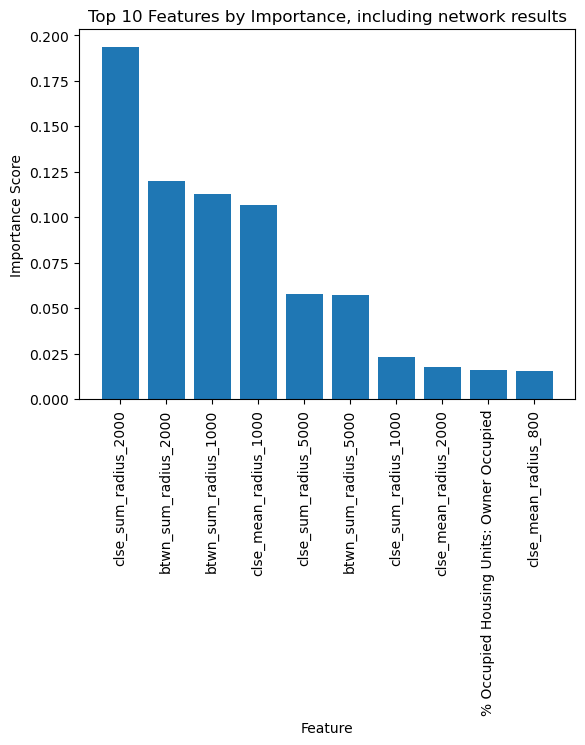

In [25]:
import numpy as np
import xgboost as xgb


# Clean Data
# zip is not included beacuse that's an index, not a calculated value

# Plot the second choropleth map on the second subplot
nyc_gdf['inverse_vehicle_use'] = 100 - nyc_gdf['PCT_ACS19_5yr_B08301002']
# # nyc_gdf['log_inverse_vehicle_use'] = np.log(nyc_gdf['inverse_vehicle_use'])

nyc_gdf['pop_density'] = nyc_gdf['ACS19_5yr_B01001001'] / nyc_gdf['Geo_AREALAND']
nyc_gdf['household_density'] = nyc_gdf['ACS19_5yr_B11001001'] / nyc_gdf['Geo_AREALAND']

# 'inverse_vehicle_use','log_inverse_vehicle_use',

df = nyc_gdf[['inverse_vehicle_use','pop_density','household_density',
              'PCT_SE_A09001_002', #: % Workers 16 Years and Over: Did Not Work At Home
              'PCT_SE_A10060_002', #: % Occupied Housing Units: Owner Occupied
              'PCT_SE_A10060_003', #: % Occupied Housing Units: Renter Occupied
              'PCT_SE_A10038_002', #: % Renter-Occupied Housing Units: Less than $300
              'PCT_SE_A10038_003', #: % Renter-Occupied Housing Units: $300 to $499
              'PCT_SE_A10038_004', #: % Renter-Occupied Housing Units: $500 to $799
              'PCT_SE_A10038_005', #: % Renter-Occupied Housing Units: $800 to $999
              'PCT_SE_A10038_006', #: % Renter-Occupied Housing Units: $1,000 to $1,499
              'PCT_SE_A10038_007', #: % Renter-Occupied Housing Units: $1,500 to $1,999
              'PCT_SE_A10038_008', #: % Renter-Occupied Housing Units: $2,000 to $2,499
              'PCT_SE_A10038_009', #: % Renter-Occupied Housing Units: $2,500 to $2,999
              'PCT_SE_A10038_010', #: % Renter-Occupied Housing Units: $3,000 or More
              'PCT_SE_A10038_011', #: % Renter-Occupied Housing Units: No Cash Rent
              # 'PCT_SE_A10054B_002', #: % Renter-Occupied Housing Units: No Vehicle Available
              # 'PCT_SE_A10054B_003', #: % Renter-Occupied Housing Units: 1 Vehicle Available
              # 'PCT_SE_A10054B_004', #: % Renter-Occupied Housing Units: 2 Vehicles Available
              # 'PCT_SE_A10054B_005', #: % Renter-Occupied Housing Units: 3 Vehicles Available
              # 'PCT_SE_A10054B_006', #: % Renter-Occupied Housing Units: 4 Vehicles Available
              # 'PCT_SE_A10054B_007', #: % Renter-Occupied Housing Units: 5 or More Vehicles Available
            #   'PCT_SE_A10030_002', #: % Occupied Housing Units: No Vehicle Available
            #   'PCT_SE_A10030_003', #: % Occupied Housing Units: 1 Vehicle Available
            #   'PCT_SE_A10030_004', #: % Occupied Housing Units: 2 Vehicles Available
            #   'PCT_SE_A10030_005', #: % Occupied Housing Units: 3 Vehicles Available
            #   'PCT_SE_A10030_006', #: % Occupied Housing Units: 4 Vehicles Available
            #   'PCT_SE_A10030_007', #: % Occupied Housing Units: 5 or More Vehicles Available
              'PCT_SE_A14001_002', #: % Households: Less than $10,000
              'PCT_SE_A14001_003', #: % Households: $10,000 to $14,999
              'PCT_SE_A14001_004', #: % Households: $15,000 to $19,999
              'PCT_SE_A14001_005', #: % Households: $20,000 to $24,999
              'PCT_SE_A14001_006', #: % Households: $25,000 to $29,999
              'PCT_SE_A14001_007', #: % Households: $30,000 to $34,999
              'PCT_SE_A14001_008', #: % Households: $35,000 to $39,999
              'PCT_SE_A14001_009', #: % Households: $40,000 to $44,999
              'PCT_SE_A14001_010', #: % Households: $45,000 to $49,999
              'PCT_SE_A14001_011', #: % Households: $50,000 to $59,999
              'PCT_SE_A14001_012', #: % Households: $60,000 to $74,999
              'PCT_SE_A14001_013', #: % Households: $75,000 to $99,999
              'PCT_SE_A14001_014', #: % Households: $100,000 to $124,999
              'PCT_SE_A14001_015', #: % Households: $125,000 to $149,999
              'PCT_SE_A14001_016', #: % Households: $150,000 to $199,999
              'PCT_SE_A14001_017', #: % Households: $200,000 or More
              'SE_A14008_001', #: Average Household Income (In 2019 Inflation Adjusted Dollars)
              'SE_A14024_001', #: Per Capita Income (In 2019 Inflation Adjusted Dollars)
              'PCT_SE_A13002_002', #: % Families: Income Below Poverty Level
            'clse_mean_radius_400',
            'clse_mean_radius_800',
            'clse_mean_radius_1000',
            'clse_mean_radius_2000',
            'clse_mean_radius_5000',
            'clse_mean_radius_7000',
            'clse_mean_radius_10000',
            'btwn_mean_radius_400',
            'btwn_mean_radius_800',
            'btwn_mean_radius_1000',
            'btwn_mean_radius_2000',
            'btwn_mean_radius_5000',
            'btwn_mean_radius_7000',
            'btwn_mean_radius_10000',
            'pgrk_mean_radius_400',
            'pgrk_mean_radius_800',
            'pgrk_mean_radius_1000',
            'pgrk_mean_radius_2000',
            'pgrk_mean_radius_5000',
            'pgrk_mean_radius_7000',
            'pgrk_mean_radius_10000',
            'clse_sum_radius_400',
            'clse_sum_radius_800',
            'clse_sum_radius_1000',
            'clse_sum_radius_2000',
            'clse_sum_radius_5000',
            'clse_sum_radius_7000',
            'clse_sum_radius_10000',
            'btwn_sum_radius_400',
            'btwn_sum_radius_800',
            'btwn_sum_radius_1000',
            'btwn_sum_radius_2000',
            'btwn_sum_radius_5000',
            'btwn_sum_radius_7000',
            'btwn_sum_radius_10000',
            'pgrk_sum_radius_400',
            'pgrk_sum_radius_800',
            'pgrk_sum_radius_1000',
            'pgrk_sum_radius_2000',
            'pgrk_sum_radius_5000',
            'pgrk_sum_radius_7000',
            'pgrk_sum_radius_10000',
            ]]


np.any(np.isnan(df))
np.all(np.isfinite(df))

df=df.dropna()

from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(df.drop('inverse_vehicle_use', axis=1), df['inverse_vehicle_use'], test_size=0.3, random_state=42)

# Create an instance of the RandomForestRegressor class
rf = xgb.XGBRegressor(objective='reg:squarederror', colsample_bytree=0.3, learning_rate=0.1,
                          max_depth=5, alpha=10, n_estimators=100)

# Fit the model to the training data
rf.fit(X_train, y_train)

# Make predictions on the testing data
y_pred = rf.predict(X_test)

# Evaluate the performance of the model using mean absolute error and mean squared error
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)

print('Mean absolute error:', mae)
print('Mean squared error:', mse)

from sklearn.metrics import r2_score

# Calculate the R-squared value of the model on the testing data
r2 = r2_score(y_test, y_pred)

print('R-squared:', r2)

# Extract the feature importances
importances = rf.feature_importances_

# Create a list of tuples (feature name, importance score)
feature_importances = [(feature, importance) for feature, importance in zip(df.drop('inverse_vehicle_use', axis=1).columns, importances)]

# Sort the list by importance score in descending order
feature_importances = sorted(feature_importances, key=lambda x: x[1], reverse=True)

# Load the column names file
column_decode = pd.read_csv('./data/socialexplorer_nyc_blockgroup_data/column_names.csv', header=None)

# # Print the list of significant variables and their importance scores
# for feature, importance in feature_importances:
#     print(feature, column_decode.loc[feature], importance)

# If column_decode contains codes:
# Print the list of significant variables and their importance scores along with their definitions
for feature, importance in feature_importances:
    try:
        code = column_decode.loc[column_decode[1] == feature][1].values[0]
        definition = column_decode.loc[column_decode[1] == feature][0].values[0]
    except IndexError:
        code = feature
        definition = " --- "

    print(f"({importance}) {code}: {definition}")

### histogram

# Extract the feature names and importance scores, sort them in descending order, and select the top 10 results
top_features = sorted([(feature, importance) for feature, importance in feature_importances], key=lambda x: x[1], reverse=True)[:10]

# Extract the feature names and importance scores into separate lists, using human-readable labels if available
feature_names = []
for feature, _ in top_features:
  ## commented section would work if 'key' is set as the index
    # if feature in column_decode.index:
    #     feature_name = f"{column_decode.loc[feature, 0]} ({feature})"
    # else:
    #     feature_name = feature
    try:
        feature_name = column_decode.loc[column_decode[1] == feature][0].values[0]
    except IndexError:
        feature_name = feature
    feature_names.append(feature_name)

importance_scores = [importance for _, importance in top_features]

# Create a vertical bar chart of the top 10 features and their importance scores
plt.bar(feature_names, importance_scores)
plt.xlabel('Feature')
plt.ylabel('Importance Score')
plt.title('Top 10 Features by Importance, including network results')
plt.xticks(rotation=90)
plt.show()

### Including Logs

In [13]:
nyc_gdf = append_log_columns(nyc_gdf, 'clse_mean_radius_400')
nyc_gdf = append_log_columns(nyc_gdf, 'clse_mean_radius_800')
nyc_gdf = append_log_columns(nyc_gdf, 'clse_mean_radius_1000')
nyc_gdf = append_log_columns(nyc_gdf, 'clse_mean_radius_2000')
nyc_gdf = append_log_columns(nyc_gdf, 'clse_mean_radius_5000')
nyc_gdf = append_log_columns(nyc_gdf, 'clse_mean_radius_7000')
nyc_gdf = append_log_columns(nyc_gdf, 'clse_mean_radius_10000')
nyc_gdf = append_log_columns(nyc_gdf, 'btwn_mean_radius_400')
nyc_gdf = append_log_columns(nyc_gdf, 'btwn_mean_radius_800')
nyc_gdf = append_log_columns(nyc_gdf, 'btwn_mean_radius_1000')
nyc_gdf = append_log_columns(nyc_gdf, 'btwn_mean_radius_2000')
nyc_gdf = append_log_columns(nyc_gdf, 'btwn_mean_radius_5000')
nyc_gdf = append_log_columns(nyc_gdf, 'btwn_mean_radius_7000')
nyc_gdf = append_log_columns(nyc_gdf, 'btwn_mean_radius_10000')
nyc_gdf = append_log_columns(nyc_gdf, 'pgrk_mean_radius_400')
nyc_gdf = append_log_columns(nyc_gdf, 'pgrk_mean_radius_800')
nyc_gdf = append_log_columns(nyc_gdf, 'pgrk_mean_radius_1000')
nyc_gdf = append_log_columns(nyc_gdf, 'pgrk_mean_radius_2000')
nyc_gdf = append_log_columns(nyc_gdf, 'pgrk_mean_radius_5000')
nyc_gdf = append_log_columns(nyc_gdf, 'pgrk_mean_radius_7000')
nyc_gdf = append_log_columns(nyc_gdf, 'pgrk_mean_radius_10000')
nyc_gdf = append_log_columns(nyc_gdf, 'clse_sum_radius_400')
nyc_gdf = append_log_columns(nyc_gdf, 'clse_sum_radius_800')
nyc_gdf = append_log_columns(nyc_gdf, 'clse_sum_radius_1000')
nyc_gdf = append_log_columns(nyc_gdf, 'clse_sum_radius_2000')
nyc_gdf = append_log_columns(nyc_gdf, 'clse_sum_radius_5000')
nyc_gdf = append_log_columns(nyc_gdf, 'clse_sum_radius_7000')
nyc_gdf = append_log_columns(nyc_gdf, 'clse_sum_radius_10000')
nyc_gdf = append_log_columns(nyc_gdf, 'btwn_sum_radius_400')
nyc_gdf = append_log_columns(nyc_gdf, 'btwn_sum_radius_800')
nyc_gdf = append_log_columns(nyc_gdf, 'btwn_sum_radius_1000')
nyc_gdf = append_log_columns(nyc_gdf, 'btwn_sum_radius_2000')
nyc_gdf = append_log_columns(nyc_gdf, 'btwn_sum_radius_5000')
nyc_gdf = append_log_columns(nyc_gdf, 'btwn_sum_radius_7000')
nyc_gdf = append_log_columns(nyc_gdf, 'btwn_sum_radius_10000')
nyc_gdf = append_log_columns(nyc_gdf, 'pgrk_sum_radius_400')
nyc_gdf = append_log_columns(nyc_gdf, 'pgrk_sum_radius_800')
nyc_gdf = append_log_columns(nyc_gdf, 'pgrk_sum_radius_1000')
nyc_gdf = append_log_columns(nyc_gdf, 'pgrk_sum_radius_2000')
nyc_gdf = append_log_columns(nyc_gdf, 'pgrk_sum_radius_5000')
nyc_gdf = append_log_columns(nyc_gdf, 'pgrk_sum_radius_7000')
nyc_gdf = append_log_columns(nyc_gdf, 'pgrk_sum_radius_10000')


Mean absolute error: 8.010584027381633
Mean squared error: 113.2899738553667
R-squared: 0.7053490263963217
(0.40586288125446374) log_clse_sum_radius_2000:  --- 
(0.06656500000403909) log_btwn_mean_radius_5000:  --- 
(0.06582092554595431) household_density:  --- 
(0.04832703567243191) log_clse_sum_radius_1000:  --- 
(0.030878061436223698) PCT_SE_A10060_002: % Occupied Housing Units: Owner Occupied
(0.02972764849850026) PCT_SE_A10060_003: % Occupied Housing Units: Renter Occupied
(0.024883303810725524) log_btwn_sum_radius_5000:  --- 
(0.01855982618497832) log_clse_mean_radius_2000:  --- 
(0.011472054756191815) SE_A14008_001: Average Household Income (In 2019 Inflation Adjusted Dollars)
(0.010920341425056764) pop_density:  --- 
(0.010881611784122818) log_clse_mean_radius_1000:  --- 
(0.010185429059868497) SE_A14024_001: Per Capita Income (In 2019 Inflation Adjusted Dollars)
(0.008210115663484702) log_pgrk_mean_radius_2000:  --- 
(0.008115496449423653) PCT_SE_A14001_014: % Households: $100

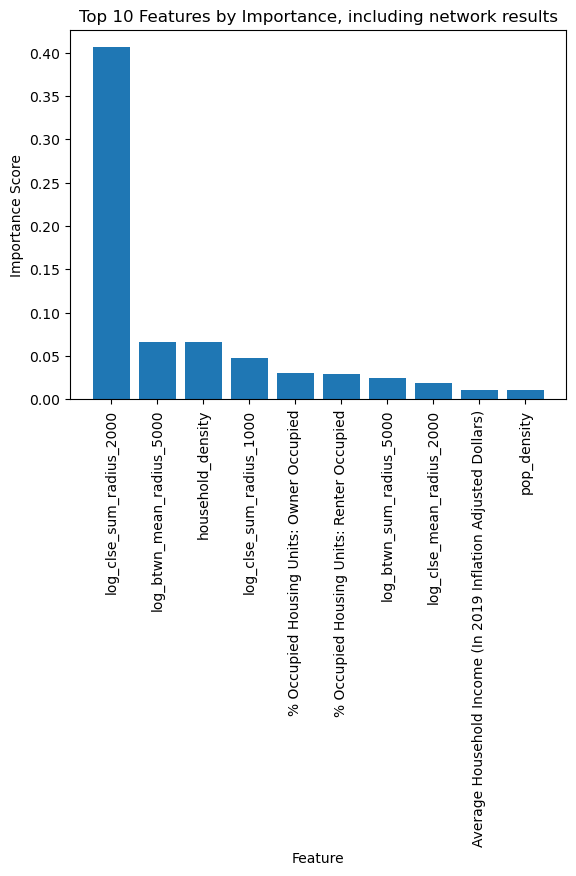

In [14]:
import numpy as np
# Clean Data
# zip is not included beacuse that's an index, not a calculated value

# Plot the second choropleth map on the second subplot
nyc_gdf['inverse_vehicle_use'] = 100 - nyc_gdf['PCT_ACS19_5yr_B08301002']
# # nyc_gdf['log_inverse_vehicle_use'] = np.log(nyc_gdf['inverse_vehicle_use'])

nyc_gdf['pop_density'] = nyc_gdf['ACS19_5yr_B01001001'] / nyc_gdf['Geo_AREALAND']
nyc_gdf['household_density'] = nyc_gdf['ACS19_5yr_B11001001'] / nyc_gdf['Geo_AREALAND']

# 'inverse_vehicle_use','log_inverse_vehicle_use',

df = nyc_gdf[['inverse_vehicle_use','pop_density','household_density',
              'PCT_SE_A09001_002', #: % Workers 16 Years and Over: Did Not Work At Home
              'PCT_SE_A10060_002', #: % Occupied Housing Units: Owner Occupied
              'PCT_SE_A10060_003', #: % Occupied Housing Units: Renter Occupied
              'PCT_SE_A10038_002', #: % Renter-Occupied Housing Units: Less than $300
              'PCT_SE_A10038_003', #: % Renter-Occupied Housing Units: $300 to $499
              'PCT_SE_A10038_004', #: % Renter-Occupied Housing Units: $500 to $799
              'PCT_SE_A10038_005', #: % Renter-Occupied Housing Units: $800 to $999
              'PCT_SE_A10038_006', #: % Renter-Occupied Housing Units: $1,000 to $1,499
              'PCT_SE_A10038_007', #: % Renter-Occupied Housing Units: $1,500 to $1,999
              'PCT_SE_A10038_008', #: % Renter-Occupied Housing Units: $2,000 to $2,499
              'PCT_SE_A10038_009', #: % Renter-Occupied Housing Units: $2,500 to $2,999
              'PCT_SE_A10038_010', #: % Renter-Occupied Housing Units: $3,000 or More
              'PCT_SE_A10038_011', #: % Renter-Occupied Housing Units: No Cash Rent
              # 'PCT_SE_A10054B_002', #: % Renter-Occupied Housing Units: No Vehicle Available
              # 'PCT_SE_A10054B_003', #: % Renter-Occupied Housing Units: 1 Vehicle Available
              # 'PCT_SE_A10054B_004', #: % Renter-Occupied Housing Units: 2 Vehicles Available
              # 'PCT_SE_A10054B_005', #: % Renter-Occupied Housing Units: 3 Vehicles Available
              # 'PCT_SE_A10054B_006', #: % Renter-Occupied Housing Units: 4 Vehicles Available
              # 'PCT_SE_A10054B_007', #: % Renter-Occupied Housing Units: 5 or More Vehicles Available
            #   'PCT_SE_A10030_002', #: % Occupied Housing Units: No Vehicle Available
            #   'PCT_SE_A10030_003', #: % Occupied Housing Units: 1 Vehicle Available
            #   'PCT_SE_A10030_004', #: % Occupied Housing Units: 2 Vehicles Available
            #   'PCT_SE_A10030_005', #: % Occupied Housing Units: 3 Vehicles Available
            #   'PCT_SE_A10030_006', #: % Occupied Housing Units: 4 Vehicles Available
            #   'PCT_SE_A10030_007', #: % Occupied Housing Units: 5 or More Vehicles Available
              'PCT_SE_A14001_002', #: % Households: Less than $10,000
              'PCT_SE_A14001_003', #: % Households: $10,000 to $14,999
              'PCT_SE_A14001_004', #: % Households: $15,000 to $19,999
              'PCT_SE_A14001_005', #: % Households: $20,000 to $24,999
              'PCT_SE_A14001_006', #: % Households: $25,000 to $29,999
              'PCT_SE_A14001_007', #: % Households: $30,000 to $34,999
              'PCT_SE_A14001_008', #: % Households: $35,000 to $39,999
              'PCT_SE_A14001_009', #: % Households: $40,000 to $44,999
              'PCT_SE_A14001_010', #: % Households: $45,000 to $49,999
              'PCT_SE_A14001_011', #: % Households: $50,000 to $59,999
              'PCT_SE_A14001_012', #: % Households: $60,000 to $74,999
              'PCT_SE_A14001_013', #: % Households: $75,000 to $99,999
              'PCT_SE_A14001_014', #: % Households: $100,000 to $124,999
              'PCT_SE_A14001_015', #: % Households: $125,000 to $149,999
              'PCT_SE_A14001_016', #: % Households: $150,000 to $199,999
              'PCT_SE_A14001_017', #: % Households: $200,000 or More
              'SE_A14008_001', #: Average Household Income (In 2019 Inflation Adjusted Dollars)
              'SE_A14024_001', #: Per Capita Income (In 2019 Inflation Adjusted Dollars)
              'PCT_SE_A13002_002', #: % Families: Income Below Poverty Level
            'log_clse_mean_radius_400',
            'log_clse_mean_radius_800',
            'log_clse_mean_radius_1000',
            'log_clse_mean_radius_2000',
            'log_clse_mean_radius_5000',
            'log_clse_mean_radius_7000',
            'log_clse_mean_radius_10000',
            'log_btwn_mean_radius_400',
            'log_btwn_mean_radius_800',
            'log_btwn_mean_radius_1000',
            'log_btwn_mean_radius_2000',
            'log_btwn_mean_radius_5000',
            'log_btwn_mean_radius_7000',
            'log_btwn_mean_radius_10000',
            'log_pgrk_mean_radius_400',
            'log_pgrk_mean_radius_800',
            'log_pgrk_mean_radius_1000',
            'log_pgrk_mean_radius_2000',
            'log_pgrk_mean_radius_5000',
            'log_pgrk_mean_radius_7000',
            'log_pgrk_mean_radius_10000',
            'log_clse_sum_radius_400',
            'log_clse_sum_radius_800',
            'log_clse_sum_radius_1000',
            'log_clse_sum_radius_2000',
            'log_clse_sum_radius_5000',
            'log_clse_sum_radius_7000',
            'log_clse_sum_radius_10000',
            'log_btwn_sum_radius_400',
            'log_btwn_sum_radius_800',
            'log_btwn_sum_radius_1000',
            'log_btwn_sum_radius_2000',
            'log_btwn_sum_radius_5000',
            'log_btwn_sum_radius_7000',
            'log_btwn_sum_radius_10000',
            'log_pgrk_sum_radius_400',
            'log_pgrk_sum_radius_800',
            'log_pgrk_sum_radius_1000',
            'log_pgrk_sum_radius_2000',
            'log_pgrk_sum_radius_5000',
            'log_pgrk_sum_radius_7000',
            'log_pgrk_sum_radius_10000',
            ]]


np.any(np.isnan(df))
np.all(np.isfinite(df))

df=df.dropna()

from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(df.drop('inverse_vehicle_use', axis=1), df['inverse_vehicle_use'], test_size=0.3, random_state=42)

# Create an instance of the RandomForestRegressor class
rf = RandomForestRegressor(n_estimators=150, random_state=42)

# Fit the model to the training data
rf.fit(X_train, y_train)

# Make predictions on the testing data
y_pred = rf.predict(X_test)

# Evaluate the performance of the model using mean absolute error and mean squared error
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)

print('Mean absolute error:', mae)
print('Mean squared error:', mse)

from sklearn.metrics import r2_score

# Calculate the R-squared value of the model on the testing data
r2 = r2_score(y_test, y_pred)

print('R-squared:', r2)

# Extract the feature importances
importances = rf.feature_importances_

# Create a list of tuples (feature name, importance score)
feature_importances = [(feature, importance) for feature, importance in zip(df.drop('inverse_vehicle_use', axis=1).columns, importances)]

# Sort the list by importance score in descending order
feature_importances = sorted(feature_importances, key=lambda x: x[1], reverse=True)

# Load the column names file
column_decode = pd.read_csv('./data/socialexplorer_nyc_blockgroup_data/column_names.csv', header=None)

# # Print the list of significant variables and their importance scores
# for feature, importance in feature_importances:
#     print(feature, column_decode.loc[feature], importance)

# If column_decode contains codes:
# Print the list of significant variables and their importance scores along with their definitions
for feature, importance in feature_importances:
    try:
        code = column_decode.loc[column_decode[1] == feature][1].values[0]
        definition = column_decode.loc[column_decode[1] == feature][0].values[0]
    except IndexError:
        code = feature
        definition = " --- "

    print(f"({importance}) {code}: {definition}")

### histogram

# Extract the feature names and importance scores, sort them in descending order, and select the top 10 results
top_features = sorted([(feature, importance) for feature, importance in feature_importances], key=lambda x: x[1], reverse=True)[:10]

# Extract the feature names and importance scores into separate lists, using human-readable labels if available
feature_names = []
for feature, _ in top_features:
  ## commented section would work if 'key' is set as the index
    # if feature in column_decode.index:
    #     feature_name = f"{column_decode.loc[feature, 0]} ({feature})"
    # else:
    #     feature_name = feature
    try:
        feature_name = column_decode.loc[column_decode[1] == feature][0].values[0]
    except IndexError:
        feature_name = feature
    feature_names.append(feature_name)

importance_scores = [importance for _, importance in top_features]

# Create a vertical bar chart of the top 10 features and their importance scores
plt.bar(feature_names, importance_scores)
plt.xlabel('Feature')
plt.ylabel('Importance Score')
plt.title('Top 10 Features by Importance, including network results')
plt.xticks(rotation=90)
plt.show()

### Everything including Log

Mean absolute error: 8.009065982125879
Mean squared error: 113.49072918491476
R-squared: 0.7048268905771098
(0.20584656270103097) clse_sum_radius_2000:  --- 
(0.20019472855822462) log_clse_sum_radius_2000:  --- 
(0.06558034074435357) household_density:  --- 
(0.03882004606186821) btwn_mean_radius_5000:  --- 
(0.03267764973462394) PCT_SE_A10060_002: % Occupied Housing Units: Owner Occupied
(0.02794335148853325) log_btwn_mean_radius_5000:  --- 
(0.027638336288902554) PCT_SE_A10060_003: % Occupied Housing Units: Renter Occupied
(0.026965078224455544) log_clse_sum_radius_1000:  --- 
(0.02145970979937933) clse_sum_radius_1000:  --- 
(0.014377398425704397) log_btwn_sum_radius_5000:  --- 
(0.011228970618787262) SE_A14008_001: Average Household Income (In 2019 Inflation Adjusted Dollars)
(0.010924646351483094) pop_density:  --- 
(0.010711863216273664) btwn_sum_radius_5000:  --- 
(0.010073786595141087) SE_A14024_001: Per Capita Income (In 2019 Inflation Adjusted Dollars)
(0.010072682549235065) 

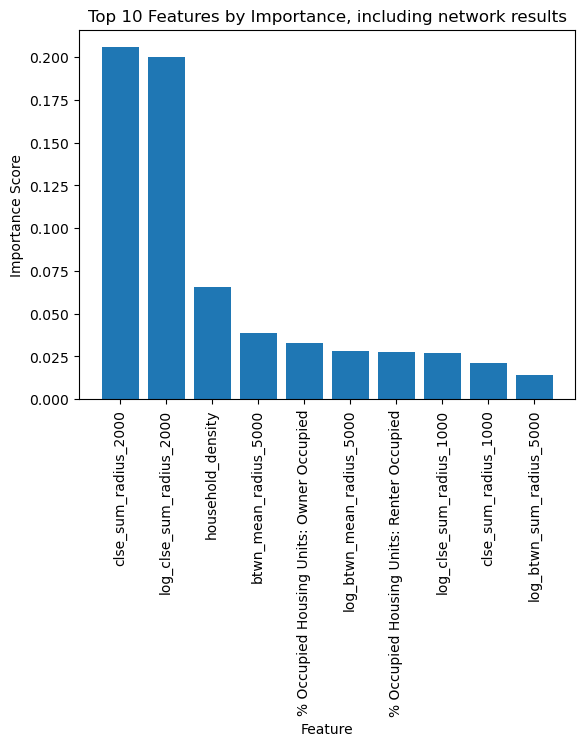

In [15]:
import numpy as np
# Clean Data
# zip is not included beacuse that's an index, not a calculated value

# Plot the second choropleth map on the second subplot
nyc_gdf['inverse_vehicle_use'] = 100 - nyc_gdf['PCT_ACS19_5yr_B08301002']
# # nyc_gdf['log_inverse_vehicle_use'] = np.log(nyc_gdf['inverse_vehicle_use'])

nyc_gdf['pop_density'] = nyc_gdf['ACS19_5yr_B01001001'] / nyc_gdf['Geo_AREALAND']
nyc_gdf['household_density'] = nyc_gdf['ACS19_5yr_B11001001'] / nyc_gdf['Geo_AREALAND']

# 'inverse_vehicle_use','log_inverse_vehicle_use',

df = nyc_gdf[['inverse_vehicle_use','pop_density','household_density',
              'PCT_SE_A09001_002', #: % Workers 16 Years and Over: Did Not Work At Home
              'PCT_SE_A10060_002', #: % Occupied Housing Units: Owner Occupied
              'PCT_SE_A10060_003', #: % Occupied Housing Units: Renter Occupied
              'PCT_SE_A10038_002', #: % Renter-Occupied Housing Units: Less than $300
              'PCT_SE_A10038_003', #: % Renter-Occupied Housing Units: $300 to $499
              'PCT_SE_A10038_004', #: % Renter-Occupied Housing Units: $500 to $799
              'PCT_SE_A10038_005', #: % Renter-Occupied Housing Units: $800 to $999
              'PCT_SE_A10038_006', #: % Renter-Occupied Housing Units: $1,000 to $1,499
              'PCT_SE_A10038_007', #: % Renter-Occupied Housing Units: $1,500 to $1,999
              'PCT_SE_A10038_008', #: % Renter-Occupied Housing Units: $2,000 to $2,499
              'PCT_SE_A10038_009', #: % Renter-Occupied Housing Units: $2,500 to $2,999
              'PCT_SE_A10038_010', #: % Renter-Occupied Housing Units: $3,000 or More
              'PCT_SE_A10038_011', #: % Renter-Occupied Housing Units: No Cash Rent
              # 'PCT_SE_A10054B_002', #: % Renter-Occupied Housing Units: No Vehicle Available
              # 'PCT_SE_A10054B_003', #: % Renter-Occupied Housing Units: 1 Vehicle Available
              # 'PCT_SE_A10054B_004', #: % Renter-Occupied Housing Units: 2 Vehicles Available
              # 'PCT_SE_A10054B_005', #: % Renter-Occupied Housing Units: 3 Vehicles Available
              # 'PCT_SE_A10054B_006', #: % Renter-Occupied Housing Units: 4 Vehicles Available
              # 'PCT_SE_A10054B_007', #: % Renter-Occupied Housing Units: 5 or More Vehicles Available
            #   'PCT_SE_A10030_002', #: % Occupied Housing Units: No Vehicle Available
            #   'PCT_SE_A10030_003', #: % Occupied Housing Units: 1 Vehicle Available
            #   'PCT_SE_A10030_004', #: % Occupied Housing Units: 2 Vehicles Available
            #   'PCT_SE_A10030_005', #: % Occupied Housing Units: 3 Vehicles Available
            #   'PCT_SE_A10030_006', #: % Occupied Housing Units: 4 Vehicles Available
            #   'PCT_SE_A10030_007', #: % Occupied Housing Units: 5 or More Vehicles Available
              'PCT_SE_A14001_002', #: % Households: Less than $10,000
              'PCT_SE_A14001_003', #: % Households: $10,000 to $14,999
              'PCT_SE_A14001_004', #: % Households: $15,000 to $19,999
              'PCT_SE_A14001_005', #: % Households: $20,000 to $24,999
              'PCT_SE_A14001_006', #: % Households: $25,000 to $29,999
              'PCT_SE_A14001_007', #: % Households: $30,000 to $34,999
              'PCT_SE_A14001_008', #: % Households: $35,000 to $39,999
              'PCT_SE_A14001_009', #: % Households: $40,000 to $44,999
              'PCT_SE_A14001_010', #: % Households: $45,000 to $49,999
              'PCT_SE_A14001_011', #: % Households: $50,000 to $59,999
              'PCT_SE_A14001_012', #: % Households: $60,000 to $74,999
              'PCT_SE_A14001_013', #: % Households: $75,000 to $99,999
              'PCT_SE_A14001_014', #: % Households: $100,000 to $124,999
              'PCT_SE_A14001_015', #: % Households: $125,000 to $149,999
              'PCT_SE_A14001_016', #: % Households: $150,000 to $199,999
              'PCT_SE_A14001_017', #: % Households: $200,000 or More
              'SE_A14008_001', #: Average Household Income (In 2019 Inflation Adjusted Dollars)
              'SE_A14024_001', #: Per Capita Income (In 2019 Inflation Adjusted Dollars)
              'PCT_SE_A13002_002', #: % Families: Income Below Poverty Level
            'clse_mean_radius_400',
            'clse_mean_radius_800',
            'clse_mean_radius_1000',
            'clse_mean_radius_2000',
            'clse_mean_radius_5000',
            'clse_mean_radius_7000',
            'clse_mean_radius_10000',
            'btwn_mean_radius_400',
            'btwn_mean_radius_800',
            'btwn_mean_radius_1000',
            'btwn_mean_radius_2000',
            'btwn_mean_radius_5000',
            'btwn_mean_radius_7000',
            'btwn_mean_radius_10000',
            'pgrk_mean_radius_400',
            'pgrk_mean_radius_800',
            'pgrk_mean_radius_1000',
            'pgrk_mean_radius_2000',
            'pgrk_mean_radius_5000',
            'pgrk_mean_radius_7000',
            'pgrk_mean_radius_10000',
            'clse_sum_radius_400',
            'clse_sum_radius_800',
            'clse_sum_radius_1000',
            'clse_sum_radius_2000',
            'clse_sum_radius_5000',
            'clse_sum_radius_7000',
            'clse_sum_radius_10000',
            'btwn_sum_radius_400',
            'btwn_sum_radius_800',
            'btwn_sum_radius_1000',
            'btwn_sum_radius_2000',
            'btwn_sum_radius_5000',
            'btwn_sum_radius_7000',
            'btwn_sum_radius_10000',
            'pgrk_sum_radius_400',
            'pgrk_sum_radius_800',
            'pgrk_sum_radius_1000',
            'pgrk_sum_radius_2000',
            'pgrk_sum_radius_5000',
            'pgrk_sum_radius_7000',
            'pgrk_sum_radius_10000',
            'log_clse_mean_radius_400',
            'log_clse_mean_radius_800',
            'log_clse_mean_radius_1000',
            'log_clse_mean_radius_2000',
            'log_clse_mean_radius_5000',
            'log_clse_mean_radius_7000',
            'log_clse_mean_radius_10000',
            'log_btwn_mean_radius_400',
            'log_btwn_mean_radius_800',
            'log_btwn_mean_radius_1000',
            'log_btwn_mean_radius_2000',
            'log_btwn_mean_radius_5000',
            'log_btwn_mean_radius_7000',
            'log_btwn_mean_radius_10000',
            'log_pgrk_mean_radius_400',
            'log_pgrk_mean_radius_800',
            'log_pgrk_mean_radius_1000',
            'log_pgrk_mean_radius_2000',
            'log_pgrk_mean_radius_5000',
            'log_pgrk_mean_radius_7000',
            'log_pgrk_mean_radius_10000',
            'log_clse_sum_radius_400',
            'log_clse_sum_radius_800',
            'log_clse_sum_radius_1000',
            'log_clse_sum_radius_2000',
            'log_clse_sum_radius_5000',
            'log_clse_sum_radius_7000',
            'log_clse_sum_radius_10000',
            'log_btwn_sum_radius_400',
            'log_btwn_sum_radius_800',
            'log_btwn_sum_radius_1000',
            'log_btwn_sum_radius_2000',
            'log_btwn_sum_radius_5000',
            'log_btwn_sum_radius_7000',
            'log_btwn_sum_radius_10000',
            'log_pgrk_sum_radius_400',
            'log_pgrk_sum_radius_800',
            'log_pgrk_sum_radius_1000',
            'log_pgrk_sum_radius_2000',
            'log_pgrk_sum_radius_5000',
            'log_pgrk_sum_radius_7000',
            'log_pgrk_sum_radius_10000',
            ]]


np.any(np.isnan(df))
np.all(np.isfinite(df))

df=df.dropna()

from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(df.drop('inverse_vehicle_use', axis=1), df['inverse_vehicle_use'], test_size=0.3, random_state=42)

# Create an instance of the RandomForestRegressor class
rf = RandomForestRegressor(n_estimators=150, random_state=42)

# Fit the model to the training data
rf.fit(X_train, y_train)

# Make predictions on the testing data
y_pred = rf.predict(X_test)

# Evaluate the performance of the model using mean absolute error and mean squared error
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)

print('Mean absolute error:', mae)
print('Mean squared error:', mse)

from sklearn.metrics import r2_score

# Calculate the R-squared value of the model on the testing data
r2 = r2_score(y_test, y_pred)

print('R-squared:', r2)

# Extract the feature importances
importances = rf.feature_importances_

# Create a list of tuples (feature name, importance score)
feature_importances = [(feature, importance) for feature, importance in zip(df.drop('inverse_vehicle_use', axis=1).columns, importances)]

# Sort the list by importance score in descending order
feature_importances = sorted(feature_importances, key=lambda x: x[1], reverse=True)

# Load the column names file
column_decode = pd.read_csv('./data/socialexplorer_nyc_blockgroup_data/column_names.csv', header=None)

# # Print the list of significant variables and their importance scores
# for feature, importance in feature_importances:
#     print(feature, column_decode.loc[feature], importance)

# If column_decode contains codes:
# Print the list of significant variables and their importance scores along with their definitions
for feature, importance in feature_importances:
    try:
        code = column_decode.loc[column_decode[1] == feature][1].values[0]
        definition = column_decode.loc[column_decode[1] == feature][0].values[0]
    except IndexError:
        code = feature
        definition = " --- "

    print(f"({importance}) {code}: {definition}")

### histogram

# Extract the feature names and importance scores, sort them in descending order, and select the top 10 results
top_features = sorted([(feature, importance) for feature, importance in feature_importances], key=lambda x: x[1], reverse=True)[:10]

# Extract the feature names and importance scores into separate lists, using human-readable labels if available
feature_names = []
for feature, _ in top_features:
  ## commented section would work if 'key' is set as the index
    # if feature in column_decode.index:
    #     feature_name = f"{column_decode.loc[feature, 0]} ({feature})"
    # else:
    #     feature_name = feature
    try:
        feature_name = column_decode.loc[column_decode[1] == feature][0].values[0]
    except IndexError:
        feature_name = feature
    feature_names.append(feature_name)

importance_scores = [importance for _, importance in top_features]

# Create a vertical bar chart of the top 10 features and their importance scores
plt.bar(feature_names, importance_scores)
plt.xlabel('Feature')
plt.ylabel('Importance Score')
plt.title('Top 10 Features by Importance, including network results')
plt.xticks(rotation=90)
plt.show()

# Scatter plot

In [5]:
import numpy as np
import matplotlib.pyplot as plt

# Clean Data
# zip is not included beacuse that's an index, not a calculated value

# Select only the applicable variables for the scatter plot
df = nyc_gdf[['inverse_vehicle_use', 'pop_density', 'household_density', 'PCT_SE_A09001_002', 
              'PCT_SE_A10060_002', 'PCT_SE_A10060_003', 'PCT_SE_A10038_002', 'PCT_SE_A10038_003',
              'PCT_SE_A10038_004', 'PCT_SE_A10038_005', 'PCT_SE_A10038_006', 'PCT_SE_A10038_007',
              'PCT_SE_A10038_008', 'PCT_SE_A10038_009', 'PCT_SE_A10038_010', 'PCT_SE_A10038_011',
              'PCT_SE_A14001_002', 'PCT_SE_A14001_003', 'PCT_SE_A14001_004', 'PCT_SE_A14001_005',
              'PCT_SE_A14001_006', 'PCT_SE_A14001_007', 'PCT_SE_A14001_008', 'PCT_SE_A14001_009',
              'PCT_SE_A14001_010', 'PCT_SE_A14001_011', 'PCT_SE_A14001_012', 'PCT_SE_A14001_013',
              'PCT_SE_A14001_014', 'PCT_SE_A14001_015', 'PCT_SE_A14001_016', 'PCT_SE_A14001_017',
              'SE_A14008_001', 'SE_A14024_001', 'PCT_SE_A13002_002']]

# Drop rows with missing values
df = df.dropna()

# Create scatter plots for all pairs of variables
fig, axs = plt.subplots(nrows=df.shape[1]-1, ncols=df.shape[1]-1, figsize=(20, 20))
for i in range(df.shape[1]-1):
    for j in range(df.shape[1]-1):
        if i != j:
            axs[i, j].scatter(df.iloc[:, j+1], df.iloc[:, i], s=1, alpha=0.5)
            axs[i, j].set_xlabel(df.columns[j+1])
            axs[i, j].set_ylabel(df.columns[i])
plt.tight_layout()
plt.show()


C:\Users\cjong\AppData\Local\Temp\ipykernel_31276\1825365234.py:29: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()


KeyboardInterrupt: 

C:\Users\cjong\AppData\Local\Temp\ipykernel_31276\3846529632.py:64: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()


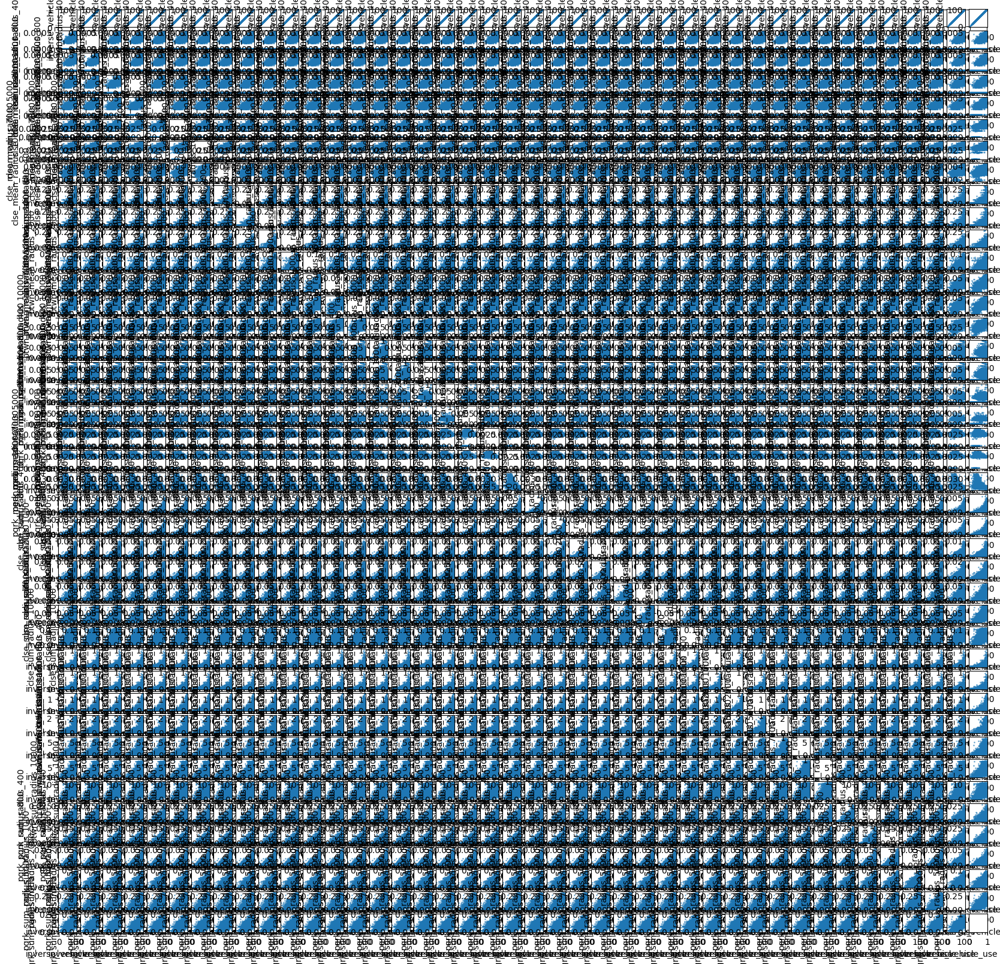

In [7]:
import numpy as np
import matplotlib.pyplot as plt

# Clean Data
# zip is not included beacuse that's an index, not a calculated value

# Select only the applicable variables for the scatter plot
df = nyc_gdf[['inverse_vehicle_use',
            'clse_mean_radius_400',
            'clse_mean_radius_800',
            'clse_mean_radius_1000',
            'clse_mean_radius_2000',
            'clse_mean_radius_5000',
            'clse_mean_radius_7000',
            'clse_mean_radius_10000',
            'btwn_mean_radius_400',
            'btwn_mean_radius_800',
            'btwn_mean_radius_1000',
            'btwn_mean_radius_2000',
            'btwn_mean_radius_5000',
            'btwn_mean_radius_7000',
            'btwn_mean_radius_10000',
            'pgrk_mean_radius_400',
            'pgrk_mean_radius_800',
            'pgrk_mean_radius_1000',
            'pgrk_mean_radius_2000',
            'pgrk_mean_radius_5000',
            'pgrk_mean_radius_7000',
            'pgrk_mean_radius_10000',
            'clse_sum_radius_400',
            'clse_sum_radius_800',
            'clse_sum_radius_1000',
            'clse_sum_radius_2000',
            'clse_sum_radius_5000',
            'clse_sum_radius_7000',
            'clse_sum_radius_10000',
            'btwn_sum_radius_400',
            'btwn_sum_radius_800',
            'btwn_sum_radius_1000',
            'btwn_sum_radius_2000',
            'btwn_sum_radius_5000',
            'btwn_sum_radius_7000',
            'btwn_sum_radius_10000',
            'pgrk_sum_radius_400',
            'pgrk_sum_radius_800',
            'pgrk_sum_radius_1000',
            'pgrk_sum_radius_2000',
            'pgrk_sum_radius_5000',
            'pgrk_sum_radius_7000',
            'pgrk_sum_radius_10000',]]

# Drop rows with missing values
df = df.dropna()

# Create scatter plots for all pairs of variables
fig, axs = plt.subplots(nrows=df.shape[1]-1, ncols=df.shape[1]-1, figsize=(20, 20))
for i in range(df.shape[1]-1):
    for j in range(df.shape[1]-1):
        if i != j:
            axs[i, j].scatter(df['inverse_vehicle_use'], df.iloc[:, i], s=1, alpha=0.5)
            axs[i, j].set_xlabel('inverse_vehicle_use')
            axs[i, j].set_ylabel(df.columns[i])

plt.tight_layout()
plt.show()


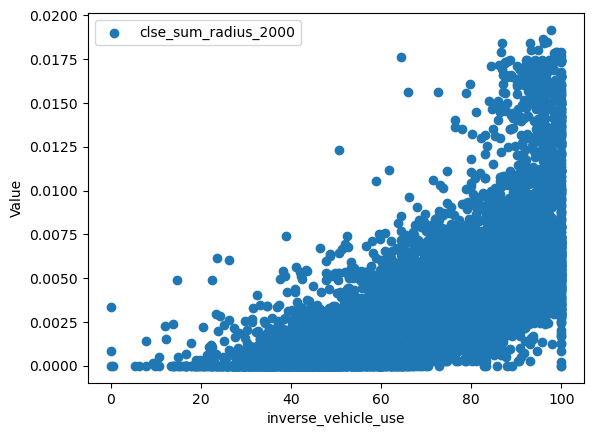

In [16]:
import numpy as np
import matplotlib.pyplot as plt

# Clean Data
# zip is not included beacuse that's an index, not a calculated value

# Select only the applicable variables for the scatter plot
df = nyc_gdf[[
    'inverse_vehicle_use',
            'clse_sum_radius_2000',]]
# Set the x variable
x_var = 'inverse_vehicle_use'

# Iterate through the y variables and plot each one against x
for y_var in df.columns:
    if y_var != x_var: # skip the x variable
        plt.scatter(df[x_var], df[y_var], label=y_var)

# Add labels and legend
plt.xlabel(x_var)
plt.ylabel('Value')
plt.legend()
plt.show()


### asdf

In [ ]:
import numpy as np
# Clean Data
# zip is not included beacuse that's an index, not a calculated value

# Plot the second choropleth map on the second subplot
nyc_gdf['inverse_vehicle_use'] = 100 - nyc_gdf['PCT_ACS19_5yr_B08301002']
# # nyc_gdf['log_inverse_vehicle_use'] = np.log(nyc_gdf['inverse_vehicle_use'])

nyc_gdf['pop_density'] = nyc_gdf['ACS19_5yr_B01001001'] / nyc_gdf['Geo_AREALAND']
nyc_gdf['household_density'] = nyc_gdf['ACS19_5yr_B11001001'] / nyc_gdf['Geo_AREALAND']

# 'inverse_vehicle_use','log_inverse_vehicle_use',

df = nyc_gdf[[
            'inverse_vehicle_use','pop_density','household_density',
            'PCT_ACS19_5yr_B08134011',
            'PCT_ACS19_5yr_B08134061',
            'PCT_ACS19_5yr_B08134082',
            'PCT_ACS19_5yr_B08134083',
            'PCT_ACS19_5yr_B08134084',
            'PCT_ACS19_5yr_B08134085',
            'PCT_ACS19_5yr_B08134086',
            'PCT_ACS19_5yr_B08134087',
            'PCT_ACS19_5yr_B08134088',
            'PCT_ACS19_5yr_B08134089',
            'PCT_ACS19_5yr_B08134090',
            'PCT_ACS19_5yr_B08134091',
            'ACS19_5yr_B08301021',
            'PCT_ACS19_5yr_B08301012',
            'PCT_ACS19_5yr_B08301014',
            'PCT_ACS19_5yr_B08301021',
            'PCT_ACS19_5yr_B08134081',
            'clse_mean_radius_500',
            'clse_mean_radius_800',
            'clse_mean_radius_1000',
            'clse_mean_radius_2000',
            'clse_mean_radius_5000',
            'clse_mean_radius_7000',
            'clse_mean_radius_10000',
            'btwn_mean_radius_500',
            'btwn_mean_radius_800',
            'btwn_mean_radius_1000',
            'btwn_mean_radius_2000',
            'btwn_mean_radius_5000',
            'btwn_mean_radius_7000',
            'btwn_mean_radius_10000',
            'pgrk_mean_radius_500',
            'pgrk_mean_radius_800',
            'pgrk_mean_radius_1000',
            'pgrk_mean_radius_2000',
            'pgrk_mean_radius_5000',
            'pgrk_mean_radius_7000',
            'pgrk_mean_radius_10000',
            'clse_sum_radius_500',
            'clse_sum_radius_800',
            'clse_sum_radius_1000',
            'clse_sum_radius_2000',
            'clse_sum_radius_5000',
            'clse_sum_radius_7000',
            'clse_sum_radius_10000',
            'btwn_sum_radius_500',
            'btwn_sum_radius_800',
            'btwn_sum_radius_1000',
            'btwn_sum_radius_2000',
            'btwn_sum_radius_5000',
            'btwn_sum_radius_7000',
            'btwn_sum_radius_10000',
            'pgrk_sum_radius_500',
            'pgrk_sum_radius_800',
            'pgrk_sum_radius_1000',
            'pgrk_sum_radius_2000',
            'pgrk_sum_radius_5000',
            'pgrk_sum_radius_7000',
            'pgrk_sum_radius_10000',
            ]]

np.any(np.isnan(df))
np.all(np.isfinite(df))

df=df.dropna()

from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(df.drop('inverse_vehicle_use', axis=1), df['inverse_vehicle_use'], test_size=0.3, random_state=42)

# Create an instance of the RandomForestRegressor class
rf = RandomForestRegressor(n_estimators=100, random_state=42)

# Fit the model to the training data
rf.fit(X_train, y_train)

# Make predictions on the testing data
y_pred = rf.predict(X_test)

# Evaluate the performance of the model using mean absolute error and mean squared error
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)

print('Mean absolute error:', mae)
print('Mean squared error:', mse)

# Extract the feature importances
importances = rf.feature_importances_

# Create a list of tuples (feature name, importance score)
feature_importances = [(feature, importance) for feature, importance in zip(df.drop('inverse_vehicle_use', axis=1).columns, importances)]

# Sort the list by importance score in descending order
feature_importances = sorted(feature_importances, key=lambda x: x[1], reverse=True)

# Load the column names file
column_decode = pd.read_csv('./data/socialexplorer_nyc_blockgroup_data/column_names.csv', header=None)

# # Print the list of significant variables and their importance scores
# for feature, importance in feature_importances:
#     print(feature, column_decode.loc[feature], importance)

# If column_decode contains codes:
# Print the list of significant variables and their importance scores along with their definitions
for feature, importance in feature_importances:
    try:
        code = column_decode.loc[column_decode[1] == feature][1].values[0]
        definition = column_decode.loc[column_decode[1] == feature][0].values[0]
    except IndexError:
        code = feature
        definition = " --- "

    print(f"({importance}) {code}: {definition}")

Mean absolute error: 0.20507856726849277
Mean squared error: 0.2736093618112984
(0.995591968688828) PCT_ACS19_5yr_B08134011: % Total: Car Truck Or Van
(0.0032871133477163136) PCT_ACS19_5yr_B08301021: % Total: Worked From Home
(0.0004174178286666844) ACS19_5yr_B08301021: Total: Worked From Home
(0.000178787532791114) PCT_ACS19_5yr_B08134061: % Total: Public Transportation (Excluding Taxicab)
(3.321922371385131e-05) pgrk_mean_radius_2000:  --- 
(3.217108142505193e-05) PCT_ACS19_5yr_B08134089: % Total:  Subway Or Elevated Rail Light Rail Streetcar Or Trolley (Carro Público In Puerto Rico): 45 To 59 Minutes
(2.2282440901140888e-05) PCT_ACS19_5yr_B08134090: % Total:  Subway Or Elevated Rail Light Rail Streetcar Or Trolley (Carro Público In Puerto Rico): 60 Or More Minutes
(2.2047873590011e-05) PCT_ACS19_5yr_B08301012: % Total: Public Transportation (Excluding Taxicab): Subway Or Elevated Rail
(1.8493750955221388e-05) pgrk_mean_radius_10000:  --- 
(1.8019361731086628e-05) pgrk_mean_radius_70

### FIltered datasets to only use US Census data

In [ ]:
import numpy as np
# Clean Data
# zip is not included beacuse that's an index, not a calculated value

df = nyc_gdf.loc[:, :'PCT_SE_A17005_003']
df['inverse_vehicle_use'] = 100 - nyc_gdf['PCT_ACS19_5yr_B08301002']

np.any(np.isnan(df))
np.all(np.isfinite(df))

df=df.dropna()

from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(df.drop('inverse_vehicle_use', axis=1), df['inverse_vehicle_use'], test_size=0.3, random_state=42)

# Create an instance of the RandomForestRegressor class
rf = RandomForestRegressor(n_estimators=100, random_state=42)

# Fit the model to the training data
rf.fit(X_train, y_train)

# Make predictions on the testing data
y_pred = rf.predict(X_test)

# Evaluate the performance of the model using mean absolute error and mean squared error
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)

print('Mean absolute error:', mae)
print('Mean squared error:', mse)

from sklearn.metrics import r2_score

# Calculate the R-squared value of the model on the testing data
r2 = r2_score(y_test, y_pred)

print('R-squared:', r2)

# Extract the feature importances
importances = rf.feature_importances_

# Create a list of tuples (feature name, importance score)
feature_importances = [(feature, importance) for feature, importance in zip(df.drop('inverse_vehicle_use', axis=1).columns, importances)]

# Load the column names file
column_decode = pd.read_csv('./data/socialexplorer_nyc_blockgroup_data/column_names.csv', header=None)

# # Print the list of significant variables and their importance scores
# for feature, importance in feature_importances:
#     print(feature, column_decode.loc[feature], importance)

# Sort the list by importance score in descending order
feature_importances = sorted(feature_importances, key=lambda x: x[1], reverse=True)

# If column_decode contains codes:
# Print the list of significant variables and their importance scores along with their definitions
for feature, importance in feature_importances:
    try:
        code = column_decode.loc[column_decode[1] == feature][1].values[0]
        definition = column_decode.loc[column_decode[1] == feature][0].values[0]
    except IndexError:
        code = feature
        definition = " --- "

    print(f"({importance}) {code}: {definition}")

Mean absolute error: 0.02833808969132057
Mean squared error: 0.006818738491555005
R-squared: 0.9999819672001098
(0.5460319630218179) PCT_ACS19_5yr_B08301002: % Total: Car Truck Or Van
(0.45369607560219344) PCT_SE_A09005_002: % Workers 16 Years and Over: Car, Truck, or Van
(5.725699237640427e-05) PCT_ACS19_5yr_B08134011: % Total: Car Truck Or Van
(8.703443052432987e-06) PCT_SE_A02002_008: % Total Population: Male: 25 to 34 Years
(8.491336203866593e-06) PCT_SE_A09005_009: % Workers 16 Years and Over: Drove Alone
(8.297137926168488e-06) PCT_SE_A10042B_003: % Renter-Occupied Housing Units: 1 Bedroom
(8.007215888701645e-06) PCT_SE_A10052_003: % Occupied Housing Units: 2 Rooms
(6.68563669481721e-06) PCT_SE_A10060_003: % Occupied Housing Units: Renter Occupied
(5.612298032782848e-06) PCT_ACS19_5yr_B01001049: % Total: Female: 85 Years And Over
(5.527267277415401e-06) PCT_ACS19_5yr_B08134021: % Total: Car Truck Or Van: Drove Alone
(5.3189143837211446e-06) PCT_SE_A01001_002: % Total Population: 

### Filtered datasets to only use network significance

<AxesSubplot: ylabel='cluster'>

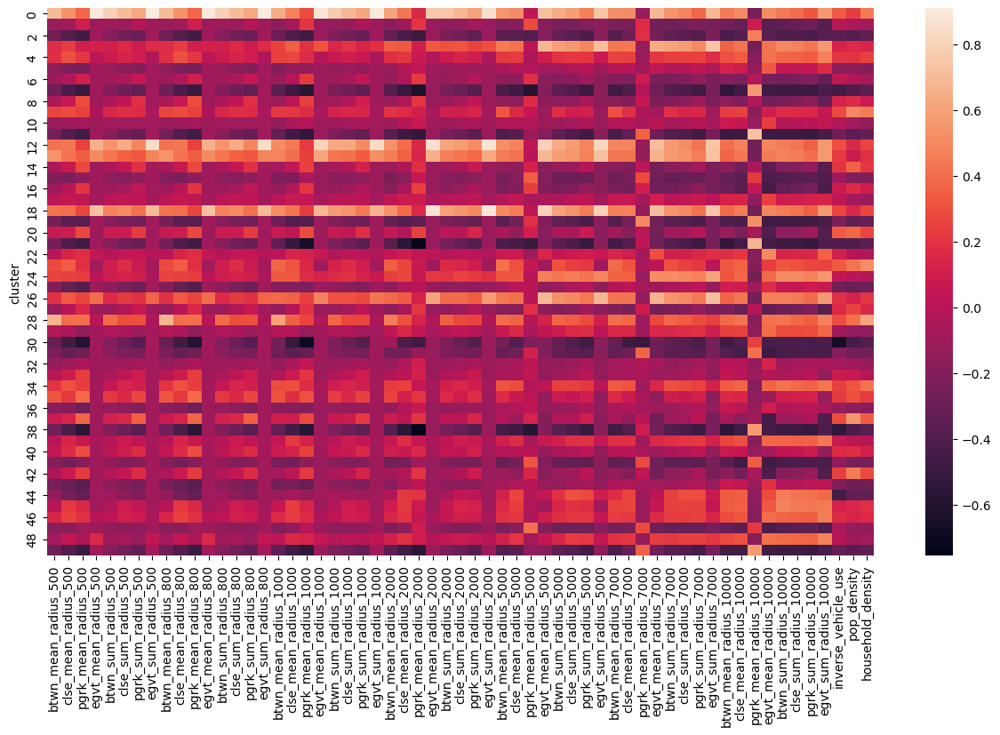

In [ ]:
import numpy as np
import seaborn as sns
from sklearn.cluster import KMeans

# Clean Data
# zip is not included beacuse that's an index, not a calculated value
            
df = nyc_gdf.loc[:, 'btwn_mean_radius_500':]
df['inverse_vehicle_use'] = 100 - nyc_gdf['PCT_ACS19_5yr_B08301002']

np.any(np.isnan(df))
np.all(np.isfinite(df))

df=df.dropna()

number_of_cluters = 50
kmeans = KMeans(n_clusters=number_of_cluters, n_init=100) # default is 10

y_kmeans = kmeans.fit_predict(df)
df['cluster'] = kmeans.labels_

df = df.groupby('cluster').mean() #cluster means

plt.figure(figsize=(15, 8))

df_norm = (df - df.mean()) / (df.max() - df.min())
sns.heatmap(df_norm)

C:\Users\cjong\AppData\Local\Temp\ipykernel_18444\1569092467.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['inverse_vehicle_use'] = 100 - nyc_gdf['PCT_ACS19_5yr_B08301002']


<AxesSubplot: >

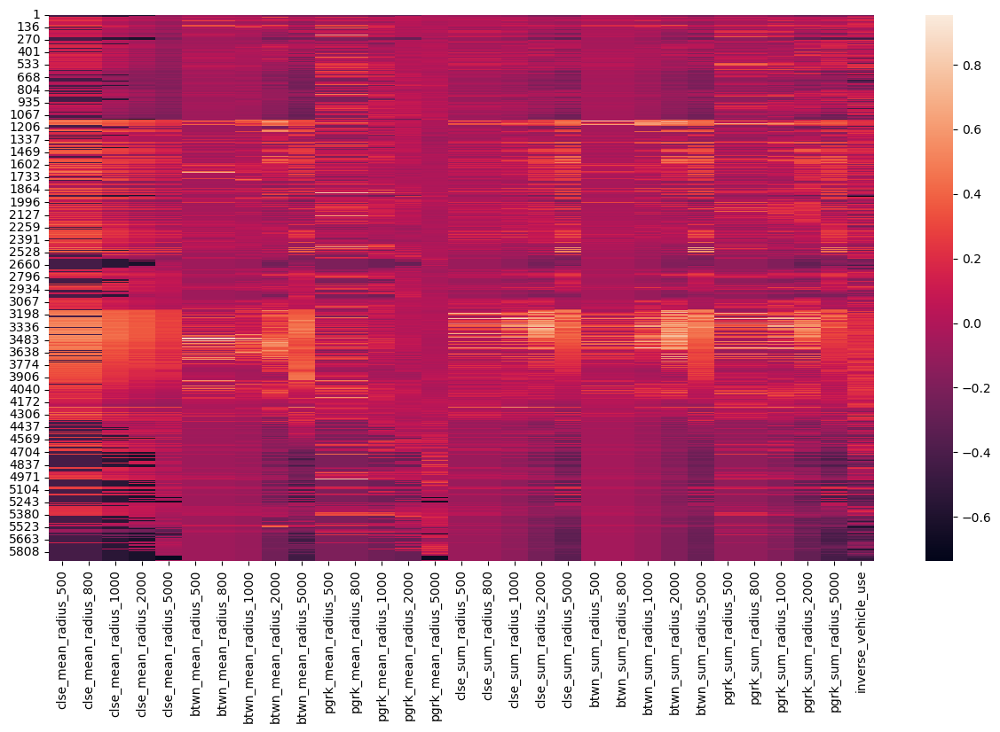

In [ ]:
import numpy as np
import seaborn as sns

# Clean Data
# zip is not included beacuse that's an index, not a calculated value
            
df = nyc_gdf[[
            'clse_mean_radius_500',
            'clse_mean_radius_800',
            'clse_mean_radius_1000',
            'clse_mean_radius_2000',
            'clse_mean_radius_5000',
            'btwn_mean_radius_500',
            'btwn_mean_radius_800',
            'btwn_mean_radius_1000',
            'btwn_mean_radius_2000',
            'btwn_mean_radius_5000',
            'pgrk_mean_radius_500',
            'pgrk_mean_radius_800',
            'pgrk_mean_radius_1000',
            'pgrk_mean_radius_2000',
            'pgrk_mean_radius_5000',
            'clse_sum_radius_500',
            'clse_sum_radius_800',
            'clse_sum_radius_1000',
            'clse_sum_radius_2000',
            'clse_sum_radius_5000',
            'btwn_sum_radius_500',
            'btwn_sum_radius_800',
            'btwn_sum_radius_1000',
            'btwn_sum_radius_2000',
            'btwn_sum_radius_5000',
            'pgrk_sum_radius_500',
            'pgrk_sum_radius_800',
            'pgrk_sum_radius_1000',
            'pgrk_sum_radius_2000',
            'pgrk_sum_radius_5000'
            ]]
df['inverse_vehicle_use'] = 100 - nyc_gdf['PCT_ACS19_5yr_B08301002']

np.any(np.isnan(df))
np.all(np.isfinite(df))

df=df.dropna()

plt.figure(figsize=(15, 8))

df_norm = (df - df.mean()) / (df.max() - df.min())
sns.heatmap(df_norm)

In [ ]:
import numpy as np
# Clean Data
# zip is not included beacuse that's an index, not a calculated value
            
df = nyc_gdf.loc[:, 'btwn_mean_radius_500':]
df['inverse_vehicle_use'] = 100 - nyc_gdf['PCT_ACS19_5yr_B08301002']

np.any(np.isnan(df))
np.all(np.isfinite(df))

df=df.dropna()

# plt.figure(figsize=(15, 8))

# df_norm = (df - df.mean()) / (df.max() - df.min())
# sns.heatmap(df_norm)

from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(df.drop('inverse_vehicle_use', axis=1), df['inverse_vehicle_use'], test_size=0.3, random_state=42)

# Create an instance of the RandomForestRegressor class
rf = RandomForestRegressor(n_estimators=100, random_state=42)

# Fit the model to the training data
rf.fit(X_train, y_train)

# Make predictions on the testing data
y_pred = rf.predict(X_test)

# Evaluate the performance of the model using mean absolute error and mean squared error
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)

print('Mean absolute error:', mae)
print('Mean squared error:', mse)

# Extract the feature importances
importances = rf.feature_importances_

# Create a list of tuples (feature name, importance score)
feature_importances = [(feature, importance) for feature, importance in zip(df.drop('inverse_vehicle_use', axis=1).columns, importances)]

# Sort the list by importance score in descending order
feature_importances = sorted(feature_importances, key=lambda x: x[1], reverse=True)

# Load the column names file
column_decode = pd.read_csv('./data/socialexplorer_nyc_blockgroup_data/column_names.csv', header=None)

# # Print the list of significant variables and their importance scores
# for feature, importance in feature_importances:
#     print(feature, column_decode.loc[feature], importance)

# If column_decode contains codes:
# Print the list of significant variables and their importance scores along with their definitions
for feature, importance in feature_importances:
    try:
        code = column_decode.loc[column_decode[1] == feature][1].values[0]
        definition = column_decode.loc[column_decode[1] == feature][0].values[0]
    except IndexError:
        code = feature
        definition = " --- "

    print(f"({importance}) {code}: {definition}")

Mean absolute error: 8.186887711124053
Mean squared error: 117.25475307768198
(0.33003030399583133) clse_sum_radius_2000:  --- 
(0.10584030921558661) clse_sum_radius_1000:  --- 
(0.09759354766963066) household_density:  --- 
(0.06506019498731244) btwn_sum_radius_5000:  --- 
(0.042224631181119444) btwn_mean_radius_5000:  --- 
(0.032468605782441394) pop_density:  --- 
(0.02454628303287699) clse_mean_radius_1000:  --- 
(0.017543147879176046) clse_mean_radius_2000:  --- 
(0.013508924321057927) pgrk_mean_radius_2000:  --- 
(0.012973927529729418) pgrk_mean_radius_10000:  --- 
(0.012393716611209542) pgrk_mean_radius_7000:  --- 
(0.010977243878998058) btwn_mean_radius_7000:  --- 
(0.01084649269916675) pgrk_mean_radius_5000:  --- 
(0.010503808201000144) egvt_sum_radius_5000:  --- 
(0.010375491923641574) btwn_mean_radius_10000:  --- 
(0.009947710746673806) pgrk_sum_radius_1000:  --- 
(0.009822472492268359) pgrk_sum_radius_5000:  --- 
(0.00951911587329208) pgrk_sum_radius_2000:  --- 
(0.008393702

### all data dataset random forest regression

<AxesSubplot: ylabel='cluster'>

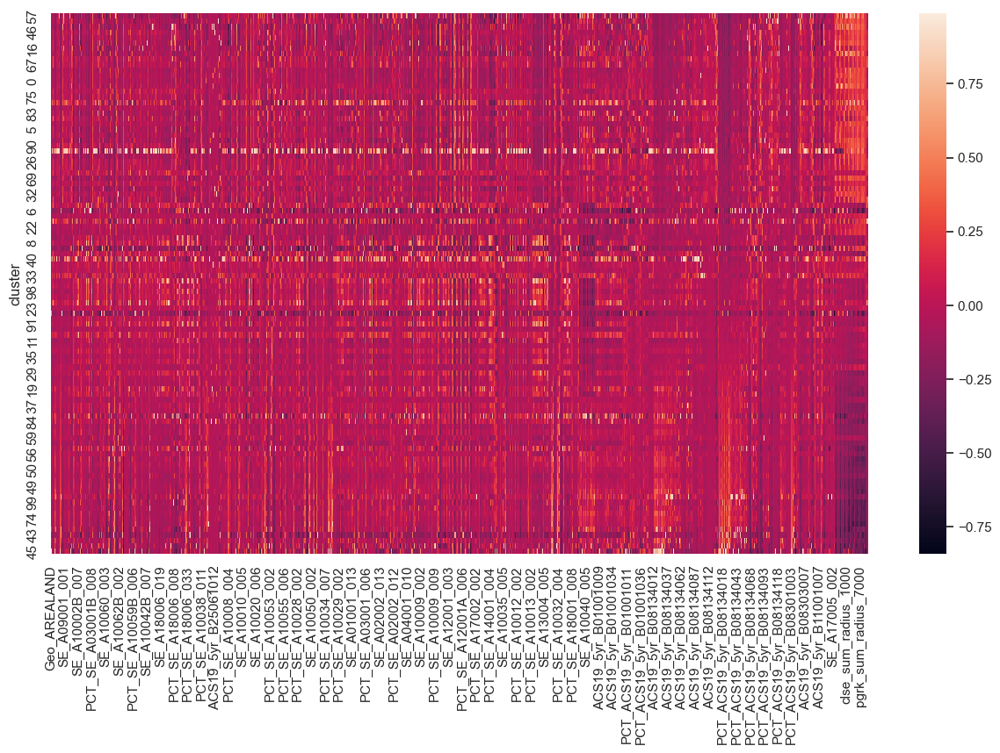

In [ ]:
import numpy as np
# Clean Data
# zip is not included beacuse that's an index, not a calculated value

# Plot the second choropleth map on the second subplot
nyc_gdf['inverse_vehicle_use'] = 100 - nyc_gdf['PCT_ACS19_5yr_B08301002']
# # nyc_gdf['log_inverse_vehicle_use'] = np.log(nyc_gdf['inverse_vehicle_use'])

nyc_gdf['pop_density'] = nyc_gdf['ACS19_5yr_B01001001'] / nyc_gdf['Geo_AREALAND']
nyc_gdf['residential_density'] = nyc_gdf['ACS19_5yr_B11001001'] / nyc_gdf['Geo_AREALAND']

# 'inverse_vehicle_use','log_inverse_vehicle_use',
            
df = nyc_gdf.copy()

# np.any(np.isnan(df))
# np.all(np.isfinite(df))

df=df.dropna()
# df = df.fillna(0)


from sklearn.cluster import KMeans
import seaborn as sns; sns.set()  # for plot styling

number_of_cluters = 100
kmeans = KMeans(n_clusters=number_of_cluters, n_init=100) # default is 10

y_kmeans = kmeans.fit_predict(df)
df['cluster'] = kmeans.labels_

df = df.groupby('cluster').mean() #cluster means

df = df.sort_values(by=['inverse_vehicle_use'], ascending=False)
df

plt.figure(figsize=(15, 8))

df_norm = (df - df.mean()) / (df.max() - df.min())
sns.heatmap(df_norm)



In [ ]:

from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error

# Plot the second choropleth map on the second subplot
nyc_gdf['inverse_vehicle_use'] = 100 - nyc_gdf['PCT_ACS19_5yr_B08301002']
# # nyc_gdf['log_inverse_vehicle_use'] = np.log(nyc_gdf['inverse_vehicle_use'])

nyc_gdf['pop_density'] = nyc_gdf['ACS19_5yr_B01001001'] / nyc_gdf['Geo_AREALAND']
nyc_gdf['residential_density'] = nyc_gdf['ACS19_5yr_B11001001'] / nyc_gdf['Geo_AREALAND']

# 'inverse_vehicle_use','log_inverse_vehicle_use',
            
df = nyc_gdf.copy()

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(df.drop('inverse_vehicle_use', axis=1), df['inverse_vehicle_use'], test_size=0.3, random_state=42)

# Create an instance of the RandomForestRegressor class
rf = RandomForestRegressor(n_estimators=100, random_state=42)

# Fit the model to the training data
rf.fit(X_train, y_train)

# Make predictions on the testing data
y_pred = rf.predict(X_test)

# Evaluate the performance of the model using mean absolute error and mean squared error
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)

print('Mean absolute error:', mae)
print('Mean squared error:', mse)

from sklearn.metrics import r2_score

# Calculate the R-squared value of the model on the testing data
r2 = r2_score(y_test, y_pred)

print('R-squared:', r2)

# Extract the feature importances
importances = rf.feature_importances_

# Create a list of tuples (feature name, importance score)
feature_importances = [(feature, importance) for feature, importance in zip(df.drop('inverse_vehicle_use', axis=1).columns, importances)]

# Sort the list by importance score in descending order
feature_importances = sorted(feature_importances, key=lambda x: x[1], reverse=True)

# Load the column names file
column_decode = pd.read_csv('./data/socialexplorer_nyc_blockgroup_data/column_names.csv', header=None)

# # Print the list of significant variables and their importance scores
# for feature, importance in feature_importances:
#     print(feature, column_decode.loc[feature], importance)


# Sort the list by importance score in descending order
feature_importances = sorted(feature_importances, key=lambda x: x[1], reverse=True)

# If column_decode contains codes:
# Print the list of significant variables and their importance scores along with their definitions
for feature, importance in feature_importances:
    try:
        code = column_decode.loc[column_decode[1] == feature][1].values[0]
        definition = column_decode.loc[column_decode[1] == feature][0].values[0]
    except IndexError:
        code = feature
        definition = " --- "

    print(f"({importance}) {code}: {definition}")

Mean absolute error: 0.029285264997086696
Mean squared error: 0.00892148941176461
R-squared: 0.9999764062761045
(0.5229216012407603) PCT_ACS19_5yr_B08301002: % Total: Car Truck Or Van
(0.47679314825207253) PCT_SE_A09005_002: % Workers 16 Years and Over: Car, Truck, or Van
(7.319460012375747e-05) PCT_ACS19_5yr_B08134011: % Total: Car Truck Or Van
(1.1114600407337631e-05) PCT_ACS19_5yr_B08134021: % Total: Car Truck Or Van: Drove Alone
(9.794645214013205e-06) PCT_ACS19_5yr_B08134061: % Total: Public Transportation (Excluding Taxicab)
(8.303311202867105e-06) PCT_SE_A18006_011: % Renter-Occupied Housing Units: 1 Bedroom
(8.0026379984293e-06) PCT_SE_A10052_003: % Occupied Housing Units: 2 Rooms
(7.6151768801462194e-06) PCT_SE_A02002_008: % Total Population: Male: 25 to 34 Years
(7.421823723323812e-06) PCT_ACS19_5yr_B01001024: % Total: Male: 80 To 84 Years
(5.315561630579646e-06) PCT_SE_A01001_002: % Total Population: Under 5 Years
(5.047427585682948e-06) ACS19_5yr_B08134070: Total: Public Tr

In [ ]:
nyc_gdf

,Geo_AREALAND,Geo_AREAWATR,SE_A00001_001,SE_A00002_001,SE_A00002_002,SE_A00002_003,SE_A09005_001,SE_A09005_002,SE_A09005_009,SE_A09005_010,...,pgrk_mean_radius_10000,egvt_mean_radius_10000,btwn_sum_radius_10000,clse_sum_radius_10000,pgrk_sum_radius_10000,egvt_sum_radius_10000,inverse_vehicle_use,pop_density,household_density,residential_density
1,89013,0,1744,1744,50744.710,0.034368,488,300,281,19,...,0.002462,0.000078,3.142514,0.041731,0.337344,0.010632,38.52,0.019593,0.005168,0.005168
2,187653,0,1569,1569,21655.350,0.072453,498,222,171,51,...,0.002474,0.000077,3.197739,0.042725,0.346376,0.010738,55.42,0.008361,0.002542,0.002542
3,178656,0,1219,1219,17671.920,0.068979,561,249,237,12,...,0.002478,0.000072,2.992861,0.041546,0.339499,0.009840,55.61,0.006823,0.002267,0.002267
4,62874,0,598,598,24633.600,0.024276,319,205,180,25,...,0.002452,0.000039,2.827868,0.039577,0.323712,0.005163,35.74,0.009511,0.004167,0.004167
5,320916,13868,782,782,6311.217,0.123906,326,153,123,30,...,0.002451,0.000041,2.821417,0.039255,0.321070,0.005334,53.07,0.002437,0.001044,0.001044
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5903,188395,0,974,974,13390.210,0.072740,460,323,278,45,...,0.003062,0.000014,0.115142,0.003310,0.033681,0.000154,29.78,0.005170,0.001571,0.001571
5904,131127,0,1781,1781,35177.870,0.050628,774,558,461,97,...,0.003062,0.000014,0.115142,0.003310,0.033681,0.000154,27.91,0.013582,0.003981,0.003981
5905,115922,0,1313,1313,29335.710,0.044758,590,331,312,19,...,0.003160,0.000007,0.072435,0.002149,0.022119,0.000047,43.90,0.011327,0.003589,0.003589
5906,118439,0,1018,1018,22261.310,0.045730,589,407,308,99,...,0.003160,0.000007,0.072435,0.002149,0.022119,0.000047,30.90,0.008595,0.002398,0.002398


In [ ]:
import statsmodels.api as sm

# Define dependent and independent variables
y = df['inverse_vehicle_use']
X = df.drop(['inverse_vehicle_use'], axis=1)

# Add constant to independent variables
X = sm.add_constant(X)

# Fit OLS model
model = sm.OLS(y, X).fit()

# Print summary of regression results
print(model.summary())

                             OLS Regression Results                            
Dep. Variable:     inverse_vehicle_use   R-squared:                       1.000
Model:                             OLS   Adj. R-squared:                  1.000
Method:                  Least Squares   F-statistic:                 4.020e+08
Date:                 Sun, 16 Apr 2023   Prob (F-statistic):               0.00
Time:                         23:32:07   Log-Likelihood:                 27422.
No. Observations:                 5723   AIC:                        -5.270e+04
Df Residuals:                     4650   BIC:                        -4.556e+04
Df Model:                         1072                                         
Covariance Type:             nonrobust                                         
                              coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------
const           

# Single Choropleth Charts

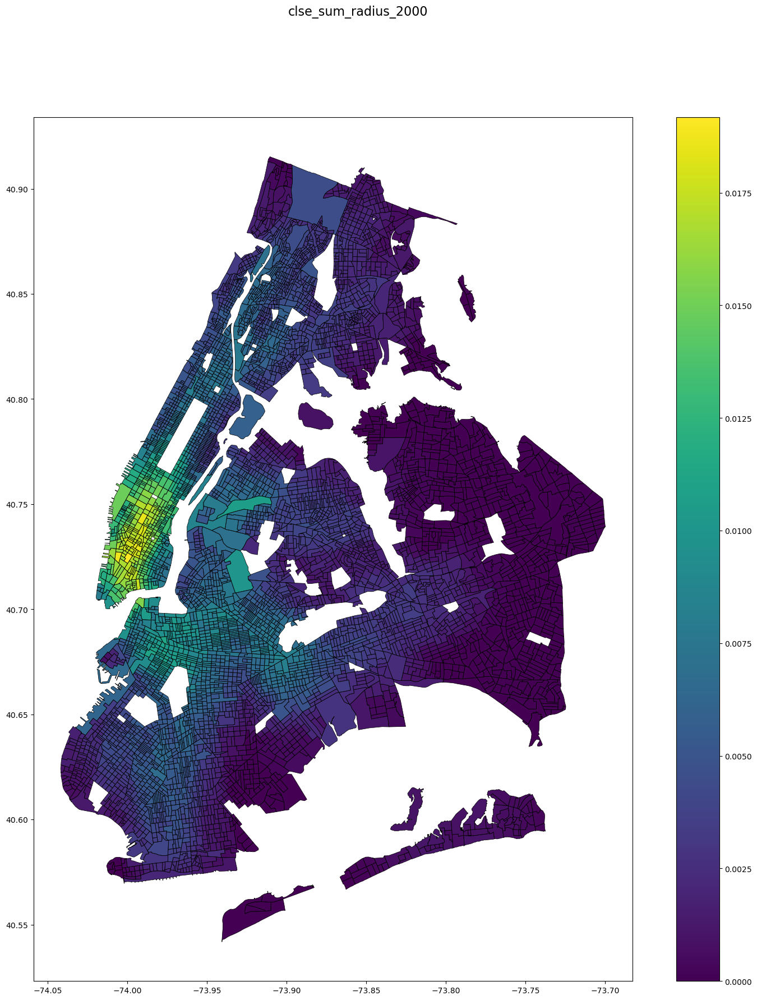

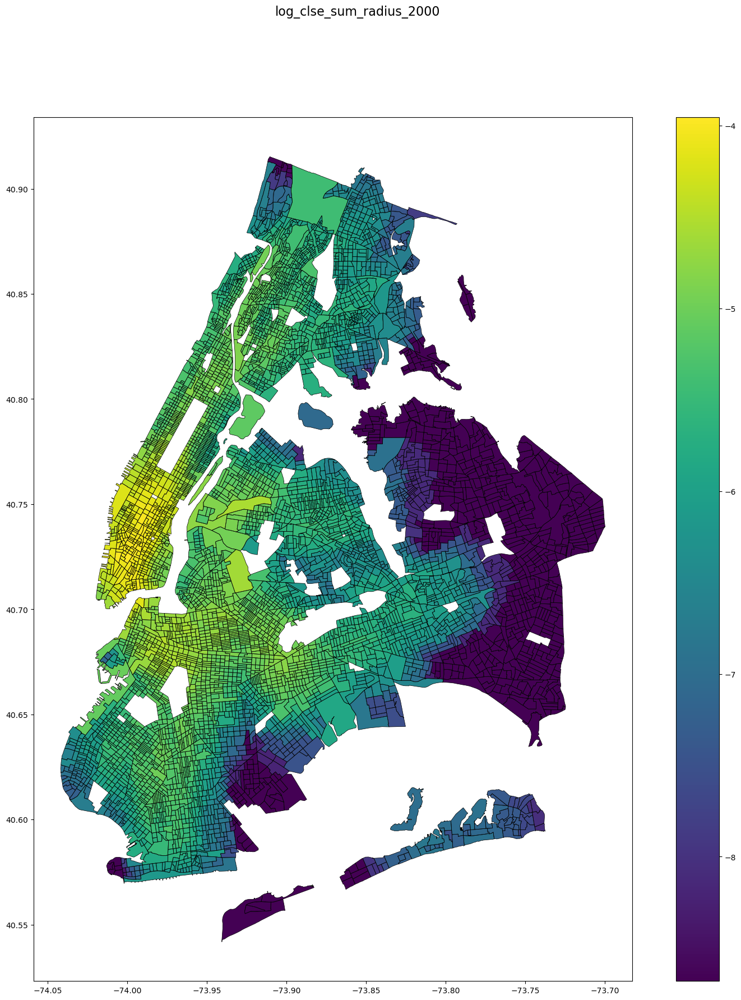

In [11]:
plot_single_choropleth(nyc_gdf, 'clse_sum_radius_2000')

min_val = nyc_gdf[nyc_gdf['clse_sum_radius_2000'] > 0]['clse_sum_radius_2000'].min()
nyc_gdf['log_clse_sum_radius_2000'] = np.log(nyc_gdf['clse_sum_radius_2000'].clip(lower=min_val))

plot_single_choropleth(nyc_gdf, 'log_clse_sum_radius_2000')


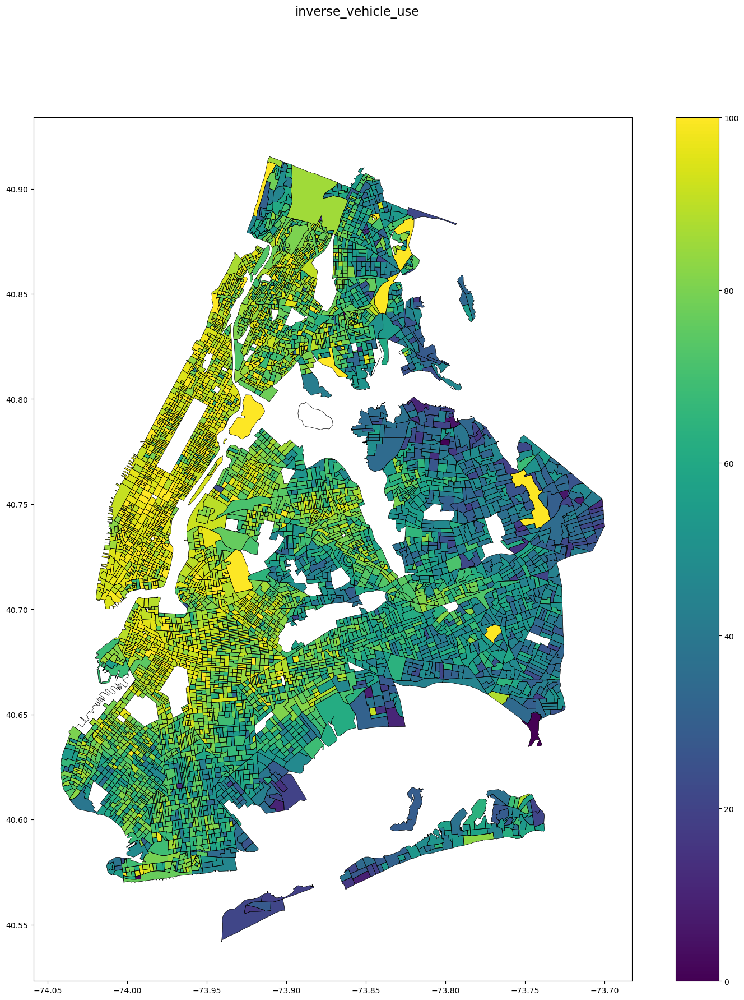

In [7]:
plot_single_choropleth(nyc_gdf, 'inverse_vehicle_use')


# Testings

In [ ]:
nyc_gdf = nyc_gdf_cached.copy()

In [ ]:
# nyc_gdf.columns[nyc_gdf.isna().any()].tolist()


In [ ]:
# import numpy as np
# # Clean Data
# # zip is not included beacuse that's an index, not a calculated value


# # Plot the second choropleth map on the second subplot
# nyc_gdf['inverse_vehicle_use'] = 100 - nyc_gdf['PCT_ACS19_5yr_B08301002']
# # # nyc_gdf['log_inverse_vehicle_use'] = np.log(nyc_gdf['inverse_vehicle_use'])

# nyc_gdf['pop_density'] = nyc_gdf['ACS19_5yr_B01001001'] / nyc_gdf['Geo_AREALAND']
# nyc_gdf['household_density'] = nyc_gdf['ACS19_5yr_B11001001'] / nyc_gdf['Geo_AREALAND']

# # 'inverse_vehicle_use','log_inverse_vehicle_use',
            
# df = nyc_gdf[['inverse_vehicle_use','pop_density','household_density',
#             'PCT_ACS19_5yr_B08134011',
#             'PCT_ACS19_5yr_B08134061',
#             'PCT_ACS19_5yr_B08134082',
#             'PCT_ACS19_5yr_B08134083',
#             'PCT_ACS19_5yr_B08134084',
#             'PCT_ACS19_5yr_B08134085',
#             'PCT_ACS19_5yr_B08134086',
#             'PCT_ACS19_5yr_B08134087',
#             'PCT_ACS19_5yr_B08134088',
#             'PCT_ACS19_5yr_B08134089',
#             'PCT_ACS19_5yr_B08134090',
#             'PCT_ACS19_5yr_B08134091',
#             'ACS19_5yr_B08301021',
#             'PCT_ACS19_5yr_B08301012',
#             'PCT_ACS19_5yr_B08301014',
#             'PCT_ACS19_5yr_B08301021',
#             'PCT_ACS19_5yr_B08134081',
#             'clse_mean_radius_500',
#             'clse_mean_radius_800',
#             'clse_mean_radius_1000',
#             'clse_mean_radius_2000',
#             'clse_mean_radius_5000',
#             'clse_mean_radius_7000',
#             'clse_mean_radius_10000',
#             'btwn_mean_radius_500',
#             'btwn_mean_radius_800',
#             'btwn_mean_radius_1000',
#             'btwn_mean_radius_2000',
#             'btwn_mean_radius_5000',
#             'btwn_mean_radius_7000',
#             'btwn_mean_radius_10000',
#             'pgrk_mean_radius_500',
#             'pgrk_mean_radius_800',
#             'pgrk_mean_radius_1000',
#             'pgrk_mean_radius_2000',
#             'pgrk_mean_radius_5000',
#             'pgrk_mean_radius_7000',
#             'pgrk_mean_radius_10000',
#             'clse_sum_radius_500',
#             'clse_sum_radius_800',
#             'clse_sum_radius_1000',
#             'clse_sum_radius_2000',
#             'clse_sum_radius_5000',
#             'clse_sum_radius_7000',
#             'clse_sum_radius_10000',
#             'btwn_sum_radius_500',
#             'btwn_sum_radius_800',
#             'btwn_sum_radius_1000',
#             'btwn_sum_radius_2000',
#             'btwn_sum_radius_5000',
#             'btwn_sum_radius_7000',
#             'btwn_sum_radius_10000',
#             'pgrk_sum_radius_500',
#             'pgrk_sum_radius_800',
#             'pgrk_sum_radius_1000',
#             'pgrk_sum_radius_2000',
#             'pgrk_sum_radius_5000',
#             'pgrk_sum_radius_7000',
#             'pgrk_sum_radius_10000',
#             ]]

# np.any(np.isnan(df))
# np.all(np.isfinite(df))

# from sklearn.cluster import KMeans
# import seaborn as sns; sns.set()  # for plot styling

# number_of_cluters = 100
# kmeans = KMeans(n_clusters=number_of_cluters, n_init=100) # default is 10

# y_kmeans = kmeans.fit_predict(df)
# df['cluster'] = kmeans.labels_

# df = df.groupby('cluster').mean() #cluster means

# df = df.sort_values(by=['inverse_vehicle_use'], ascending=False)
# df

# plt.figure(figsize=(15, 8))

# df_norm = (df - df.mean()) / (df.max() - df.min())
# sns.heatmap(df_norm)

In [ ]:
# import numpy as np
# # Clean Data
# # zip is not included beacuse that's an index, not a calculated value


# # Plot the second choropleth map on the second subplot
# nyc_gdf['inverse_vehicle_use'] = 100 - nyc_gdf['PCT_ACS19_5yr_B08301002']
# # # nyc_gdf['log_inverse_vehicle_use'] = np.log(nyc_gdf['inverse_vehicle_use'])

# nyc_gdf['pop_density'] = nyc_gdf['ACS19_5yr_B01001001'] / nyc_gdf['Geo_AREALAND']
# nyc_gdf['household_density'] = nyc_gdf['ACS19_5yr_B11001001'] / nyc_gdf['Geo_AREALAND']

# # 'inverse_vehicle_use','log_inverse_vehicle_use',
            
# df = nyc_gdf[['inverse_vehicle_use','pop_density','household_density',
#             'PCT_ACS19_5yr_B08134011',
#             'PCT_ACS19_5yr_B08134061',
#             'PCT_ACS19_5yr_B08134082',
#             'PCT_ACS19_5yr_B08134083',
#             'PCT_ACS19_5yr_B08134084',
#             'PCT_ACS19_5yr_B08134085',
#             'PCT_ACS19_5yr_B08134086',
#             'PCT_ACS19_5yr_B08134087',
#             'PCT_ACS19_5yr_B08134088',
#             'PCT_ACS19_5yr_B08134089',
#             'PCT_ACS19_5yr_B08134090',
#             'PCT_ACS19_5yr_B08134091',
#             'ACS19_5yr_B08301021',
#             'PCT_ACS19_5yr_B08301012',
#             'PCT_ACS19_5yr_B08301014',
#             'PCT_ACS19_5yr_B08301021',
#             'PCT_ACS19_5yr_B08134081',
#             'clse_mean_radius_500',
#             'clse_mean_radius_800',
#             'clse_mean_radius_1000',
#             'clse_mean_radius_2000',
#             'clse_mean_radius_5000',
#             'clse_mean_radius_7000',
#             'clse_mean_radius_10000',
#             'btwn_mean_radius_500',
#             'btwn_mean_radius_800',
#             'btwn_mean_radius_1000',
#             'btwn_mean_radius_2000',
#             'btwn_mean_radius_5000',
#             'btwn_mean_radius_7000',
#             'btwn_mean_radius_10000',
#             'pgrk_mean_radius_500',
#             'pgrk_mean_radius_800',
#             'pgrk_mean_radius_1000',
#             'pgrk_mean_radius_2000',
#             'pgrk_mean_radius_5000',
#             'pgrk_mean_radius_7000',
#             'pgrk_mean_radius_10000',
#             'clse_sum_radius_500',
#             'clse_sum_radius_800',
#             'clse_sum_radius_1000',
#             'clse_sum_radius_2000',
#             'clse_sum_radius_5000',
#             'clse_sum_radius_7000',
#             'clse_sum_radius_10000',
#             'btwn_sum_radius_500',
#             'btwn_sum_radius_800',
#             'btwn_sum_radius_1000',
#             'btwn_sum_radius_2000',
#             'btwn_sum_radius_5000',
#             'btwn_sum_radius_7000',
#             'btwn_sum_radius_10000',
#             'pgrk_sum_radius_500',
#             'pgrk_sum_radius_800',
#             'pgrk_sum_radius_1000',
#             'pgrk_sum_radius_2000',
#             'pgrk_sum_radius_5000',
#             'pgrk_sum_radius_7000',
#             'pgrk_sum_radius_10000',
#             ]]

# np.any(np.isnan(df))
# np.all(np.isfinite(df))

# from sklearn.cluster import KMeans
# import seaborn as sns; sns.set()  # for plot styling

# number_of_cluters = 100
# kmeans = KMeans(n_clusters=number_of_cluters, n_init=100) # default is 10

# y_kmeans = kmeans.fit_predict(df)
# df['cluster'] = kmeans.labels_

# df = df.groupby('cluster').mean() #cluster means

# df = df.sort_values(by=['inverse_vehicle_use'], ascending=False)
# df

# plt.figure(figsize=(15, 8))

# df_norm = (df - df.mean()) / (df.max() - df.min())
# sns.heatmap(df_norm)

In [ ]:

# Set the maximum number of rows and columns to display
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

# Check for missing data
print(df.isnull().any())

Geo_AREALAND               False
Geo_AREAWATR               False
SE_A00001_001              False
SE_A00002_001              False
SE_A00002_002              False
SE_A00002_003              False
SE_A09005_001              False
SE_A09005_002              False
SE_A09005_009              False
SE_A09005_010              False
SE_A09005_003              False
SE_A09005_004              False
SE_A09005_005              False
SE_A09005_006              False
SE_A09005_007              False
SE_A09005_008              False
PCT_SE_A09005_002          False
PCT_SE_A09005_009          False
PCT_SE_A09005_010          False
PCT_SE_A09005_003          False
PCT_SE_A09005_004          False
PCT_SE_A09005_005          False
PCT_SE_A09005_006          False
PCT_SE_A09005_007          False
PCT_SE_A09005_008          False
SE_A09001_001              False
SE_A09001_002              False
SE_A09001_003              False
SE_A09001_004              False
SE_A09001_005              False
SE_A09001_

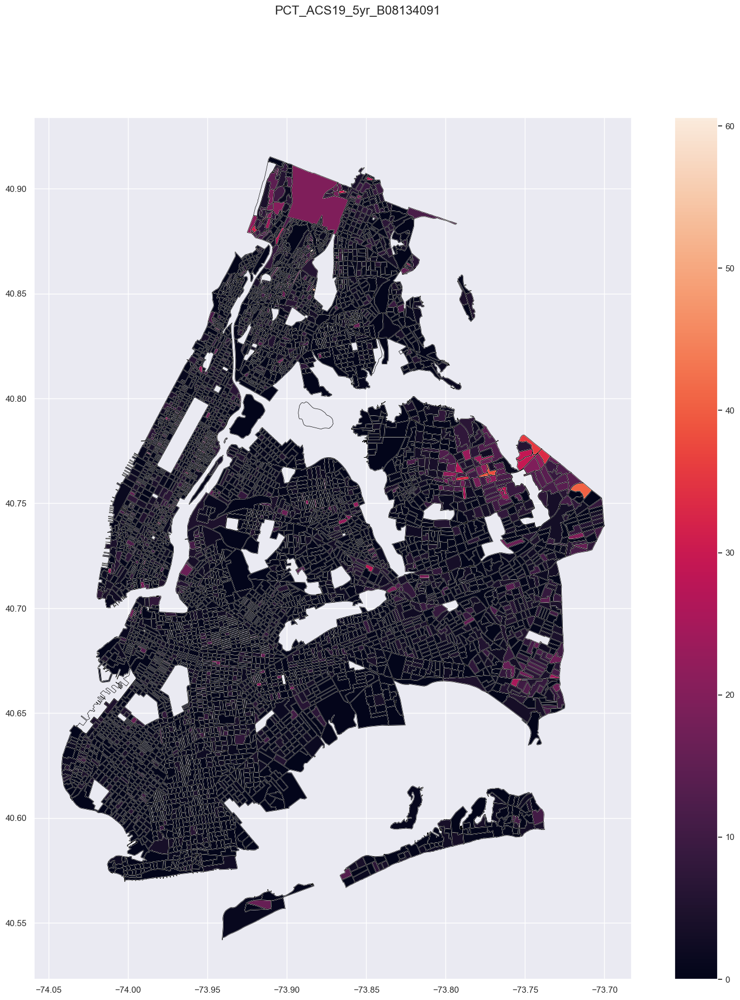

In [ ]:
plot_single_choropleth(nyc_gdf, 'PCT_ACS19_5yr_B08134091')

KeyError: 'inverse_vehicle_use'

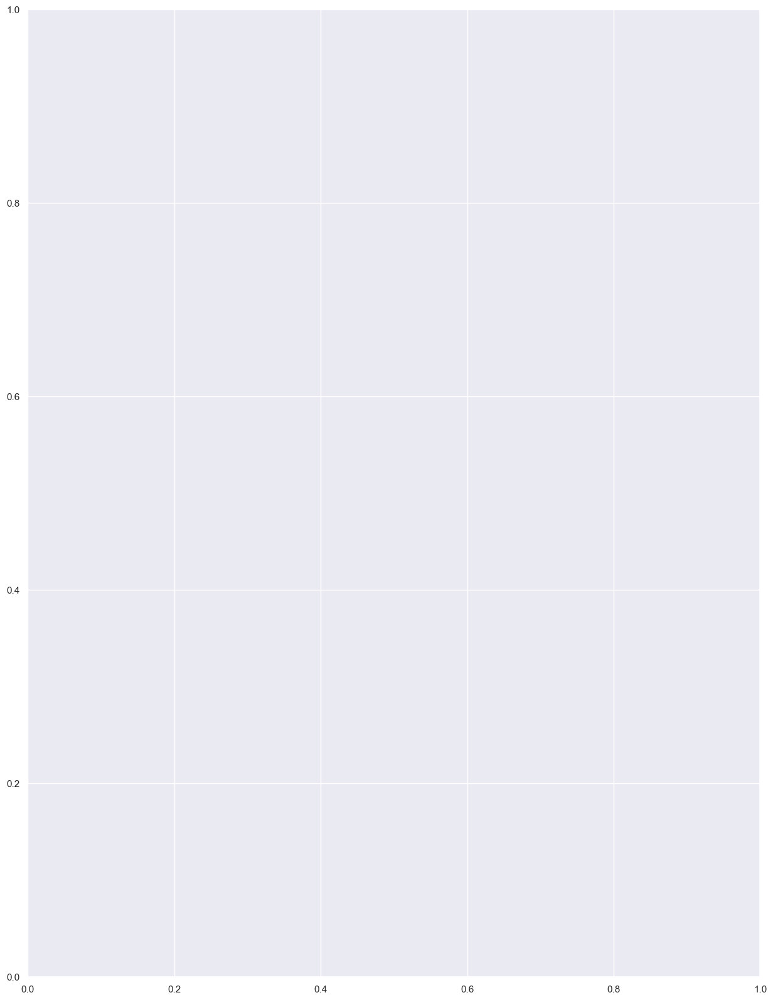

In [ ]:
plot_single_choropleth(nyc_gdf, 'inverse_vehicle_use')

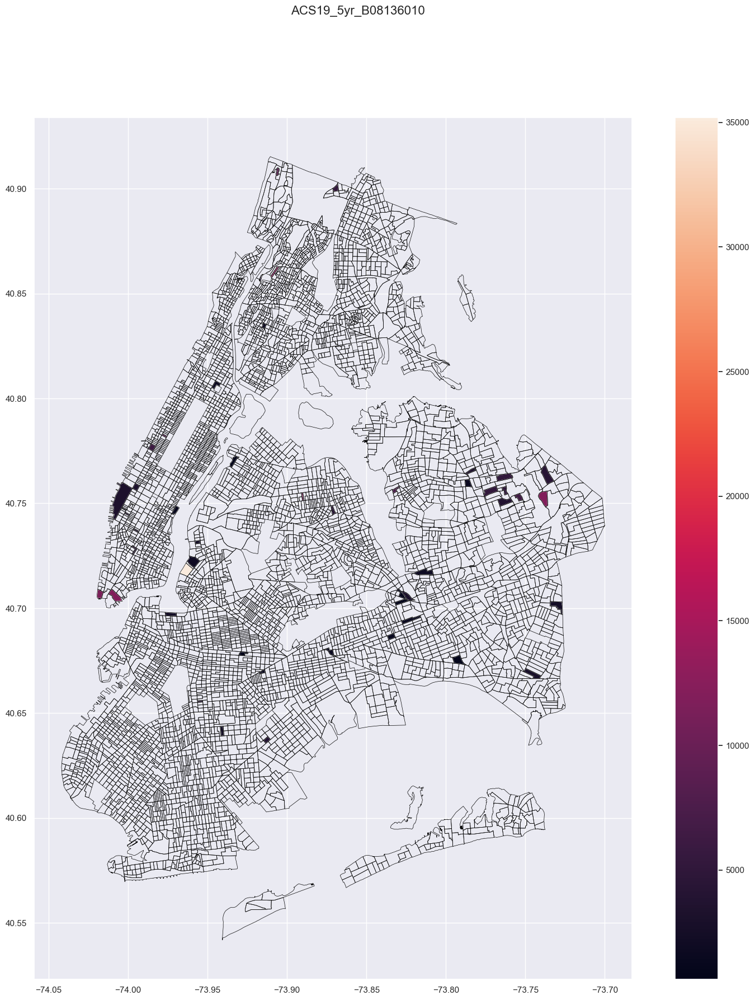

In [ ]:
plot_single_choropleth(nyc_gdf, 'ACS19_5yr_B08136010')

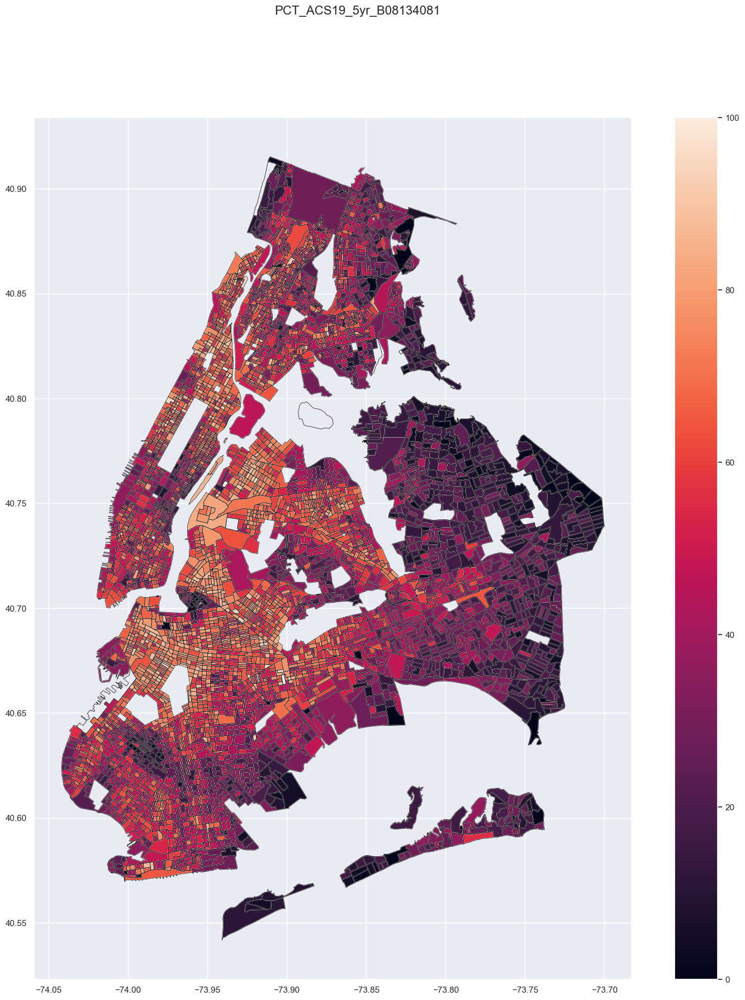

In [ ]:
plot_single_choropleth(nyc_gdf, 'PCT_ACS19_5yr_B08134081')

# Test2

<AxesSubplot: ylabel='cluster'>

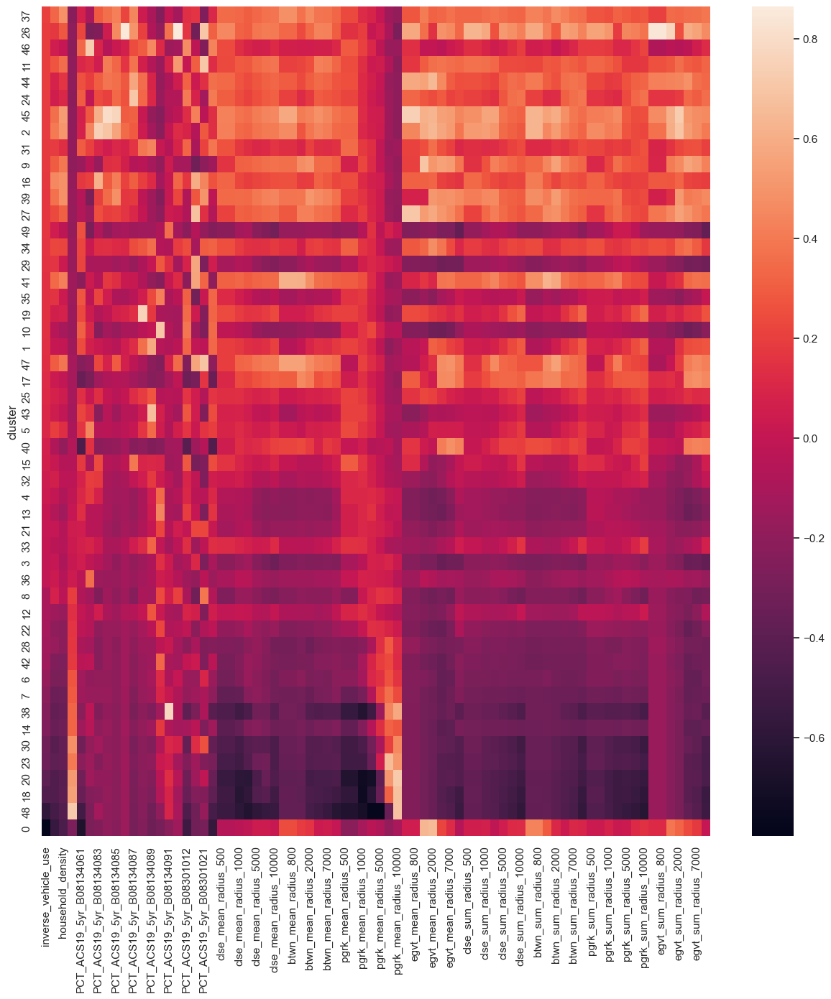

In [ ]:
import numpy as np
# Clean Data
# zip is not included beacuse that's an index, not a calculated value


# Plot the second choropleth map on the second subplot
nyc_gdf['inverse_vehicle_use'] = 100 - nyc_gdf['PCT_ACS19_5yr_B08301002']
# # nyc_gdf['log_inverse_vehicle_use'] = np.log(nyc_gdf['inverse_vehicle_use'])

nyc_gdf['pop_density'] = nyc_gdf['ACS19_5yr_B01001001'] / nyc_gdf['Geo_AREALAND']
nyc_gdf['household_density'] = nyc_gdf['ACS19_5yr_B11001001'] / nyc_gdf['Geo_AREALAND']

# 'inverse_vehicle_use','log_inverse_vehicle_use',
            
df = nyc_gdf[['inverse_vehicle_use','pop_density','household_density',
            'PCT_ACS19_5yr_B08134011',
            'PCT_ACS19_5yr_B08134061',
            'PCT_ACS19_5yr_B08134082',
            'PCT_ACS19_5yr_B08134083',
            'PCT_ACS19_5yr_B08134084',
            'PCT_ACS19_5yr_B08134085',
            'PCT_ACS19_5yr_B08134086',
            'PCT_ACS19_5yr_B08134087',
            'PCT_ACS19_5yr_B08134088',
            'PCT_ACS19_5yr_B08134089',
            'PCT_ACS19_5yr_B08134090',
            'PCT_ACS19_5yr_B08134091',
            'ACS19_5yr_B08301021',
            'PCT_ACS19_5yr_B08301012',
            'PCT_ACS19_5yr_B08301014',
            'PCT_ACS19_5yr_B08301021',
            'PCT_ACS19_5yr_B08134081',
            'clse_mean_radius_500',
            'clse_mean_radius_800',
            'clse_mean_radius_1000',
            'clse_mean_radius_2000',
            'clse_mean_radius_5000',
            'clse_mean_radius_7000',
            'clse_mean_radius_10000',
            'btwn_mean_radius_500',
            'btwn_mean_radius_800',
            'btwn_mean_radius_1000',
            'btwn_mean_radius_2000',
            'btwn_mean_radius_5000',
            'btwn_mean_radius_7000',
            'btwn_mean_radius_10000',
            'pgrk_mean_radius_500',
            'pgrk_mean_radius_800',
            'pgrk_mean_radius_1000',
            'pgrk_mean_radius_2000',
            'pgrk_mean_radius_5000',
            'pgrk_mean_radius_7000',
            'pgrk_mean_radius_10000',
            'egvt_mean_radius_500',
            'egvt_mean_radius_800',
            'egvt_mean_radius_1000',
            'egvt_mean_radius_2000',
            'egvt_mean_radius_5000',
            'egvt_mean_radius_7000',
            'egvt_mean_radius_10000',
            'clse_sum_radius_500',
            'clse_sum_radius_800',
            'clse_sum_radius_1000',
            'clse_sum_radius_2000',
            'clse_sum_radius_5000',
            'clse_sum_radius_7000',
            'clse_sum_radius_10000',
            'btwn_sum_radius_500',
            'btwn_sum_radius_800',
            'btwn_sum_radius_1000',
            'btwn_sum_radius_2000',
            'btwn_sum_radius_5000',
            'btwn_sum_radius_7000',
            'btwn_sum_radius_10000',
            'pgrk_sum_radius_500',
            'pgrk_sum_radius_800',
            'pgrk_sum_radius_1000',
            'pgrk_sum_radius_2000',
            'pgrk_sum_radius_5000',
            'pgrk_sum_radius_7000',
            'pgrk_sum_radius_10000',
            'egvt_sum_radius_500',
            'egvt_sum_radius_800',
            'egvt_sum_radius_1000',
            'egvt_sum_radius_2000',
            'egvt_sum_radius_5000',
            'egvt_sum_radius_7000',
            'egvt_sum_radius_10000'
            ]]

np.any(np.isnan(df))
np.all(np.isfinite(df))

# df=df.dropna()
df = df.fillna(0)


from sklearn.cluster import KMeans
import seaborn as sns; sns.set()  # for plot styling

number_of_cluters = 50
kmeans = KMeans(n_clusters=number_of_cluters, n_init=100) # default is 10

y_kmeans = kmeans.fit_predict(df)
df['cluster'] = kmeans.labels_

df = df.groupby('cluster').mean() #cluster means

df = df.sort_values(by=['inverse_vehicle_use'], ascending=False)
df

plt.figure(figsize=(15, 15))

df_norm = (df - df.mean()) / (df.max() - df.min())
sns.heatmap(df_norm)

In [ ]:
df = nyc_gdf[['inverse_vehicle_use','pop_density','household_density',
            'PCT_ACS19_5yr_B08134011',
            'PCT_ACS19_5yr_B08134061',
            'PCT_ACS19_5yr_B08134082',
            'PCT_ACS19_5yr_B08134083',
            'PCT_ACS19_5yr_B08134084',
            'PCT_ACS19_5yr_B08134085',
            'PCT_ACS19_5yr_B08134086',
            'PCT_ACS19_5yr_B08134087',
            'PCT_ACS19_5yr_B08134088',
            'PCT_ACS19_5yr_B08134089',
            'PCT_ACS19_5yr_B08134090',
            'PCT_ACS19_5yr_B08134091',
            'ACS19_5yr_B08301021',
            'PCT_ACS19_5yr_B08301012',
            'PCT_ACS19_5yr_B08301014',
            'PCT_ACS19_5yr_B08301021',
            'PCT_ACS19_5yr_B08134081',
            'clse_mean_radius_500',
            'clse_mean_radius_800',
            'clse_mean_radius_1000',
            'clse_mean_radius_2000',
            'clse_mean_radius_5000',
            'clse_mean_radius_7000',
            'clse_mean_radius_10000',
            'btwn_mean_radius_500',
            'btwn_mean_radius_800',
            'btwn_mean_radius_1000',
            'btwn_mean_radius_2000',
            'btwn_mean_radius_5000',
            'btwn_mean_radius_7000',
            'btwn_mean_radius_10000',
            'pgrk_mean_radius_500',
            'pgrk_mean_radius_800',
            'pgrk_mean_radius_1000',
            'pgrk_mean_radius_2000',
            'pgrk_mean_radius_5000',
            'pgrk_mean_radius_7000',
            'pgrk_mean_radius_10000',
            'egvt_mean_radius_500',
            'egvt_mean_radius_800',
            'egvt_mean_radius_1000',
            'egvt_mean_radius_2000',
            'egvt_mean_radius_5000',
            'egvt_mean_radius_7000',
            'egvt_mean_radius_10000',
            'clse_sum_radius_500',
            'clse_sum_radius_800',
            'clse_sum_radius_1000',
            'clse_sum_radius_2000',
            'clse_sum_radius_5000',
            'clse_sum_radius_7000',
            'clse_sum_radius_10000',
            'btwn_sum_radius_500',
            'btwn_sum_radius_800',
            'btwn_sum_radius_1000',
            'btwn_sum_radius_2000',
            'btwn_sum_radius_5000',
            'btwn_sum_radius_7000',
            'btwn_sum_radius_10000',
            'pgrk_sum_radius_500',
            'pgrk_sum_radius_800',
            'pgrk_sum_radius_1000',
            'pgrk_sum_radius_2000',
            'pgrk_sum_radius_5000',
            'pgrk_sum_radius_7000',
            'pgrk_sum_radius_10000',
            'egvt_sum_radius_500',
            'egvt_sum_radius_800',
            'egvt_sum_radius_1000',
            'egvt_sum_radius_2000',
            'egvt_sum_radius_5000',
            'egvt_sum_radius_7000',
            'egvt_sum_radius_10000'
            ]]
df

,inverse_vehicle_use,pop_density,household_density,PCT_ACS19_5yr_B08134011,PCT_ACS19_5yr_B08134061,PCT_ACS19_5yr_B08134082,PCT_ACS19_5yr_B08134083,PCT_ACS19_5yr_B08134084,PCT_ACS19_5yr_B08134085,PCT_ACS19_5yr_B08134086,...,pgrk_sum_radius_5000,pgrk_sum_radius_7000,pgrk_sum_radius_10000,egvt_sum_radius_500,egvt_sum_radius_800,egvt_sum_radius_1000,egvt_sum_radius_2000,egvt_sum_radius_5000,egvt_sum_radius_7000,egvt_sum_radius_10000
0,NaN,0.004346,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.123894,0.259312,0.468465,0.0,0.0,0.0,0.000001,0.002109,0.011328,0.090138
1,38.52,0.019593,0.005168,61.48,38.52,0.0,0.0,0.0,4.3,0.0,...,0.059283,0.162870,0.337344,0.0,0.0,0.0,0.000002,0.000016,0.000326,0.010632
2,55.42,0.008361,0.002542,45.49,38.11,0.0,0.0,0.0,0.0,0.0,...,0.061204,0.176416,0.346376,0.0,0.0,0.0,0.000002,0.000016,0.001696,0.010738
3,55.61,0.006823,0.002267,45.52,52.65,0.0,0.0,0.0,0.0,0.0,...,0.059283,0.166107,0.339499,0.0,0.0,0.0,0.000000,0.000016,0.001605,0.009840
4,35.74,0.009511,0.004167,64.26,35.74,0.0,0.0,0.0,0.0,0.0,...,0.059283,0.156999,0.323712,0.0,0.0,0.0,0.000002,0.000016,0.000271,0.005163
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5903,29.78,0.005170,0.001571,72.10,25.45,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.005475,0.033681,0.0,0.0,0.0,0.000000,0.000000,0.000004,0.000154
5904,27.91,0.013582,0.003981,77.50,21.25,0.0,0.0,0.0,0.0,0.0,...,0.002351,0.011911,0.033681,0.0,0.0,0.0,0.000000,0.000001,0.000017,0.000154
5905,43.90,0.011327,0.003589,60.07,26.32,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.005475,0.022119,0.0,0.0,0.0,0.000000,0.000000,0.000004,0.000047
5906,30.90,0.008595,0.002398,74.27,24.09,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.005475,0.022119,0.0,0.0,0.0,0.000000,0.000000,0.000004,0.000047


<AxesSubplot: ylabel='cluster'>

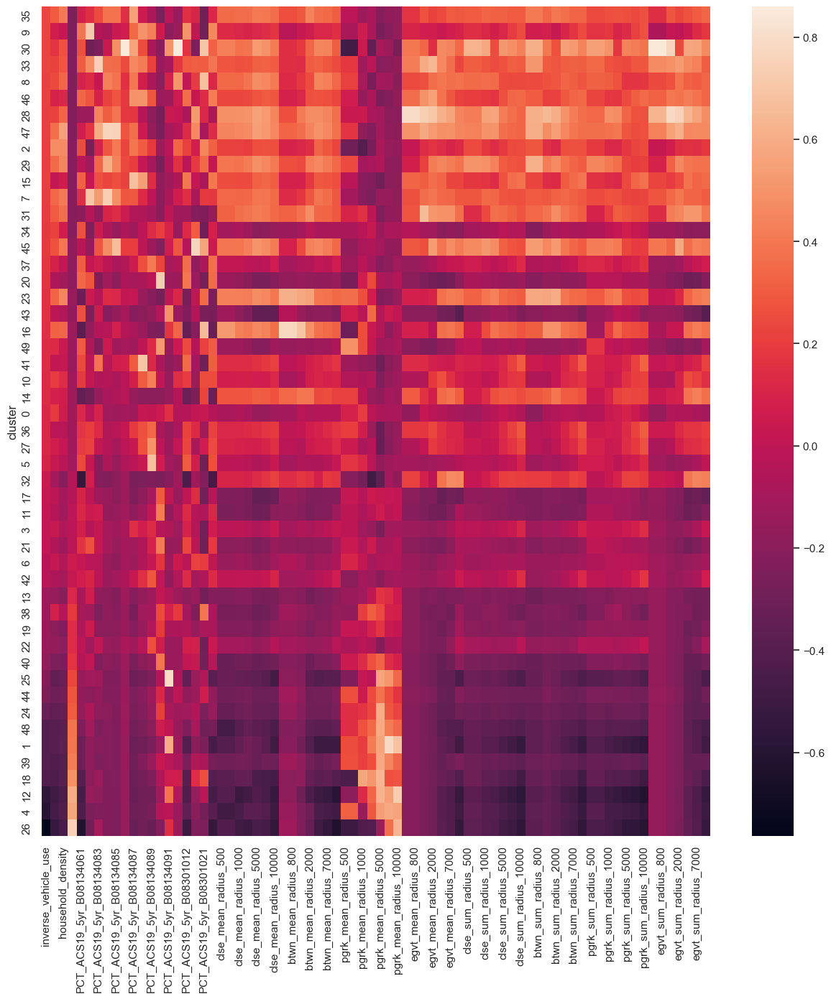

In [ ]:
import numpy as np
# Clean Data
# zip is not included beacuse that's an index, not a calculated value


# Plot the second choropleth map on the second subplot
nyc_gdf['inverse_vehicle_use'] = 100 - nyc_gdf['PCT_ACS19_5yr_B08301002']
# # nyc_gdf['log_inverse_vehicle_use'] = np.log(nyc_gdf['inverse_vehicle_use'])

nyc_gdf['pop_density'] = nyc_gdf['ACS19_5yr_B01001001'] / nyc_gdf['Geo_AREALAND']
nyc_gdf['household_density'] = nyc_gdf['ACS19_5yr_B11001001'] / nyc_gdf['Geo_AREALAND']

# 'inverse_vehicle_use','log_inverse_vehicle_use',
            
df = nyc_gdf[['inverse_vehicle_use','pop_density','household_density',
            'PCT_ACS19_5yr_B08134011',
            'PCT_ACS19_5yr_B08134061',
            'PCT_ACS19_5yr_B08134082',
            'PCT_ACS19_5yr_B08134083',
            'PCT_ACS19_5yr_B08134084',
            'PCT_ACS19_5yr_B08134085',
            'PCT_ACS19_5yr_B08134086',
            'PCT_ACS19_5yr_B08134087',
            'PCT_ACS19_5yr_B08134088',
            'PCT_ACS19_5yr_B08134089',
            'PCT_ACS19_5yr_B08134090',
            'PCT_ACS19_5yr_B08134091',
            'ACS19_5yr_B08301021',
            'PCT_ACS19_5yr_B08301012',
            'PCT_ACS19_5yr_B08301014',
            'PCT_ACS19_5yr_B08301021',
            'PCT_ACS19_5yr_B08134081',
            'clse_mean_radius_500',
            'clse_mean_radius_800',
            'clse_mean_radius_1000',
            'clse_mean_radius_2000',
            'clse_mean_radius_5000',
            'clse_mean_radius_7000',
            'clse_mean_radius_10000',
            'btwn_mean_radius_500',
            'btwn_mean_radius_800',
            'btwn_mean_radius_1000',
            'btwn_mean_radius_2000',
            'btwn_mean_radius_5000',
            'btwn_mean_radius_7000',
            'btwn_mean_radius_10000',
            'pgrk_mean_radius_500',
            'pgrk_mean_radius_800',
            'pgrk_mean_radius_1000',
            'pgrk_mean_radius_2000',
            'pgrk_mean_radius_5000',
            'pgrk_mean_radius_7000',
            'pgrk_mean_radius_10000',
            'egvt_mean_radius_500',
            'egvt_mean_radius_800',
            'egvt_mean_radius_1000',
            'egvt_mean_radius_2000',
            'egvt_mean_radius_5000',
            'egvt_mean_radius_7000',
            'egvt_mean_radius_10000',
            'clse_sum_radius_500',
            'clse_sum_radius_800',
            'clse_sum_radius_1000',
            'clse_sum_radius_2000',
            'clse_sum_radius_5000',
            'clse_sum_radius_7000',
            'clse_sum_radius_10000',
            'btwn_sum_radius_500',
            'btwn_sum_radius_800',
            'btwn_sum_radius_1000',
            'btwn_sum_radius_2000',
            'btwn_sum_radius_5000',
            'btwn_sum_radius_7000',
            'btwn_sum_radius_10000',
            'pgrk_sum_radius_500',
            'pgrk_sum_radius_800',
            'pgrk_sum_radius_1000',
            'pgrk_sum_radius_2000',
            'pgrk_sum_radius_5000',
            'pgrk_sum_radius_7000',
            'pgrk_sum_radius_10000',
            'egvt_sum_radius_500',
            'egvt_sum_radius_800',
            'egvt_sum_radius_1000',
            'egvt_sum_radius_2000',
            'egvt_sum_radius_5000',
            'egvt_sum_radius_7000',
            'egvt_sum_radius_10000'
            ]]

# Remove rows with missing target variable 'inverse_vehicle_use'
df = df[df['inverse_vehicle_use'].notna()]

from sklearn.impute import KNNImputer

# Impute
number_of_cluters = 50 
imputer = KNNImputer(n_neighbors=5)
df_imputed = pd.DataFrame(imputer.fit_transform(df), columns=df.columns)

np.any(np.isnan(df_imputed))
np.all(np.isfinite(df_imputed))

# ... (the same code as before, from "from sklearn.cluster import KMeans")

# Replace 'df' with 'df_imputed' in the following line
y_kmeans = kmeans.fit_predict(df_imputed)
df_imputed['cluster'] = kmeans.labels_

df_imputed = df_imputed.groupby('cluster').mean()  # cluster means

df_imputed = df_imputed.sort_values(by=['inverse_vehicle_use'], ascending=False)
df_imputed

plt.figure(figsize=(15, 15))

df_norm = (df_imputed - df_imputed.mean()) / (df_imputed.max() - df_imputed.min())
sns.heatmap(df_norm)

In [ ]:
# import statsmodels.api as sm

# # Define dependent and independent variables
# y = df['inverse_vehicle_use']
# X = df.drop(['inverse_vehicle_use'], axis=1)

# # Add constant to independent variables
# X = sm.add_constant(X)

# # Fit OLS model
# model = sm.OLS(y, X).fit()

# # Print summary of regression results
# print(model.summary())


<AxesSubplot: ylabel='cluster'>

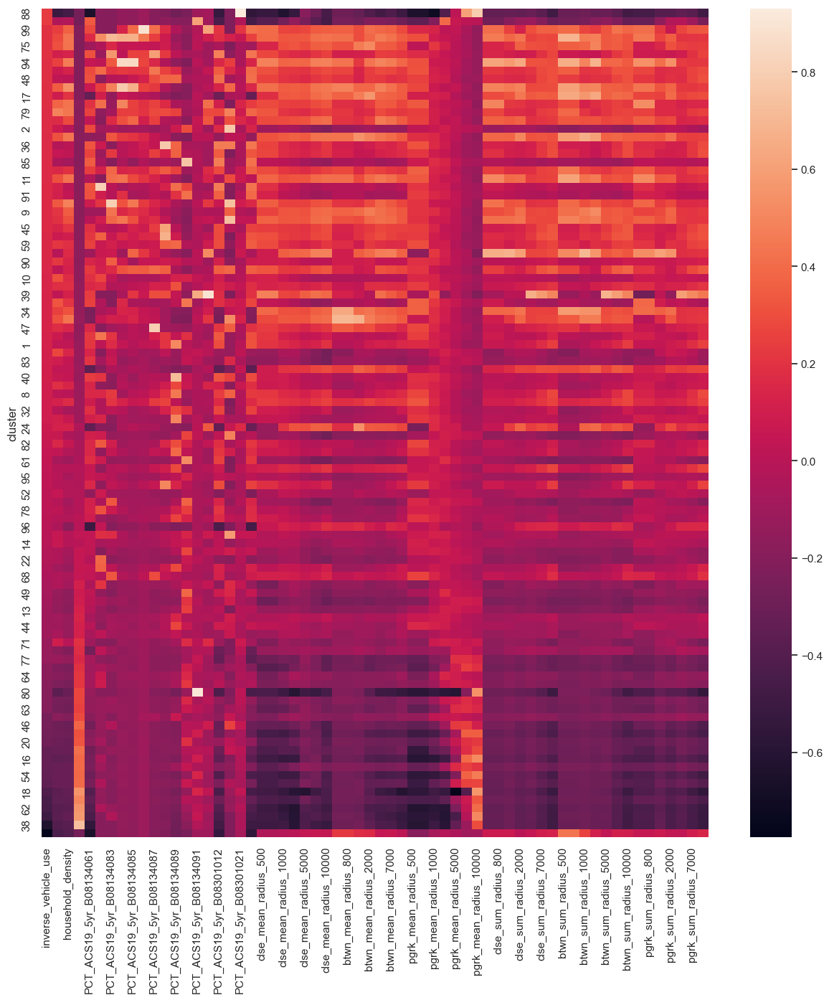

In [ ]:
import numpy as np
# Clean Data
# zip is not included beacuse that's an index, not a calculated value


# Plot the second choropleth map on the second subplot
nyc_gdf['inverse_vehicle_use'] = 100 - nyc_gdf['PCT_ACS19_5yr_B08301002']
# # nyc_gdf['log_inverse_vehicle_use'] = np.log(nyc_gdf['inverse_vehicle_use'])

nyc_gdf['pop_density'] = nyc_gdf['ACS19_5yr_B01001001'] / nyc_gdf['Geo_AREALAND']
nyc_gdf['household_density'] = nyc_gdf['ACS19_5yr_B11001001'] / nyc_gdf['Geo_AREALAND']

# 'inverse_vehicle_use','log_inverse_vehicle_use',
            
df = nyc_gdf[['inverse_vehicle_use','pop_density','household_density',
            'PCT_ACS19_5yr_B08134011',
            'PCT_ACS19_5yr_B08134061',
            'PCT_ACS19_5yr_B08134082',
            'PCT_ACS19_5yr_B08134083',
            'PCT_ACS19_5yr_B08134084',
            'PCT_ACS19_5yr_B08134085',
            'PCT_ACS19_5yr_B08134086',
            'PCT_ACS19_5yr_B08134087',
            'PCT_ACS19_5yr_B08134088',
            'PCT_ACS19_5yr_B08134089',
            'PCT_ACS19_5yr_B08134090',
            'PCT_ACS19_5yr_B08134091',
            'ACS19_5yr_B08301021',
            'PCT_ACS19_5yr_B08301012',
            'PCT_ACS19_5yr_B08301014',
            'PCT_ACS19_5yr_B08301021',
            'PCT_ACS19_5yr_B08134081',
            'clse_mean_radius_500',
            'clse_mean_radius_800',
            'clse_mean_radius_1000',
            'clse_mean_radius_2000',
            'clse_mean_radius_5000',
            'clse_mean_radius_7000',
            'clse_mean_radius_10000',
            'btwn_mean_radius_500',
            'btwn_mean_radius_800',
            'btwn_mean_radius_1000',
            'btwn_mean_radius_2000',
            'btwn_mean_radius_5000',
            'btwn_mean_radius_7000',
            'btwn_mean_radius_10000',
            'pgrk_mean_radius_500',
            'pgrk_mean_radius_800',
            'pgrk_mean_radius_1000',
            'pgrk_mean_radius_2000',
            'pgrk_mean_radius_5000',
            'pgrk_mean_radius_7000',
            'pgrk_mean_radius_10000',
            'clse_sum_radius_500',
            'clse_sum_radius_800',
            'clse_sum_radius_1000',
            'clse_sum_radius_2000',
            'clse_sum_radius_5000',
            'clse_sum_radius_7000',
            'clse_sum_radius_10000',
            'btwn_sum_radius_500',
            'btwn_sum_radius_800',
            'btwn_sum_radius_1000',
            'btwn_sum_radius_2000',
            'btwn_sum_radius_5000',
            'btwn_sum_radius_7000',
            'btwn_sum_radius_10000',
            'pgrk_sum_radius_500',
            'pgrk_sum_radius_800',
            'pgrk_sum_radius_1000',
            'pgrk_sum_radius_2000',
            'pgrk_sum_radius_5000',
            'pgrk_sum_radius_7000',
            'pgrk_sum_radius_10000',
            ]]

np.any(np.isnan(df))
np.all(np.isfinite(df))

# df=df.dropna()
df = df.fillna(0)


from sklearn.cluster import KMeans
import seaborn as sns; sns.set()  # for plot styling

number_of_cluters = 100
kmeans = KMeans(n_clusters=number_of_cluters, n_init=100) # default is 10

y_kmeans = kmeans.fit_predict(df)
df['cluster'] = kmeans.labels_

df = df.groupby('cluster').mean() #cluster means

df = df.sort_values(by=['inverse_vehicle_use'], ascending=False)
df

plt.figure(figsize=(15, 15))

df_norm = (df - df.mean()) / (df.max() - df.min())
sns.heatmap(df_norm)

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(df.drop('inverse_vehicle_use', axis=1), df['inverse_vehicle_use'], test_size=0.3, random_state=42)

# Create an instance of the RandomForestRegressor class
rf = RandomForestRegressor(n_estimators=100, random_state=42)

# Fit the model to the training data
rf.fit(X_train, y_train)

# Make predictions on the testing data
y_pred = rf.predict(X_test)

# Evaluate the performance of the model using mean absolute error and mean squared error
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)

print('Mean absolute error:', mae)
print('Mean squared error:', mse)

# Extract the feature importances
importances = rf.feature_importances_

# Create a list of tuples (feature name, importance score)
feature_importances = [(feature, importance) for feature, importance in zip(X.columns, importances)]

# Sort the list by importance score in descending order
feature_importances = sorted(feature_importances, key=lambda x: x[1], reverse=True)

# Print the list of significant variables and their importance scores
for feature, importance in feature_importances:
    print(feature, importance)

from sklearn.metrics import accuracy_score

# Assuming y_test and y_pred contain the actual and predicted class labels, respectively
accuracy = accuracy_score(y_test, y_pred)
print('Accuracy:', accuracy)

Mean absolute error: 4.431421101249663
Mean squared error: 143.5067876886772
pop_density 0.3307429741420089
household_density 0.28629717148805767
const 0.18367695401877754
btwn_sum_radius_800 0.056247701462408733
btwn_mean_radius_10000 0.016196999186288304
PCT_ACS19_5yr_B08134084 0.013015512150541635
PCT_ACS19_5yr_B08134086 0.011986049027533
PCT_ACS19_5yr_B08134011 0.011727057958248334
pgrk_mean_radius_10000 0.010201588349727961
pgrk_mean_radius_500 0.008376299490122103
btwn_sum_radius_1000 0.00837271753405288
PCT_ACS19_5yr_B08301012 0.005802692026171345
PCT_ACS19_5yr_B08134085 0.004761076646097441
pgrk_mean_radius_5000 0.004669558012790982
PCT_ACS19_5yr_B08134087 0.004356727411161812
egvt_mean_radius_1000 0.003558370003968017
PCT_ACS19_5yr_B08301021 0.003534890396723448
pgrk_mean_radius_7000 0.0032199559550073966
PCT_ACS19_5yr_B08134088 0.0030267889888895417
PCT_ACS19_5yr_B08134089 0.002879803517792557
egvt_mean_radius_500 0.002488719369614343
btwn_sum_radius_2000 0.001914070491537406

ValueError: continuous is not supported

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(df.drop('inverse_vehicle_use', axis=1), df['inverse_vehicle_use'], test_size=0.3, random_state=42)

# Create an instance of the RandomForestRegressor class
rf = RandomForestRegressor(n_estimators=100, random_state=42)

# Fit the model to the training data
rf.fit(X_train, y_train)

# Make predictions on the testing data
y_pred = rf.predict(X_test)

# Evaluate the performance of the model using mean absolute error and mean squared error
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)

print('Mean absolute error:', mae)
print('Mean squared error:', mse)

# Extract the feature importances
importances = rf.feature_importances_

# Create a list of tuples (feature name, importance score)
feature_importances = [(feature, importance) for feature, importance in zip(X.columns, importances)]

# Sort the list by importance score in descending order
feature_importances = sorted(feature_importances, key=lambda x: x[1], reverse=True)

# Print the list of significant variables and their importance scores
for feature, importance in feature_importances:
    print(feature, importance)


Mean absolute error: 4.431421101249663
Mean squared error: 143.5067876886772
pop_density 0.3307429741420089
household_density 0.28629717148805767
const 0.18367695401877754
btwn_sum_radius_800 0.056247701462408733
btwn_mean_radius_10000 0.016196999186288304
PCT_ACS19_5yr_B08134084 0.013015512150541635
PCT_ACS19_5yr_B08134086 0.011986049027533
PCT_ACS19_5yr_B08134011 0.011727057958248334
pgrk_mean_radius_10000 0.010201588349727961
pgrk_mean_radius_500 0.008376299490122103
btwn_sum_radius_1000 0.00837271753405288
PCT_ACS19_5yr_B08301012 0.005802692026171345
PCT_ACS19_5yr_B08134085 0.004761076646097441
pgrk_mean_radius_5000 0.004669558012790982
PCT_ACS19_5yr_B08134087 0.004356727411161812
egvt_mean_radius_1000 0.003558370003968017
PCT_ACS19_5yr_B08301021 0.003534890396723448
pgrk_mean_radius_7000 0.0032199559550073966
PCT_ACS19_5yr_B08134088 0.0030267889888895417
PCT_ACS19_5yr_B08134089 0.002879803517792557
egvt_mean_radius_500 0.002488719369614343
btwn_sum_radius_2000 0.001914070491537406

<AxesSubplot: ylabel='cluster'>

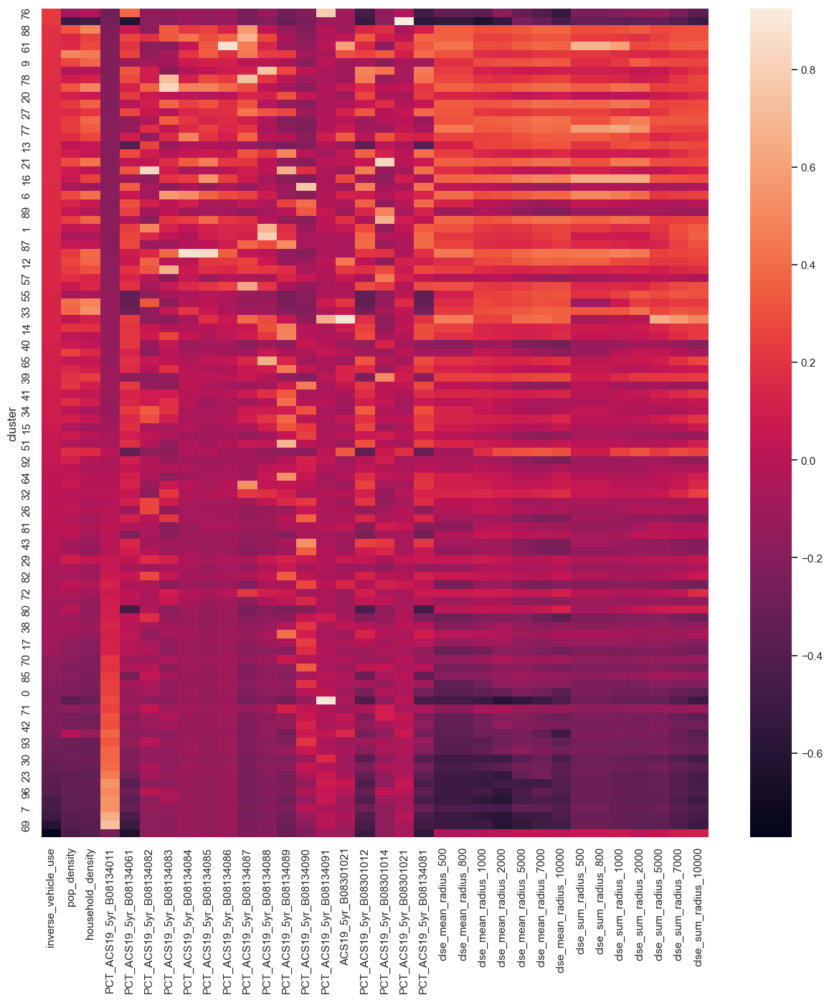

In [ ]:
import numpy as np
# Clean Data
# zip is not included beacuse that's an index, not a calculated value


# Plot the second choropleth map on the second subplot
nyc_gdf['inverse_vehicle_use'] = 100 - nyc_gdf['PCT_ACS19_5yr_B08301002']
# # nyc_gdf['log_inverse_vehicle_use'] = np.log(nyc_gdf['inverse_vehicle_use'])

nyc_gdf['pop_density'] = nyc_gdf['ACS19_5yr_B01001001'] / nyc_gdf['Geo_AREALAND']
nyc_gdf['household_density'] = nyc_gdf['ACS19_5yr_B11001001'] / nyc_gdf['Geo_AREALAND']

# 'inverse_vehicle_use','log_inverse_vehicle_use',
            
df = nyc_gdf[['inverse_vehicle_use','pop_density','household_density',
            'PCT_ACS19_5yr_B08134011',
            'PCT_ACS19_5yr_B08134061',
            'PCT_ACS19_5yr_B08134082',
            'PCT_ACS19_5yr_B08134083',
            'PCT_ACS19_5yr_B08134084',
            'PCT_ACS19_5yr_B08134085',
            'PCT_ACS19_5yr_B08134086',
            'PCT_ACS19_5yr_B08134087',
            'PCT_ACS19_5yr_B08134088',
            'PCT_ACS19_5yr_B08134089',
            'PCT_ACS19_5yr_B08134090',
            'PCT_ACS19_5yr_B08134091',
            'ACS19_5yr_B08301021',
            'PCT_ACS19_5yr_B08301012',
            'PCT_ACS19_5yr_B08301014',
            'PCT_ACS19_5yr_B08301021',
            'PCT_ACS19_5yr_B08134081',
            'clse_mean_radius_500',
            'clse_mean_radius_800',
            'clse_mean_radius_1000',
            'clse_mean_radius_2000',
            'clse_mean_radius_5000',
            'clse_mean_radius_7000',
            'clse_mean_radius_10000',
            'clse_sum_radius_500',
            'clse_sum_radius_800',
            'clse_sum_radius_1000',
            'clse_sum_radius_2000',
            'clse_sum_radius_5000',
            'clse_sum_radius_7000',
            'clse_sum_radius_10000',
            ]]

np.any(np.isnan(df))
np.all(np.isfinite(df))

# df=df.dropna()
df = df.fillna(0)


from sklearn.cluster import KMeans
import seaborn as sns; sns.set()  # for plot styling

number_of_cluters = 100
kmeans = KMeans(n_clusters=number_of_cluters, n_init=100) # default is 10

y_kmeans = kmeans.fit_predict(df)
df['cluster'] = kmeans.labels_

df = df.groupby('cluster').mean() #cluster means

df = df.sort_values(by=['inverse_vehicle_use'], ascending=False)
df

plt.figure(figsize=(15, 15))

df_norm = (df - df.mean()) / (df.max() - df.min())
sns.heatmap(df_norm)

<AxesSubplot: ylabel='cluster'>

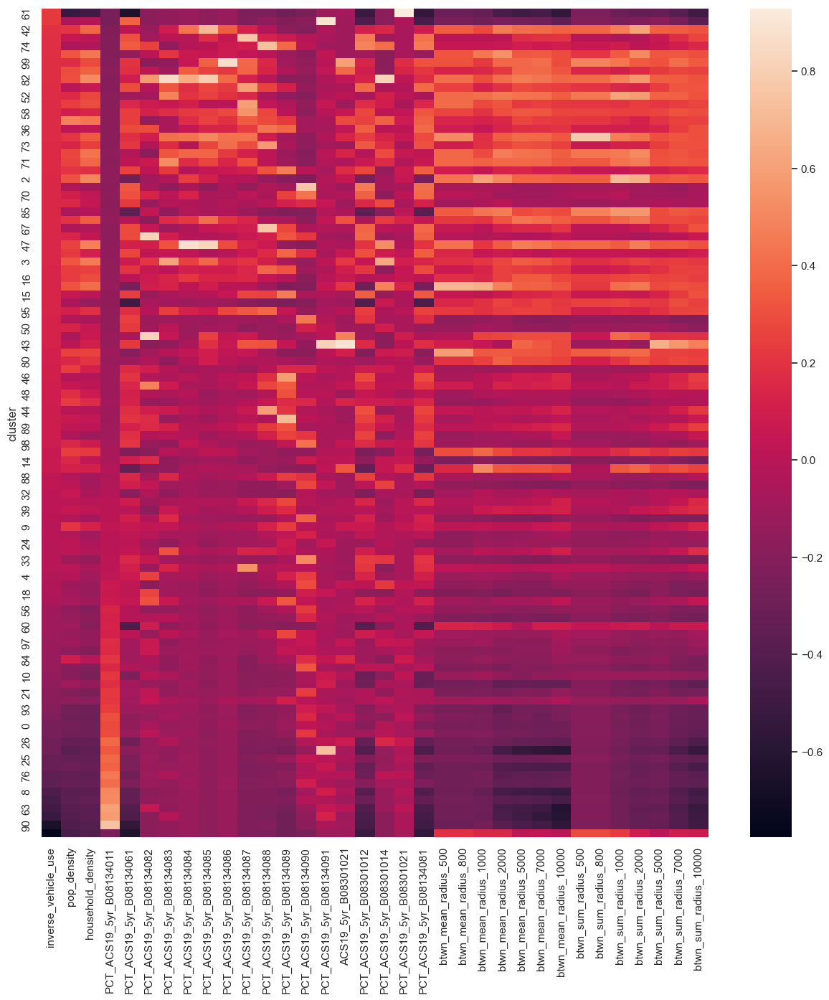

In [ ]:
import numpy as np
# Clean Data
# zip is not included beacuse that's an index, not a calculated value


# Plot the second choropleth map on the second subplot
nyc_gdf['inverse_vehicle_use'] = 100 - nyc_gdf['PCT_ACS19_5yr_B08301002']
# # nyc_gdf['log_inverse_vehicle_use'] = np.log(nyc_gdf['inverse_vehicle_use'])

nyc_gdf['pop_density'] = nyc_gdf['ACS19_5yr_B01001001'] / nyc_gdf['Geo_AREALAND']
nyc_gdf['household_density'] = nyc_gdf['ACS19_5yr_B11001001'] / nyc_gdf['Geo_AREALAND']

# 'inverse_vehicle_use','log_inverse_vehicle_use',
            
df = nyc_gdf[['inverse_vehicle_use','pop_density','household_density',
            'PCT_ACS19_5yr_B08134011',
            'PCT_ACS19_5yr_B08134061',
            'PCT_ACS19_5yr_B08134082',
            'PCT_ACS19_5yr_B08134083',
            'PCT_ACS19_5yr_B08134084',
            'PCT_ACS19_5yr_B08134085',
            'PCT_ACS19_5yr_B08134086',
            'PCT_ACS19_5yr_B08134087',
            'PCT_ACS19_5yr_B08134088',
            'PCT_ACS19_5yr_B08134089',
            'PCT_ACS19_5yr_B08134090',
            'PCT_ACS19_5yr_B08134091',
            'ACS19_5yr_B08301021',
            'PCT_ACS19_5yr_B08301012',
            'PCT_ACS19_5yr_B08301014',
            'PCT_ACS19_5yr_B08301021',
            'PCT_ACS19_5yr_B08134081',
            'btwn_mean_radius_500',
            'btwn_mean_radius_800',
            'btwn_mean_radius_1000',
            'btwn_mean_radius_2000',
            'btwn_mean_radius_5000',
            'btwn_mean_radius_7000',
            'btwn_mean_radius_10000',
            'btwn_sum_radius_500',
            'btwn_sum_radius_800',
            'btwn_sum_radius_1000',
            'btwn_sum_radius_2000',
            'btwn_sum_radius_5000',
            'btwn_sum_radius_7000',
            'btwn_sum_radius_10000',
            ]]

np.any(np.isnan(df))
np.all(np.isfinite(df))

# df=df.dropna()
df = df.fillna(0)


from sklearn.cluster import KMeans
import seaborn as sns; sns.set()  # for plot styling

number_of_cluters = 100
kmeans = KMeans(n_clusters=number_of_cluters, n_init=100) # default is 10

y_kmeans = kmeans.fit_predict(df)
df['cluster'] = kmeans.labels_

df = df.groupby('cluster').mean() #cluster means

df = df.sort_values(by=['inverse_vehicle_use'], ascending=False)
df

plt.figure(figsize=(15, 15))

df_norm = (df - df.mean()) / (df.max() - df.min())
sns.heatmap(df_norm)

<AxesSubplot: ylabel='cluster'>

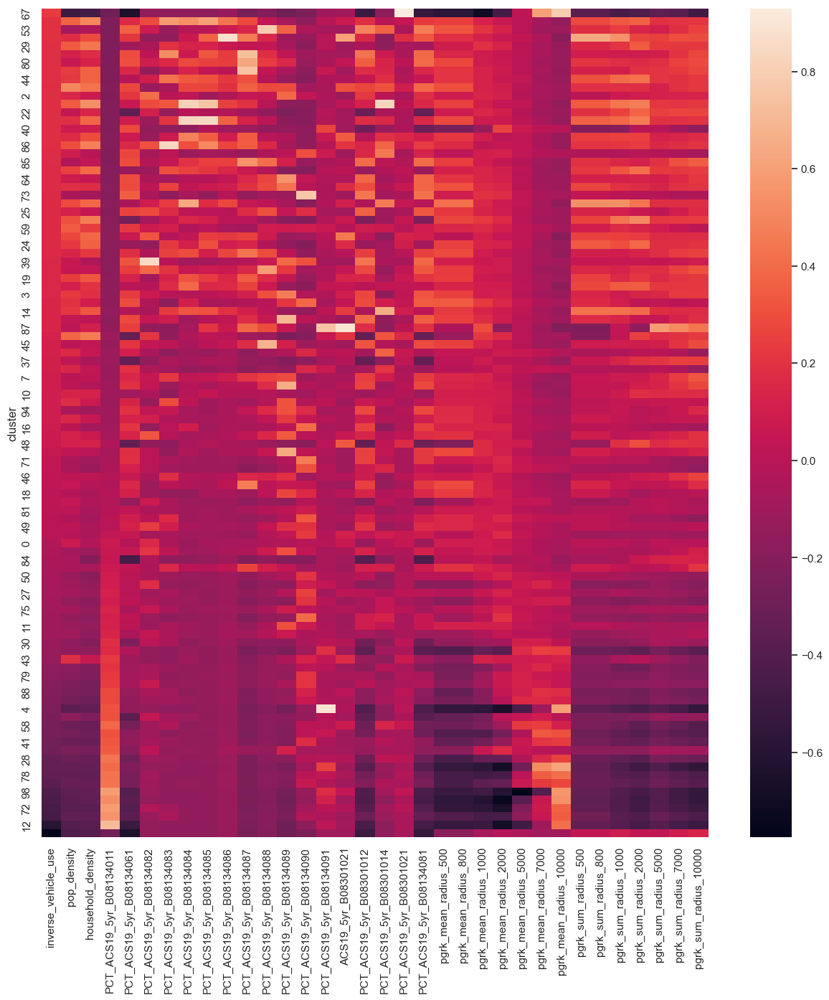

In [ ]:
import numpy as np
# Clean Data
# zip is not included beacuse that's an index, not a calculated value


# Plot the second choropleth map on the second subplot
nyc_gdf['inverse_vehicle_use'] = 100 - nyc_gdf['PCT_ACS19_5yr_B08301002']
# # nyc_gdf['log_inverse_vehicle_use'] = np.log(nyc_gdf['inverse_vehicle_use'])

nyc_gdf['pop_density'] = nyc_gdf['ACS19_5yr_B01001001'] / nyc_gdf['Geo_AREALAND']
nyc_gdf['household_density'] = nyc_gdf['ACS19_5yr_B11001001'] / nyc_gdf['Geo_AREALAND']

# 'inverse_vehicle_use','log_inverse_vehicle_use',
            
df = nyc_gdf[['inverse_vehicle_use','pop_density','household_density',
            'PCT_ACS19_5yr_B08134011',
            'PCT_ACS19_5yr_B08134061',
            'PCT_ACS19_5yr_B08134082',
            'PCT_ACS19_5yr_B08134083',
            'PCT_ACS19_5yr_B08134084',
            'PCT_ACS19_5yr_B08134085',
            'PCT_ACS19_5yr_B08134086',
            'PCT_ACS19_5yr_B08134087',
            'PCT_ACS19_5yr_B08134088',
            'PCT_ACS19_5yr_B08134089',
            'PCT_ACS19_5yr_B08134090',
            'PCT_ACS19_5yr_B08134091',
            'ACS19_5yr_B08301021',
            'PCT_ACS19_5yr_B08301012',
            'PCT_ACS19_5yr_B08301014',
            'PCT_ACS19_5yr_B08301021',
            'PCT_ACS19_5yr_B08134081',
            'pgrk_mean_radius_500',
            'pgrk_mean_radius_800',
            'pgrk_mean_radius_1000',
            'pgrk_mean_radius_2000',
            'pgrk_mean_radius_5000',
            'pgrk_mean_radius_7000',
            'pgrk_mean_radius_10000',
            'pgrk_sum_radius_500',
            'pgrk_sum_radius_800',
            'pgrk_sum_radius_1000',
            'pgrk_sum_radius_2000',
            'pgrk_sum_radius_5000',
            'pgrk_sum_radius_7000',
            'pgrk_sum_radius_10000',
            ]]

np.any(np.isnan(df))
np.all(np.isfinite(df))

# df=df.dropna()
df = df.fillna(0)


from sklearn.cluster import KMeans
import seaborn as sns; sns.set()  # for plot styling

number_of_cluters = 100
kmeans = KMeans(n_clusters=number_of_cluters, n_init=100) # default is 10

y_kmeans = kmeans.fit_predict(df)
df['cluster'] = kmeans.labels_

df = df.groupby('cluster').mean() #cluster means

df = df.sort_values(by=['inverse_vehicle_use'], ascending=False)
df

plt.figure(figsize=(15, 15))

df_norm = (df - df.mean()) / (df.max() - df.min())
sns.heatmap(df_norm)

# Testing

In [ ]:
import numpy as np
# Clean Data
# zip is not included beacuse that's an index, not a calculated value


# Plot the second choropleth map on the second subplot
nyc_gdf['inverse_vehicle_use'] = 100 - nyc_gdf['PCT_ACS19_5yr_B08301002']
# nyc_gdf['log_inverse_vehicle_use'] = np.log(nyc_gdf['inverse_vehicle_use'])

nyc_gdf['pop_density'] = nyc_gdf['ACS19_5yr_B01001001'] / nyc_gdf['Geo_AREALAND']
nyc_gdf['household_density'] = nyc_gdf['ACS19_5yr_B11001001'] / nyc_gdf['Geo_AREALAND']

# 'inverse_vehicle_use','log_inverse_vehicle_use',

df = nyc_gdf[['inverse_vehicle_use','pop_density','household_density',
            'PCT_ACS19_5yr_B08134011',
            'PCT_ACS19_5yr_B08134061',
            'PCT_ACS19_5yr_B08134082',
            'PCT_ACS19_5yr_B08134083',
            'PCT_ACS19_5yr_B08134084',
            'PCT_ACS19_5yr_B08134085',
            'PCT_ACS19_5yr_B08134086',
            'PCT_ACS19_5yr_B08134087',
            'PCT_ACS19_5yr_B08134088',
            'PCT_ACS19_5yr_B08134089',
            'PCT_ACS19_5yr_B08134090',
            'PCT_ACS19_5yr_B08134091',
            'ACS19_5yr_B08301021',
            'PCT_ACS19_5yr_B08301012',
            'PCT_ACS19_5yr_B08301014',
            'PCT_ACS19_5yr_B08301021',
            'PCT_ACS19_5yr_B08134081',
            # 'clse_mean_radius_500',
            # 'btwn_mean_radius_500',
            # 'pgrk_mean_radius_500',
            'clse_mean_radius_800',
            # 'btwn_mean_radius_800',
            'pgrk_mean_radius_800',
            # 'clse_mean_radius_1000',
            # 'btwn_mean_radius_1000',
            # 'pgrk_mean_radius_1000',
            # 'clse_mean_radius_2000',
            ]]

np.any(np.isnan(df))
np.all(np.isfinite(df))

# df=df.dropna()
df = df.fillna(0)

from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler()
scaled_df = pd.DataFrame(scaler.fit_transform(df), columns=df.columns)
scaled_df['clse_pgrk_mean_radius_800'] = scaled_df['clse_mean_radius_800'] + scaled_df['pgrk_mean_radius_800']

from sklearn.cluster import KMeans
import seaborn as sns; sns.set()  # for plot styling

number_of_cluters = 100
kmeans = KMeans(n_clusters=number_of_cluters, n_init=100) # default is 10

y_kmeans = kmeans.fit_predict(df)
scaled_df['cluster'] = kmeans.labels_

scaled_df = scaled_df.groupby('cluster').mean() #cluster means

scaled_df = scaled_df.sort_values(by=['inverse_vehicle_use'], ascending=False)
scaled_df

plt.figure(figsize=(15, 8))

df_norm = (scaled_df - scaled_df.mean()) / (scaled_df.max() - scaled_df.min())
sns.heatmap(df_norm)

KeyboardInterrupt: 

In [ ]:
df_norm

,inverse_vehicle_use,pop_density,household_density,PCT_ACS19_5yr_B08134011,PCT_ACS19_5yr_B08134061,PCT_ACS19_5yr_B08134082,PCT_ACS19_5yr_B08134083,PCT_ACS19_5yr_B08134084,PCT_ACS19_5yr_B08134085,PCT_ACS19_5yr_B08134086,...,clse_mean_radius_500,btwn_mean_radius_500,pgrk_mean_radius_500,clse_mean_radius_800,btwn_mean_radius_800,pgrk_mean_radius_800,clse_mean_radius_1000,btwn_mean_radius_1000,pgrk_mean_radius_1000,clse_mean_radius_2000
cluster,,,,,,,,,,,,,,,,,,,,,
57,0.225305,-0.103180,-0.059832,-0.272927,0.336818,-0.136538,-0.181345,-0.152215,-0.189687,-0.121139,...,-0.372916,-0.263263,-0.299313,-0.372916,-0.263263,-0.299313,-0.332032,-0.262765,-0.246473,-0.174730
83,0.225305,-0.522957,-0.478927,-0.272927,-0.653189,-0.136538,-0.181345,-0.152215,-0.189687,-0.121139,...,-0.539490,-0.309428,-0.597067,-0.539490,-0.309428,-0.597067,-0.649096,-0.305309,-0.714836,-0.552795
67,0.193825,0.004496,-0.022854,-0.234857,0.333190,-0.053654,0.058075,-0.029857,0.017211,0.038342,...,0.264061,0.014764,0.149781,0.264061,0.014764,0.149781,0.175712,0.031315,0.127348,0.140963
38,0.191455,0.261755,0.456440,-0.232048,0.065993,-0.136538,0.118297,0.435180,0.515355,0.149793,...,0.394479,0.510104,0.229799,0.394479,0.510104,0.229799,0.322721,0.307297,0.090212,0.325501
42,0.188355,-0.019839,0.021591,-0.225804,0.329478,-0.108171,0.394905,0.049499,0.148913,0.226351,...,0.268636,0.221774,0.231173,0.268636,0.221774,0.231173,0.201348,0.099787,0.120285,0.190980
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15,-0.431643,-0.374512,-0.349384,0.607714,-0.404914,0.114783,-0.181345,-0.152215,-0.184796,-0.118395,...,-0.515473,-0.283769,-0.569609,-0.515473,-0.283769,-0.569609,-0.566435,-0.252890,-0.538945,-0.639829
29,-0.469695,-0.393353,-0.379230,0.613424,-0.421176,-0.136538,-0.181345,-0.152215,-0.189687,-0.121139,...,-0.513637,-0.299077,-0.556550,-0.513637,-0.299077,-0.556550,-0.584682,-0.294889,-0.598870,-0.632786
7,-0.475265,-0.361756,-0.349316,0.574188,-0.376564,-0.116475,-0.082278,-0.145674,-0.186228,-0.118634,...,-0.464378,-0.276762,-0.450497,-0.464378,-0.276762,-0.450497,-0.503844,-0.268903,-0.487926,-0.521253


In [ ]:
import numpy as np
# Clean Data
# zip is not included beacuse that's an index, not a calculated value


# Plot the second choropleth map on the second subplot
nyc_gdf['inverse_vehicle_use'] = 100 - nyc_gdf['PCT_ACS19_5yr_B08301002']
# # nyc_gdf['log_inverse_vehicle_use'] = np.log(nyc_gdf['inverse_vehicle_use'])

nyc_gdf['pop_density'] = nyc_gdf['ACS19_5yr_B01001001'] / nyc_gdf['Geo_AREALAND']
nyc_gdf['household_density'] = nyc_gdf['ACS19_5yr_B11001001'] / nyc_gdf['Geo_AREALAND']

# 'inverse_vehicle_use','log_inverse_vehicle_use',

df = nyc_gdf[['inverse_vehicle_use','pop_density','household_density',
            'PCT_ACS19_5yr_B08134011',
            'PCT_ACS19_5yr_B08134061',
            'PCT_ACS19_5yr_B08134082',
            'PCT_ACS19_5yr_B08134083',
            'PCT_ACS19_5yr_B08134084',
            'PCT_ACS19_5yr_B08134085',
            'PCT_ACS19_5yr_B08134086',
            'PCT_ACS19_5yr_B08134087',
            'PCT_ACS19_5yr_B08134088',
            'PCT_ACS19_5yr_B08134089',
            'PCT_ACS19_5yr_B08134090',
            'PCT_ACS19_5yr_B08134091',
            'ACS19_5yr_B08301021',
            'PCT_ACS19_5yr_B08301012',
            'PCT_ACS19_5yr_B08301014',
            'PCT_ACS19_5yr_B08301021',
            'PCT_ACS19_5yr_B08134081',
            'clse_mean_radius_500',
            'btwn_mean_radius_500',
            'pgrk_mean_radius_500',
            'clse_mean_radius_800',
            'btwn_mean_radius_800',
            'pgrk_mean_radius_800',
            'clse_mean_radius_1000',
            'btwn_mean_radius_1000',
            'pgrk_mean_radius_1000',
            'clse_mean_radius_2000',
            ]]

np.any(np.isnan(df))
np.all(np.isfinite(df))

# df=df.dropna()
df = df.fillna(0)


from sklearn.cluster import KMeans
import seaborn as sns; sns.set()  # for plot styling

number_of_cluters = 100
kmeans = KMeans(n_clusters=number_of_cluters, n_init=100) # default is 10

y_kmeans = kmeans.fit_predict(df)
df['cluster'] = kmeans.labels_

df = df.groupby('cluster').mean() #cluster means

df = df.sort_values(by=['inverse_vehicle_use'], ascending=False)
df

plt.figure(figsize=(15, 8))

df_norm = (df - df.mean()) / (df.max() - df.min())
sns.heatmap(df_norm)

In [ ]:
import numpy as np
# Clean Data
# zip is not included beacuse that's an index, not a calculated value


# Plot the second choropleth map on the second subplot
nyc_gdf['inverse_vehicle_use'] = 100 - nyc_gdf['PCT_ACS19_5yr_B08301002']
# # nyc_gdf['log_inverse_vehicle_use'] = np.log(nyc_gdf['inverse_vehicle_use'])

nyc_gdf['pop_density'] = nyc_gdf['ACS19_5yr_B01001001'] / nyc_gdf['Geo_AREALAND']
nyc_gdf['household_density'] = nyc_gdf['ACS19_5yr_B11001001'] / nyc_gdf['Geo_AREALAND']

# 'inverse_vehicle_use','log_inverse_vehicle_use',
            
df = nyc_gdf[['inverse_vehicle_use','pop_density','household_density',
            'PCT_ACS19_5yr_B08134011',
            'PCT_ACS19_5yr_B08134061',
            'PCT_ACS19_5yr_B08134082',
            'PCT_ACS19_5yr_B08134083',
            'PCT_ACS19_5yr_B08134084',
            'PCT_ACS19_5yr_B08134085',
            'PCT_ACS19_5yr_B08134086',
            'PCT_ACS19_5yr_B08134087',
            'PCT_ACS19_5yr_B08134088',
            'PCT_ACS19_5yr_B08134089',
            'PCT_ACS19_5yr_B08134090',
            'PCT_ACS19_5yr_B08134091',
            'ACS19_5yr_B08301021',
            'PCT_ACS19_5yr_B08301012',
            'PCT_ACS19_5yr_B08301014',
            'PCT_ACS19_5yr_B08301021',
            'PCT_ACS19_5yr_B08134081',
            'clse_mean_radius_500',
            'clse_mean_radius_800',
            'clse_mean_radius_1000',
            'clse_mean_radius_2000',
            'clse_mean_radius_5000',
            'clse_mean_radius_7000',
            'clse_mean_radius_10000',
            'btwn_mean_radius_500',
            'btwn_mean_radius_800',
            'btwn_mean_radius_1000',
            'btwn_mean_radius_2000',
            'btwn_mean_radius_5000',
            'btwn_mean_radius_7000',
            'btwn_mean_radius_10000',
            'pgrk_mean_radius_500',
            'pgrk_mean_radius_800',
            'pgrk_mean_radius_1000',
            'pgrk_mean_radius_2000',
            'pgrk_mean_radius_5000',
            'pgrk_mean_radius_7000',
            'pgrk_mean_radius_10000',
            'clse_sum_radius_500',
            'clse_sum_radius_800',
            'clse_sum_radius_1000',
            'clse_sum_radius_2000',
            'clse_sum_radius_5000',
            'clse_sum_radius_7000',
            'clse_sum_radius_10000',
            'btwn_sum_radius_500',
            'btwn_sum_radius_800',
            'btwn_sum_radius_1000',
            'btwn_sum_radius_2000',
            'btwn_sum_radius_5000',
            'btwn_sum_radius_7000',
            'btwn_sum_radius_10000',
            'pgrk_sum_radius_500',
            'pgrk_sum_radius_800',
            'pgrk_sum_radius_1000',
            'pgrk_sum_radius_2000',
            'pgrk_sum_radius_5000',
            'pgrk_sum_radius_7000',
            'pgrk_sum_radius_10000',
            ]]

np.any(np.isnan(df))
np.all(np.isfinite(df))

# df=df.dropna()
df = df.fillna(0)


from sklearn.cluster import KMeans
import seaborn as sns; sns.set()  # for plot styling

number_of_cluters = 100
kmeans = KMeans(n_clusters=number_of_cluters, n_init=100) # default is 10

y_kmeans = kmeans.fit_predict(df)
df['cluster'] = kmeans.labels_

df = df.groupby('cluster').mean() #cluster means

df = df.sort_values(by=['inverse_vehicle_use'], ascending=False)
df

plt.figure(figsize=(15, 8))

df_norm = (df - df.mean()) / (df.max() - df.min())
sns.heatmap(df_norm)

In [ ]:
import statsmodels.api as sm

# Define dependent and independent variables
y = df['inverse_vehicle_use']
X = df.drop(['inverse_vehicle_use'], axis=1)

# Add constant to independent variables
X = sm.add_constant(X)

# Fit OLS model
model = sm.OLS(y, X).fit()

# Print summary of regression results
print(model.summary())


                             OLS Regression Results                            
Dep. Variable:     inverse_vehicle_use   R-squared:                       0.964
Model:                             OLS   Adj. R-squared:                  0.964
Method:                  Least Squares   F-statistic:                     7496.
Date:                 Thu, 13 Apr 2023   Prob (F-statistic):               0.00
Time:                         16:28:45   Log-Likelihood:                -16256.
No. Observations:                 5908   AIC:                         3.256e+04
Df Residuals:                     5886   BIC:                         3.270e+04
Df Model:                           21                                         
Covariance Type:             nonrobust                                         
                              coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------
const           

# End